<a href="https://colab.research.google.com/github/Degles/challenger_alura_store_BR/blob/main/AluraStoreBrFinal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Importação dos dados



In [37]:
import pandas as pd
import requests
import os
import time
import io

IMAGE_DIR = '../imagens'

if not os.path.exists(IMAGE_DIR):
    os.makedirs(IMAGE_DIR, exist_ok=True)
    print(f"Pasta '{IMAGE_DIR}' criada com sucesso.")
else:
    print(f"A pasta '{IMAGE_DIR}' já existe. Prosseguindo com a geração do gráfico.")

print("\nConfigurações de salvamento de imagens prontas.")
# --- FIM DO BLOCO DE CONFIGURAÇÃO DE IMAGENS NO INÍCIO ---


# --- URLs dos dados remotos (ATENÇÃO: Este é um DICIONÁRIO, a sintaxe está correta para ele!) ---
urls = {
    "loja1": "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "loja2": "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "loja3": "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv", # Corrigi para loja_3.csv aqui
    "loja4": "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
}

# --- Caminho para os dados locais ---

LOCAL_DATA_PREFIX = 'data/raw/'

# ----------------------------------------------------------------------------------------------------
# FUNÇÃO PARA CARREGAR DADOS COM FALLBACK (Esta função está correta)
# ----------------------------------------------------------------------------------------------------
def carregar_dados_loja(loja_nome, url, local_path_prefix):
    df = pd.DataFrame() # DataFrame vazio para retornar em caso de falha
    local_file_name = f"{loja_nome}.csv" # Ex: "loja_1.csv"
    local_file_path = os.path.join(local_path_prefix, local_file_name)

    # --- TENTATIVA 1: LER DA URL REMOTA (usando requests.get e depois pd.read_csv) ---
    try:
        print(f"[{loja_nome}] Tentando carregar da URL: {url}")
        # **NOVA LINHA:** Faz a requisição HTTP com requests (aqui o 'timeout' funciona)
        response = requests.get(url, timeout=10)
        response.raise_for_status() # Levanta erro para 4xx/5xx

        # **NOVA LINHA:** Lê o conteúdo da resposta como um string buffer para o pandas
        df = pd.read_csv(io.StringIO(response.text), encoding='utf-8')
        print(f"[{loja_nome}] Sucesso ao carregar da URL.")
        return df
    except requests.exceptions.HTTPError as e:
        print(f"[{loja_nome}] Erro HTTP ao carregar da URL ({e.response.status_code}). Tentando arquivo local...")
    except requests.exceptions.ConnectionError as e:
        print(f"[{loja_nome}] Erro de conexão ao carregar da URL: {e}. Tentando arquivo local...")
    except requests.exceptions.Timeout as e:
        print(f"[{loja_nome}] Timeout ao carregar da URL: {e}. Tentando arquivo local...")
    except pd.errors.EmptyDataError:
        print(f"[{loja_nome}] A URL retornou dados vazios. Tentando arquivo local...")
    except Exception as e:
        print(f"[{loja_nome}] Erro inesperado ao carregar da URL: {e}. Tentando arquivo local...")

    # --- TENTATIVA 2: LER DO ARQUIVO LOCAL (FALLBACK) ---
    if os.path.exists(local_file_path):
        try:
            print(f"[{loja_nome}] Tentando carregar dados do arquivo local: {local_file_path}")
            df = pd.read_csv(local_file_path, encoding='utf-8')
            print(f"[{loja_nome}] Sucesso ao carregar do arquivo local.")
            return df
        except pd.errors.EmptyDataError:
            print(f"[{loja_nome}] O arquivo local está vazio: {local_file_path}.")
        except Exception as e:
            print(f"[{loja_nome}] ERRO FATAL: Não foi possível carregar do arquivo local '{local_file_path}': {e}")
    else:
        print(f"[{loja_nome}] ERRO FATAL: Arquivo local '{local_file_path}' NÃO FOI ENCONTRADO para fallback.")

    print(f"[{loja_nome}] Falha total: Não foi possível carregar os dados de nenhuma fonte.")
    return pd.DataFrame() # Retorna um DataFrame vazio em caso de falha total

# ----------------------------------------------------------------------------------------------------
# APLICANDO A FUNÇÃO PARA CADA LOJA (NÃO HÁ ASPAS NOS NOMES DAS VARIÁVEIS AQUI!)
# ----------------------------------------------------------------------------------------------------

print("Iniciando carregamento dos dados das lojas...")

# ATENÇÃO: Os nomes das variáveis à esquerda (loja1, loja2, etc.) NÃO TÊM ASPAS.
# Isso está CORRETO e é a maneira de atribuir o DataFrame a uma variável.
loja1 = carregar_dados_loja("loja_1", urls["loja1"], LOCAL_DATA_PREFIX)
loja2 = carregar_dados_loja("loja_2", urls["loja2"], LOCAL_DATA_PREFIX)
loja3 = carregar_dados_loja("loja_3", urls["loja3"], LOCAL_DATA_PREFIX)
loja4 = carregar_dados_loja("loja_4", urls["loja4"], LOCAL_DATA_PREFIX)

print("\nCarregamento de dados concluído.")

# Exemplo de verificação (o seu loja.head() original)
print("\nPrimeiras 5 linhas da Loja 1 (se carregada):")
print(loja1.head())
print("\nShape da Loja 1:", loja1.shape)

import pandas as pd # Importe pandas, se ainda não estiver na célula

# --- Definição de estilo para dataframes ---

def aplicar_estilo_tabela(df):
    """
    Aplica um estilo de tabela consistente a um DataFrame.
    """
    return (
        df.head()
        .style
        .set_properties(**{'text-align': 'left', 'font-size': '10pt', 'font-family': 'Arial'})
        .set_table_styles([
            # Estilo para os cabeçalhos
            {'selector': 'th', 'props': [('background-color', '#E6F3F9'),
                                         ('color', '#333333'), # Cor da fonte dos cabeçalhos
                                         ('font-weight', 'bold'),
                                         ('text-align', 'center'),
                                         ('border', '1px solid #ddd')]},
            # Estilo para as células de dados
            {'selector': 'td', 'props': [('border', '1px solid #ddd'),
                                         ('color', '#333333')]}, # Cor da fonte das células
            # Efeito zebrado para as linhas
            {'selector': 'tr:nth-child(even)', 'props': [('background-color', '#f2f2f2')]},
            {'selector': 'tr:nth-child(odd)', 'props': [('background-color', '#ffffff')]}
        ])
        .hide(axis='index')
    )

# --- Chamadas para exibir os DataFrames de cada loja ---
print("Exibindo as primeiras linhas do DataFrame Loja 1 com estilo:")
display(aplicar_estilo_tabela(loja1))

print("Exibindo as primeiras linhas do DataFrame Loja 2 com estilo:")
display(aplicar_estilo_tabela(loja2))

print("Exibindo as primeiras linhas do DataFrame Loja 3 com estilo:")
display(aplicar_estilo_tabela(loja3))

print("Exibindo as primeiras linhas do DataFrame Loja 4 com estilo:")
display(aplicar_estilo_tabela(loja4))

A pasta '../imagens' já existe. Prosseguindo com a geração do gráfico.

Configurações de salvamento de imagens prontas.
Iniciando carregamento dos dados das lojas...
[loja_1] Tentando carregar da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv
[loja_1] Sucesso ao carregar da URL.
[loja_2] Tentando carregar da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv
[loja_2] Sucesso ao carregar da URL.
[loja_3] Tentando carregar da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv
[loja_3] Sucesso ao carregar da URL.
[loja_4] Tentando carregar da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv
[loja_4] Sucesso ao carregar da URL.

Carregamento de dados concluído.

Pri

Produto,Categoria do Produto,Preço,Frete,Data da Compra,Vendedor,Local da compra,Avaliação da compra,Tipo de pagamento,Quantidade de parcelas,lat,lon
Assistente virtual,eletronicos,219.080000,9.249790,16/01/2021,Pedro Gomes,SP,4,cartao_credito,8,-22.190000,-48.790000
Mesa de jantar,moveis,256.350000,11.234305,18/05/2022,Beatriz Moraes,RJ,1,cartao_credito,4,-22.250000,-42.660000
Jogo de tabuleiro,brinquedos,279.510000,21.262681,15/03/2021,João Souza,DF,1,cartao_credito,1,-15.830000,-47.860000
Micro-ondas,eletrodomesticos,1009.990000,54.667344,03/05/2022,João Souza,RS,4,boleto,1,-30.170000,-53.500000
Cadeira de escritório,moveis,446.990000,26.964689,07/11/2020,Larissa Alves,MG,5,boleto,1,-18.100000,-44.380000


Exibindo as primeiras linhas do DataFrame Loja 2 com estilo:


Produto,Categoria do Produto,Preço,Frete,Data da Compra,Vendedor,Local da compra,Avaliação da compra,Tipo de pagamento,Quantidade de parcelas,lat,lon
Cadeira de escritório,moveis,378.200000,20.421138,04/08/2021,Thiago Silva,MG,1,boleto,1,-18.100000,-44.380000
Pandeiro,instrumentos musicais,102.370000,3.035334,26/11/2020,Bianca Santos,RJ,3,cartao_credito,4,-22.250000,-42.660000
Cama king,moveis,591.130000,31.759020,22/10/2021,Thiago Silva,SC,5,cartao_credito,10,-27.450000,-50.950000
Cama king,moveis,1208.240000,61.919584,04/05/2022,Larissa Alves,RS,5,cartao_credito,10,-30.170000,-53.500000
Cadeira de escritório,moveis,530.410000,25.827176,26/02/2022,Lucas Oliveira,SP,4,cartao_credito,3,-22.190000,-48.790000


Exibindo as primeiras linhas do DataFrame Loja 3 com estilo:


Produto,Categoria do Produto,Preço,Frete,Data da Compra,Vendedor,Local da compra,Avaliação da compra,Tipo de pagamento,Quantidade de parcelas,lat,lon
Secadora de roupas,eletrodomesticos,1713.500000,88.823159,17/12/2021,Camila Ribeiro,CE,4,cartao_credito,4,-5.200000,-39.530000
Cômoda,moveis,386.810000,18.180908,10/02/2021,Larissa Alves,RS,3,cartao_credito,1,-30.170000,-53.500000
Violão,instrumentos musicais,404.620000,23.197592,22/01/2023,Lucas Oliveira,SP,5,cartao_credito,3,-22.190000,-48.790000
Bola de vôlei,esporte e lazer,78.400000,4.463341,22/03/2022,Pedro Gomes,BA,4,cartao_credito,6,-13.290000,-41.710000
Guarda roupas,moveis,694.760000,34.578319,12/01/2022,Bianca Santos,SP,1,cartao_credito,1,-22.190000,-48.790000


Exibindo as primeiras linhas do DataFrame Loja 4 com estilo:


Produto,Categoria do Produto,Preço,Frete,Data da Compra,Vendedor,Local da compra,Avaliação da compra,Tipo de pagamento,Quantidade de parcelas,lat,lon
Lava louças,eletrodomesticos,1446.460000,74.604083,11/11/2022,Rafael Costa,SP,4,cartao_credito,3,-22.190000,-48.790000
Cama box,moveis,631.700000,33.919251,03/01/2020,Thiago Silva,GO,5,cartao_credito,2,-15.980000,-49.860000
Bola de basquete,esporte e lazer,31.540000,0.000000,25/12/2022,Larissa Alves,MG,5,boleto,1,-18.100000,-44.380000
Modelagem preditiva,livros,76.930000,1.680730,23/11/2021,Lucas Oliveira,MG,3,boleto,1,-18.100000,-44.380000
Fone de ouvido,eletronicos,185.140000,7.442587,25/04/2022,Bianca Santos,SP,4,cartao_credito,7,-22.190000,-48.790000


#1. Análise do faturamento


##1.1. Faturamento Global: **Valor total de vendas de todas as lojas**


A pasta '../imagens' já existe. Prosseguindo com a geração do gráfico.

Configurações de salvamento de imagens prontas.
Calculando faturamento para visualização...
---Processando Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Tentando ler dados da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv
Sucesso: Dados lidos da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv
Vendas por categoria na Loja 1:
Venda da categoria eletronicos: R$ 572.659,23
Venda da categoria moveis: R$ 250.178,11
Venda da categoria brinquedos: R$ 23.993,78
Venda da categoria eletrodomesticos: R$ 484.913,36
Venda da categoria utilidades domesticas: R$ 16.931,48
Venda da categoria esporte e lazer: R$ 52.387,55
Venda da categoria livros: R$ 11.713,92
Venda da 

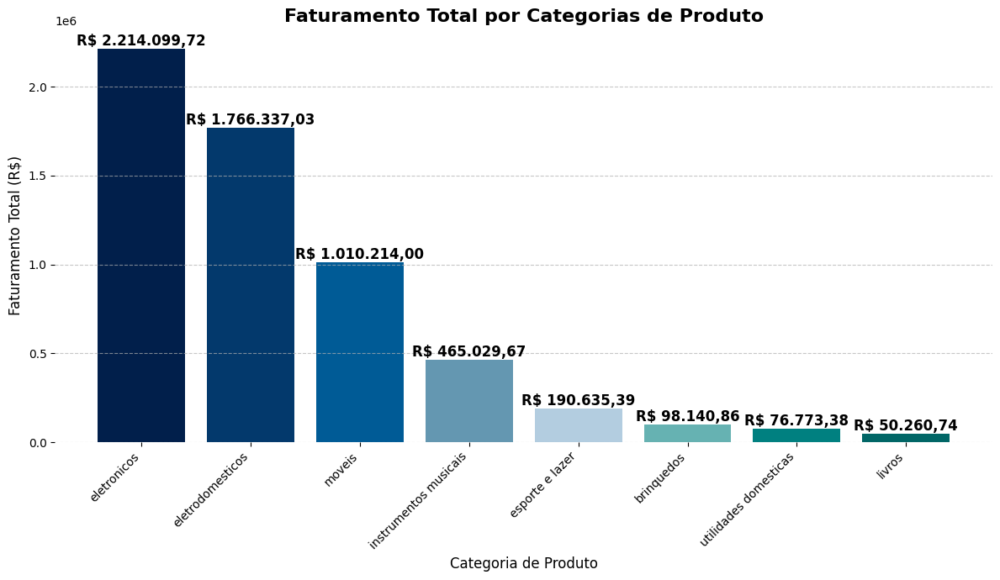

---Vendas totais por categorias (todas as lojas):
Venda Total da Categoria eletronicos: R$ 2.214.099,72
Venda Total da Categoria moveis: R$ 1.010.214,00
Venda Total da Categoria brinquedos: R$ 98.140,86
Venda Total da Categoria eletrodomesticos: R$ 1.766.337,03
Venda Total da Categoria utilidades domesticas: R$ 76.773,38
Venda Total da Categoria esporte e lazer: R$ 190.635,39
Venda Total da Categoria livros: R$ 50.260,74
Venda Total da Categoria instrumentos musicais: R$ 465.029,67
Total geral de vendas (soma das categorias): R$ 5.871.490,79
Faturamento total de todas as lojas:R$ 5.871.490,79
Resumo de Faturamento por Loja:
Loja 1 R$ 1.534.509,12
Loja 2 R$ 1.488.459,06
Loja 3 R$ 1.464.025,03
Loja 4 R$ 1.384.497,58
------------------------------
Total Global: R$ 5.871.490,79


In [38]:
import locale # Mantenha este import, mas não usaremos locale.currency() diretamente
import csv
import requests
import matplotlib.pyplot as plt
import pandas as pd
import folium
import os
import io # Importação necessária para ler strings como arquivos CSV


# Configurando o diretório de imagens
# Caminho para a pasta 'imagens' que está na raiz do projeto (se o notebook está em 'notebooks/')
IMAGE_DIR = '../imagens'

if not os.path.exists(IMAGE_DIR):
    os.makedirs(IMAGE_DIR, exist_ok=True)
    print(f"Pasta '{IMAGE_DIR}' criada com sucesso.")
else:
    print(f"A pasta '{IMAGE_DIR}' já existe. Prosseguindo com a geração do gráfico.")

print("\nConfigurações de salvamento de imagens prontas.")

# --- Função de Formatação de Moeda Personalizada (Esta é a que queremos usar!) ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    # f-string com :.2f para 2 casas decimais, depois substitui separadores
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")
# --------------------------------------------------------------------------------------


# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# **************************************************************************************
# ÚNICA E CORRETA FUNÇÃO LER_CSV (Com lógica de fallback)
# **************************************************************************************
def ler_csv(url, local_path_prefix='../data/raw/'): # Caminho para a pasta 'data/raw/' a partir da raiz do projeto
    dados = []
    file_name = url.split('/')[-1]
    local_file_path = os.path.join(local_path_prefix, file_name)

    # --- TENTATIVA 1: LER DA URL ---
    try:
        print(f"Tentando ler dados da URL: {url}")
        response = requests.get(url, timeout=10)
        response.raise_for_status()

        leitor = csv.DictReader(io.StringIO(response.text))
        for linha in leitor:
            dados.append(linha)
        print(f"Sucesso: Dados lidos da URL: {url}")
        return dados

    except requests.exceptions.RequestException as e:
        print(f"ATENÇÃO: Erro ao ler da URL '{url}': {e}. Tentando arquivo local...")
    except Exception as e:
        print(f"ATENÇÃO: Erro inesperado ao ler da URL '{url}': {e}. Tentando arquivo local...")

    # --- TENTATIVA 2: LER DO ARQUIVO LOCAL (FALLBACK) ---
    if os.path.exists(local_file_path):
        try:
            print(f"Tentando ler dados do arquivo local: {local_file_path}")
            with open(local_file_path, 'r', encoding='utf-8') as f:
                leitor = csv.DictReader(f)
                for linha in leitor:
                    dados.append(linha)
            print(f"Sucesso: Dados lidos do arquivo local: {local_file_path}")
            return dados
        except Exception as e:
            print(f"ERRO: Não foi possível ler do arquivo local '{local_file_path}': {e}")
    else:
        print(f"ERRO: Arquivo local '{local_file_path}' não encontrado para fallback.")

    print(f"Falha total: Não foi possível obter dados para '{file_name}' de nenhuma fonte.")
    return []

# **************************************************************************************
# FIM DA FUNÇÃO LER_CSV
# **************************************************************************************

# Variáveis para coleta de dados das categorias (total geral)
vendas_por_categoria = {}
faturamentos_por_loja = {} # Dicionário para coletar o faturamento de cada loja para o resumo
cores_barras = ['#011f4b', '#03396c', '#005b96', '#6497b1', '#b3cde0', '#66b2b2', '#008080', '#006666']

print("Calculando faturamento para visualização...")

# Processar todas as lojas para preencher vendas_por_categorias e faturamentos_por_loja
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"---Processando {nome_loja} (URL: {url})...")

    categorias_loja = {} # Para imprimir o resumo por categoria DA LOJA ATUAL
    faturamento_loja_atual = 0 # Para acumular o faturamento da loja atual

    dados_loja = ler_csv(url) # Chama a única função ler_csv existente

    if not dados_loja:
        print(f"Nenhum dado encontrado para a {nome_loja}. Pulando esta loja.")
        faturamentos_por_loja[nome_loja] = 0 # Adiciona 0 se não houver dados
        print("---")
        continue

    for venda in dados_loja:
        try:
            categoria = venda['Categoria do Produto']
            preco = float(venda['Preço'])
            valor_venda = preco
            faturamento_loja_atual += valor_venda # Acumula o faturamento da loja atual

            categorias_loja[categoria] = categorias_loja.get(categoria, 0) + valor_venda
            vendas_por_categoria[categoria] = vendas_por_categoria.get(categoria, 0) + valor_venda

        except KeyError as e:
            print(f"AVISO ({nome_loja}): Coluna não encontrada ({e}). Venda: {venda}. Ignorando esta venda.")
        except ValueError as e:
            print(f"AVISO ({nome_loja}): Valor inválido em 'Preço' ({e}). Venda: {venda}. Ignorando esta venda.")

    # Armazena o faturamento total da loja no dicionário faturamentos_por_loja
    faturamentos_por_loja[nome_loja] = faturamento_loja_atual

    # Imprime vendas por categoria para a loja atual (opcional, mas bom para debug)
    if categorias_loja: # Se a loja teve vendas válidas
        print(f"Vendas por categoria na {nome_loja}:")
        for categoria, total_venda in categorias_loja.items():
            print(f"Venda da categoria {categoria}: {formatar_moeda_br(total_venda)}")

    print("---")

categorias_para_grafico = list(vendas_por_categoria.keys())
valores_categorias_para_grafico = list(vendas_por_categoria.values())

print("\nDados para o gráfico de categorias coletados.")

# ORDENAÇÃO DOS DADOS --------
dados_ordenaveis = sorted(vendas_por_categoria.items(), key=lambda item: item[1], reverse=True)

categorias_para_grafico = [item[0] for item in dados_ordenaveis]
valores_categorias_para_grafico = [item[1] for item in dados_ordenaveis]


# Criando as barras do gráfico
plt.figure(figsize=(12, 7))
plt.bar(categorias_para_grafico, valores_categorias_para_grafico, color=cores_barras)

# Removendo a borda do gráfico
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)


# Adicionando títulos e categorias
plt.title('Faturamento Total por Categorias de Produto', fontsize=16, fontweight='bold')
plt.xlabel('Categoria de Produto', fontsize=12)
plt.ylabel('Faturamento Total (R$)', fontsize=12)

# Adicionando os valores às categorias no topo da barra
for categoria_nome, valor_categoria in zip(categorias_para_grafico, valores_categorias_para_grafico):
    plt.text(categoria_nome, valor_categoria, formatar_moeda_br(valor_categoria), ha='center', va='bottom', fontsize=12, rotation=0, color='black', fontweight='bold')


plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Salvando o gráfico (agora com IMAGE_DIR correto e único)
file_name = 'faturamento_por_categorias_grafico.png'
save_path = os.path.join(IMAGE_DIR, file_name)

plt.savefig(save_path)
print(f"\nGráfico '{file_name}' gerado com sucesso e salvo em '{save_path}'.")

# Mostrando o gráfico ANTES de fechá-lo
plt.show()
plt.close() # Fechar o gráfico depois de mostrar

# --- RESUMO FINAL DO FATURAMENTO POR LOJA ---
faturamento_total_global = sum(faturamentos_por_loja.values()) # Calcula o total global

print("---Vendas totais por categorias (todas as lojas):")
for categoria, total_venda in vendas_por_categoria.items():
    print(f"Venda Total da Categoria {categoria}: {formatar_moeda_br(total_venda)}")

print(f"Total geral de vendas (soma das categorias): {formatar_moeda_br(faturamento_total_global)}")
print(f"Faturamento total de todas as lojas:{formatar_moeda_br(faturamento_total_global)}")

print("==============================")
print("Resumo de Faturamento por Loja:")
# Iterar sobre o dicionário 'faturamentos_por_loja' que coletamos no loop
for nome_loja_key, fat_val in faturamentos_por_loja.items():
    print(f"{nome_loja_key} {formatar_moeda_br(fat_val)}")

print("------------------------------")
print(f"Total Global: {formatar_moeda_br(faturamento_total_global)}")
print("==============================")

As lojas apresentam faturamento global de R$ 5.871.490,79.


**Resumo de Faturamento por Loja:**

| Loja    | Faturamento|
|---------|---------------------|
| Loja_1  | 1.534.509,12     |
| Loja_2  | 1.488.459,06     |
| Loja_3  | 1.464.025,03     |
| Loja_4  | 1.384.497,58     |
| **Total Global** | **R$ 5.871.490,79** |



##1.2. Faturamento por Lojas: **Desempenho individual de cada unidade**

A pasta 'imagens' já existe. Prosseguindo com a geração do gráfico.

Configurações de salvamento de imagens prontas.
Calculando faturamento para visualização...
Tentando ler dados da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv
Sucesso: Dados lidos da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv
Loja 1 Faturamento: R$ 1.534.509,12
Tentando ler dados da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv
Sucesso: Dados lidos da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv
Loja 2 Faturamento: R$ 1.488.459,06
Tentando ler dados da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja

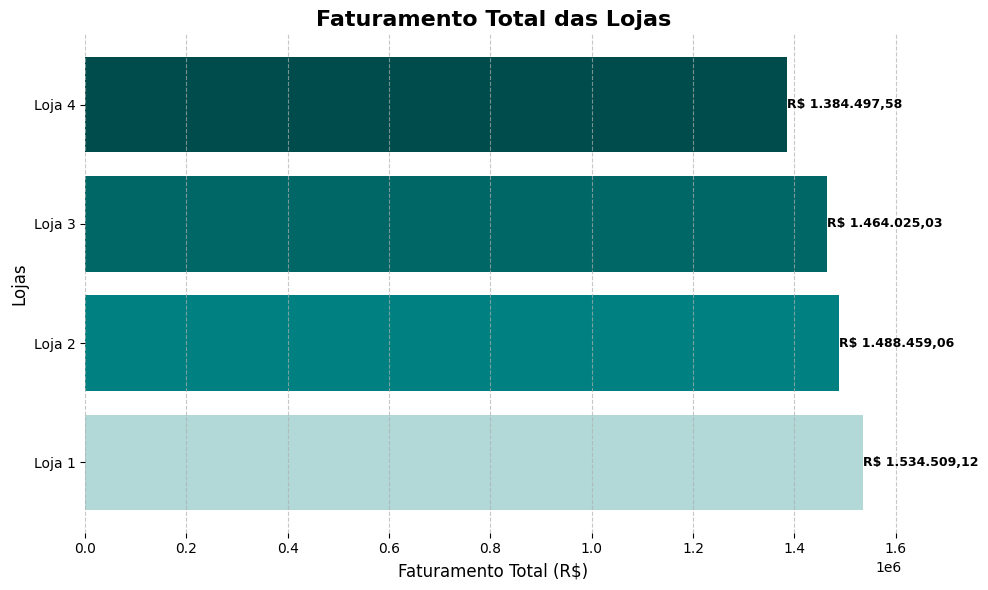

In [39]:
import locale
import csv
import requests
import matplotlib.pyplot as plt
import pandas as pd
import folium
import os
import io

# Configurando o diretório de imagens
IMAGE_DIR = 'imagens'

if not os.path.exists(IMAGE_DIR):
    os.makedirs(IMAGE_DIR, exist_ok=True)
    print(f"Pasta '{IMAGE_DIR}' criada com sucesso.")
else:
    print(f"A pasta '{IMAGE_DIR}' já existe. Prosseguindo com a geração do gráfico.")

print("\nConfigurações de salvamento de imagens prontas.")

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    # f-string com :.2f para 2 casas decimais, depois substitui separadores
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")
# --------------------------------------------------------------------------------------


# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# **************************************************************************************
# INÍCIO DA FUNÇÃO LER_CSV COM LÓGICA DE FALLBACK (CORREÇÃO APLICADA AQUI)
# **************************************************************************************
def ler_csv(url, local_path_prefix= 'data/raw/'): # Adicionado prefixo para o caminho local
    dados = []
    # Extrai o nome do arquivo da URL (ex: 'loja_1.csv')
    file_name = url.split('/')[-1]
    local_file_path = os.path.join(local_path_prefix, file_name)

    # --- TENTATIVA 1: LER DA URL ---
    try:
        print(f"Tentando ler dados da URL: {url}")
        response = requests.get(url, timeout=10) # Adicionado timeout
        response.raise_for_status() # Levanta um erro para respostas 4xx/5xx

        # Se chegou aqui, a requisição foi bem-sucedida
        # Usa io.StringIO para ler o texto da resposta como se fosse um arquivo
        leitor = csv.DictReader(io.StringIO(response.text))
        for linha in leitor:
            dados.append(linha)
        print(f"Sucesso: Dados lidos da URL: {url}")
        return dados

    except requests.exceptions.RequestException as e:
        print(f"ATENÇÃO: Erro ao ler da URL '{url}': {e}. Tentando arquivo local...")
    except Exception as e:
        print(f"ATENÇÃO: Erro inesperado ao ler da URL '{url}': {e}. Tentando arquivo local...")

    # --- TENTATIVA 2: LER DO ARQUIVO LOCAL (FALLBACK) ---
    if os.path.exists(local_file_path):
        try:
            print(f"Tentando ler dados do arquivo local: {local_file_path}")
            with open(local_file_path, 'r', encoding='utf-8') as f:
                leitor = csv.DictReader(f)
                for linha in leitor:
                    dados.append(linha)
            print(f"Sucesso: Dados lidos do arquivo local: {local_file_path}")
            return dados
        except Exception as e:
            print(f"ERRO: Não foi possível ler do arquivo local '{local_file_path}': {e}")
    else:
        print(f"ERRO: Arquivo local '{local_file_path}' não encontrado para fallback.")

    print(f"Falha total: Não foi possível obter dados para '{file_name}' de nenhuma fonte.")
    return [] # Retorna lista vazia se nenhuma fonte funcionou

# **************************************************************************************
# FIM DA FUNÇÃO LER_CSV COM LÓGICA DE FALLBACK
# **************************************************************************************

# Plotando os dados
nomes_lojas = []
faturamentos_lojas = []
cores_barras = ['#b2d8d8', '#008080', '#006666', '#004c4c']

print("Calculando faturamento para visualização...")

for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    nomes_lojas.append(nome_loja)

    dados_loja = ler_csv(url)
    faturamento_loja = 0

    if not dados_loja:
        faturamentos_lojas.append(0)
        print(f"Nenhum dado encontrado para a {nome_loja}. Faturamento: {formatar_moeda_br(0)}.")
        continue

    for venda in dados_loja:
        try:
            preco = float(venda['Preço'])
            faturamento_loja += preco
        except KeyError as e: # Melhor tratamento: KeyError para chave não encontrada
            print(f"AVISO ({nome_loja}): Coluna 'Preço' não encontrada ({e}). Venda: {venda}. Ignorando esta venda.")
        except ValueError as e: # Tratamento para valores que não são números
            print(f"AVISO ({nome_loja}): Valor inválido em 'Preço' ({e}). Venda: {venda}. Ignorando esta venda.")

    faturamentos_lojas.append(faturamento_loja)
    print(f"{nome_loja} Faturamento: {formatar_moeda_br(faturamento_loja)}")


# Criando as barras do gráfico
plt.figure(figsize=(10, 6))
plt.barh(nomes_lojas, faturamentos_lojas, color=cores_barras)

# Removendo a borda do gráfico
ax = plt.gca() # Obtém o eixo atual (área de plotagem)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)


# Adicionando títulos e categorias
plt.title('Faturamento Total das Lojas', fontsize=16, fontweight='bold')
plt.xlabel('Faturamento Total (R$)', fontsize=12)
plt.ylabel('Lojas', fontsize=12)

# Adicionando os valores às categorias no topo da barra
for faturamento_loja_valor, nome_loja in zip(faturamentos_lojas, nomes_lojas):
    plt.text(faturamento_loja_valor, nome_loja, formatar_moeda_br(faturamento_loja_valor), ha='left', va='center', fontsize=9, rotation=0, color='black', fontweight='bold')


plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.xticks(rotation=0)
plt.tight_layout()

# Salvando o gráfico
file_name = 'faturamento_por_lojas_grafico.png'
save_path = os.path.join(IMAGE_DIR, file_name)

plt.savefig(save_path)

print(f"Gráfico '{file_name}' gerado com sucesso e salvo em '{save_path}'")

# Mostrando o gráfico
plt.show()
plt.close()  # Fecha a figura para liberar memória

##1.3. Faturamento por Categoria: **Faturamento por Categorias: Qual tipo de produto (ex: eletrônicos, móveis) gera mais receita.**


A pasta '../imagens' já existe. Prosseguindo com a geração do gráfico.

Configurações de salvamento de imagens prontas.
Calculando faturamento para visualização...
---Processando Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Tentando ler dados da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv
Sucesso: Dados lidos da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv
Vendas por categoria na Loja 1:
Venda da categoria eletronicos: R$ 572.659,23
Venda da categoria moveis: R$ 250.178,11
Venda da categoria brinquedos: R$ 23.993,78
Venda da categoria eletrodomesticos: R$ 484.913,36
Venda da categoria utilidades domesticas: R$ 16.931,48
Venda da categoria esporte e lazer: R$ 52.387,55
Venda da categoria livros: R$ 11.713,92
Venda da 

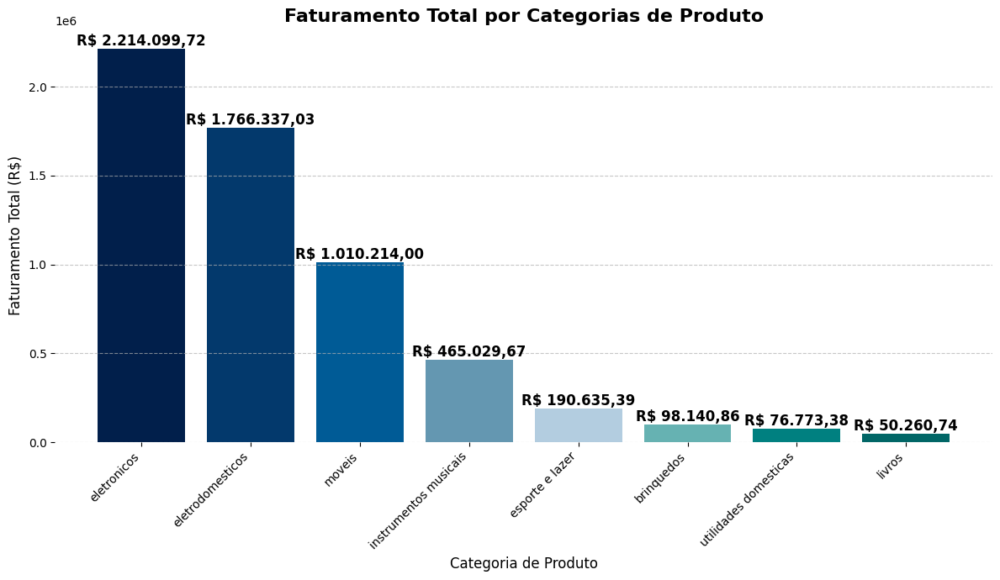

---Vendas totais por categoria (todas as lojas):
Venda Total da Categoria eletronicos: R$ 2.214.099,72
Venda Total da Categoria moveis: R$ 1.010.214,00
Venda Total da Categoria brinquedos: R$ 98.140,86
Venda Total da Categoria eletrodomesticos: R$ 1.766.337,03
Venda Total da Categoria utilidades domesticas: R$ 76.773,38
Venda Total da Categoria esporte e lazer: R$ 190.635,39
Venda Total da Categoria livros: R$ 50.260,74
Venda Total da Categoria instrumentos musicais: R$ 465.029,67
Total geral de vendas (soma das categorias): R$ 5.871.490,79
Faturamento total de todas as lojas:R$ 5.871.490,79
Resumo de Faturamento por Loja:
Loja 1 R$ 1.534.509,12
Loja 2 R$ 1.488.459,06
Loja 3 R$ 1.464.025,03
Loja 4 R$ 1.384.497,58
------------------------------
Total Global: R$ 5.871.490,79


In [40]:
import locale # Mantenha este import, mas não usaremos locale.currency() diretamente
import csv
import requests
import matplotlib.pyplot as plt
import pandas as pd
import folium
import os
import io # Importação necessária para ler strings como arquivos CSV


# Configurando o diretório de imagens
# Caminho para a pasta 'imagens' que está na raiz do projeto (se o notebook está em 'notebooks/')
IMAGE_DIR = '../imagens'

if not os.path.exists(IMAGE_DIR):
    os.makedirs(IMAGE_DIR, exist_ok=True)
    print(f"Pasta '{IMAGE_DIR}' criada com sucesso.")
else:
    print(f"A pasta '{IMAGE_DIR}' já existe. Prosseguindo com a geração do gráfico.")

print("\nConfigurações de salvamento de imagens prontas.")

# --- Função de Formatação de Moeda Personalizada (Esta é a que queremos usar!) ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    # f-string com :.2f para 2 casas decimais, depois substitui separadores
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")
# --------------------------------------------------------------------------------------


# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# **************************************************************************************
# ÚNICA E CORRETA FUNÇÃO LER_CSV (Com lógica de fallback)
# **************************************************************************************
def ler_csv(url, local_path_prefix='../data/raw/'): # Caminho para a pasta 'data/raw/' a partir da raiz do projeto
    dados = []
    file_name = url.split('/')[-1]
    local_file_path = os.path.join(local_path_prefix, file_name)

    # --- TENTATIVA 1: LER DA URL ---
    try:
        print(f"Tentando ler dados da URL: {url}")
        response = requests.get(url, timeout=10)
        response.raise_for_status()

        leitor = csv.DictReader(io.StringIO(response.text))
        for linha in leitor:
            dados.append(linha)
        print(f"Sucesso: Dados lidos da URL: {url}")
        return dados

    except requests.exceptions.RequestError as e: # requests.exceptions.RequestException é a classe base para todos os erros de requests
        print(f"ATENÇÃO: Erro ao ler da URL '{url}': {e}. Tentando arquivo local...")
    except Exception as e:
        print(f"ATENÇÃO: Erro inesperado ao ler da URL '{url}': {e}. Tentando arquivo local...")

    # --- TENTATIVA 2: LER DO ARQUIVO LOCAL (FALLBACK) ---
    if os.path.exists(local_file_path):
        try:
            print(f"Tentando ler dados do arquivo local: {local_file_path}")
            with open(local_file_path, 'r', encoding='utf-8') as f:
                leitor = csv.DictReader(f)
                for linha in leitor:
                    dados.append(linha)
            print(f"Sucesso: Dados lidos do arquivo local: {local_file_path}")
            return dados
        except Exception as e:
            print(f"ERRO: Não foi possível ler do arquivo local '{local_file_path}': {e}")
    else:
        print(f"ERRO: Arquivo local '{local_file_path}' não encontrado para fallback.")

    print(f"Falha total: Não foi possível obter dados para '{file_name}' de nenhuma fonte.")
    return []

# **************************************************************************************
# FIM DA FUNÇÃO LER_CSV
# **************************************************************************************

# Variáveis para coleta de dados das categorias (total geral)
vendas_por_categoria = {}
faturamentos_por_loja = {} # Dicionário para coletar o faturamento de cada loja para o resumo
cores_barras = ['#011f4b', '#03396c', '#005b96', '#6497b1', '#b3cde0', '#66b2b2', '#008080', '#006666']

print("Calculando faturamento para visualização...")

# Processar todas as lojas para preencher vendas_por_categorias e faturamentos_por_loja
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"---Processando {nome_loja} (URL: {url})...")

    categorias_loja = {} # Para imprimir o resumo por categoria DA LOJA ATUAL
    faturamento_loja_atual = 0 # Para acumular o faturamento da loja atual

    dados_loja = ler_csv(url) # Chama a única função ler_csv existente

    if not dados_loja:
        print(f"Nenhum dado encontrado para a {nome_loja}. Pulando esta loja.")
        faturamentos_por_loja[nome_loja] = 0 # Adiciona 0 se não houver dados
        print("---")
        continue

    for venda in dados_loja:
        try:
            categoria = venda['Categoria do Produto']
            preco = float(venda['Preço'])
            valor_venda = preco
            faturamento_loja_atual += valor_venda # Acumula o faturamento da loja atual

            categorias_loja[categoria] = categorias_loja.get(categoria, 0) + valor_venda
            vendas_por_categoria[categoria] = vendas_por_categoria.get(categoria, 0) + valor_venda

        except KeyError as e:
            print(f"AVISO ({nome_loja}): Coluna não encontrada ({e}). Venda: {venda}. Ignorando esta venda.")
        except ValueError as e:
            print(f"AVISO ({nome_loja}): Valor inválido em 'Preço' ({e}). Venda: {venda}. Ignorando esta venda.")

    # Armazena o faturamento total da loja no dicionário faturamentos_por_loja
    faturamentos_por_loja[nome_loja] = faturamento_loja_atual

    # Imprime vendas por categoria para a loja atual (opcional, mas bom para debug)
    if categorias_loja: # Se a loja teve vendas válidas
        print(f"Vendas por categoria na {nome_loja}:")
        for categoria, total_venda in categorias_loja.items():
            print(f"Venda da categoria {categoria}: {formatar_moeda_br(total_venda)}")

    print("---")

categorias_para_grafico = list(vendas_por_categoria.keys())
valores_categorias_para_grafico = list(vendas_por_categoria.values())

print("\nDados para o gráfico de categorias coletados.")

# ORDENAÇÃO DOS DADOS --------
dados_ordenaveis = sorted(vendas_por_categoria.items(), key=lambda item: item[1], reverse=True)

categorias_para_grafico = [item[0] for item in dados_ordenaveis]
valores_categorias_para_grafico = [item[1] for item in dados_ordenaveis]


# Criando as barras do gráfico
plt.figure(figsize=(12, 7))
plt.bar(categorias_para_grafico, valores_categorias_para_grafico, color=cores_barras)

# Removendo a borda do gráfico
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)


# Adicionando títulos e categorias
plt.title('Faturamento Total por Categorias de Produto', fontsize=16, fontweight='bold')
plt.xlabel('Categoria de Produto', fontsize=12)
plt.ylabel('Faturamento Total (R$)', fontsize=12)

# Adicionando os valores às categorias no topo da barra
for categoria_nome, valor_categoria in zip(categorias_para_grafico, valores_categorias_para_grafico):
    plt.text(categoria_nome, valor_categoria, formatar_moeda_br(valor_categoria), ha='center', va='bottom', fontsize=12, rotation=0, color='black', fontweight='bold')


plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Salvando o gráfico (agora com IMAGE_DIR correto e único)
file_name = 'faturamento_por_categorias_grafico.png'
save_path = os.path.join(IMAGE_DIR, file_name)

plt.savefig(save_path)
print(f"\nGráfico '{file_name}' gerado com sucesso e salvo em '{save_path}'.")

# Mostrando o gráfico ANTES de fechá-lo
plt.show()
plt.close() # Fechar o gráfico depois de mostrar

# --- RESUMO FINAL DO FATURAMENTO POR LOJA ---
# CORREÇÃO AQUI: Usando formatar_moeda_br() para cada categoria no resumo total
print("---Vendas totais por categoria (todas as lojas):")
for categoria, valor in vendas_por_categoria.items():
    # Substituído: locale.currency() por formatar_moeda_br() AQUI!
    valor_total_das_categorias_formatado = formatar_moeda_br(valor)
    print(f"Venda Total da Categoria {categoria}: {valor_total_das_categorias_formatado}")

faturamento_total_global = sum(faturamentos_por_loja.values()) # Calcula o total global

print(f"Total geral de vendas (soma das categorias): {formatar_moeda_br(faturamento_total_global)}")
print(f"Faturamento total de todas as lojas:{formatar_moeda_br(faturamento_total_global)}")

print("==============================")
print("Resumo de Faturamento por Loja:")
# Iterar sobre o dicionário 'faturamentos_por_loja' que coletamos no loop
for nome_loja_key, fat_val in faturamentos_por_loja.items():
    print(f"{nome_loja_key} {formatar_moeda_br(fat_val)}")

print("------------------------------")
print(f"Total Global: {formatar_moeda_br(faturamento_total_global)}")
print("==============================")

##1.4. Faturamento por Produtos: **Identificação dos produtos mais vendidos e seus respectivos valores gerados.**

Iniciando o cálculo do faturamento e frequência de vendas por produto...
Processando Loja 1 para faturamento e quantidade por produto (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
---
Processando Loja 2 para faturamento e quantidade por produto (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
---
Processando Loja 3 para faturamento e quantidade por produto (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
---
Processando Loja 4 para faturamento e quantidade por produto (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

Cálculo de faturamento e frequência de vendas por produto concluído.

--- Resumo de Faturamento por Produto ---
Produt

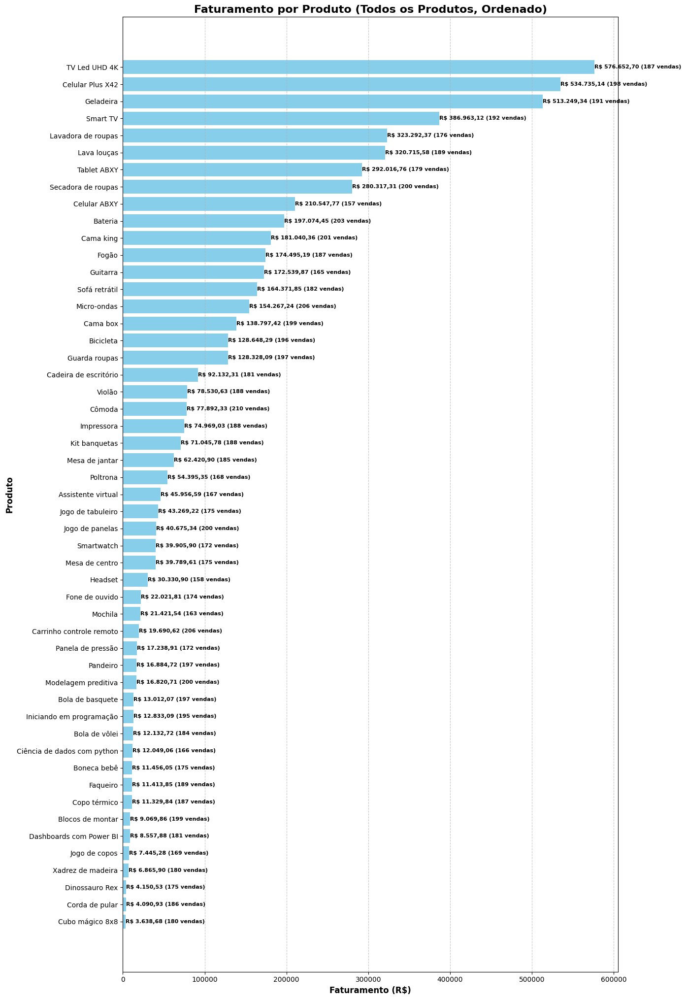

In [41]:
import locale
import csv
import requests
import matplotlib.pyplot as plt

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    # f-string com :.2f para 2 casas decimais, depois substitui separadores
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")
# --------------------------------------------------------------------------------------


# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Análise de Faturamento e Frequência de Vendas por Produto ---
# Dicionário para armazenar o faturamento total por produto
faturamento_por_produto = {}
frequencia_vendas_por_produtos = {}
total_geral_vendas_registradas = 0

print("Iniciando o cálculo do faturamento e frequência de vendas por produto...")

for i, url in enumerate(urls):
    print(f"Processando Loja {i + 1} para faturamento e quantidade por produto (URL: {url})...")
    dados_loja = ler_csv(url)

    if not dados_loja:
        print(f"Nenhum dado encontrado para a loja {i + 1}. Pulando esta loja.")
        print("---")
        continue

    for venda in dados_loja:
        try:
            produto = venda['Produto'] # Coluna do nome do produto
            preco = float(venda['Preço'])

            # Acumular faturamento por produto
            if produto in faturamento_por_produto:
                faturamento_por_produto[produto] += preco
            else:
                faturamento_por_produto[produto] = preco

            # Acumular frequência de vendas por produto
            if produto in frequencia_vendas_por_produtos:
                frequencia_vendas_por_produtos[produto] += 1
            else:
                frequencia_vendas_por_produtos[produto] = 1

            total_geral_vendas_registradas += 1


        except KeyError as e:
            print(f"AVISO (Loja {i+1}): Coluna 'Produto', 'Preço' ou 'Quantidade' não encontrada ({e}). Venda: {venda}. Ignorando esta venda.")
        except ValueError as e:
            print(f"AVISO (Loja {i+1}): Erro de valor em 'Preço' ou 'Quantidade' ({e}). Venda: {venda}. Ignorando esta venda.")
    print("---")

print("\nCálculo de faturamento e frequência de vendas por produto concluído.")

# --- Identificando o Produto Mais e Menos Vendido (por Faturamento) ---
if faturamento_por_produto:
    # Ordena os produtos por faturamento (do maior para o menor)
    produtos_ordenados_por_faturamento = sorted(faturamento_por_produto.items(), key=lambda item: item[1], reverse=True)

    produto_mais_vendido_faturamento = produtos_ordenados_por_faturamento[0]
    produto_menos_vendido_faturamento = produtos_ordenados_por_faturamento[-1]

    print("\n--- Resumo de Faturamento por Produto ---")
    print(f"Produto Mais Vendido (Faturamento): '{produto_mais_vendido_faturamento[0]}' com faturamento de {formatar_moeda_br(produto_mais_vendido_faturamento[1])}")
    print(f"Produto Menos Vendido (Faturamento): '{produto_menos_vendido_faturamento[0]}' com faturamento de {formatar_moeda_br(produto_menos_vendido_faturamento[1])}")


    print(f"\nTotal Geral de Vendas Registradas:{total_geral_vendas_registradas} ocorrências.")

    # --- Preparar dados para o gráfico de TODOS os Produtos (ordenados por Faturamento) ---
    nomes_todos_produtos = [item[0] for item in produtos_ordenados_por_faturamento]
    faturamentos_todos_produtos = [item[1] for item in produtos_ordenados_por_faturamento]

    # --- Visualização em Gráfico de Barras (TODOS os Produtos por Faturamento) ---
    plt.figure(figsize=(14, max(8, len(nomes_todos_produtos) * 0.4))) # Ajusta o tamanho da figura dinamicamente
    plt.barh(nomes_todos_produtos, faturamentos_todos_produtos, color='skyblue')

    # Personalização do gráfico
    plt.title('Faturamento por Produto (Todos os Produtos, Ordenado)', fontsize=16, fontweight='bold')
    plt.xlabel('Faturamento (R$)', fontsize=12, fontweight='bold')
    plt.ylabel('Produto', fontsize=12, fontweight='bold')

    # Adicionar valores sobre as barras (Faturamento e Quantidade)
    for i, (valor_faturamento, nome_produto) in enumerate(zip(faturamentos_todos_produtos, nomes_todos_produtos)):
        # Busca a frequência vendida para o produto atual
        freq_vendida = frequencia_vendas_por_produtos.get(nome_produto, 0)
        label_texto = f"{formatar_moeda_br(valor_faturamento)} ({freq_vendida} vendas)"
        plt.text(valor_faturamento, i, label_texto, ha='left', va='center', fontsize=8, rotation=0, color='black', fontweight='bold')

    plt.grid(axis='x', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.gca().invert_yaxis() # Inverte o eixo Y para que o maior valor fique no topo
    plt.savefig('faturamento_todos_produtos_grafico.png')
    print(f"\nGráfico 'faturamento_todos_produtos_grafico.png' gerado com sucesso.")
    plt.show()

else:
    print("Não foi possível calcular o faturamento e frequência de vendas por produto (dados não carregados ou ausentes).")

Iniciando o cálculo de faturamento por produto, por loja...

Processando Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Faturamento Total da Loja 1: R$ 1.534.509,12
Gráfico 'faturamento_top_5_produtos_Loja_1_grafico.png' gerado com sucesso.


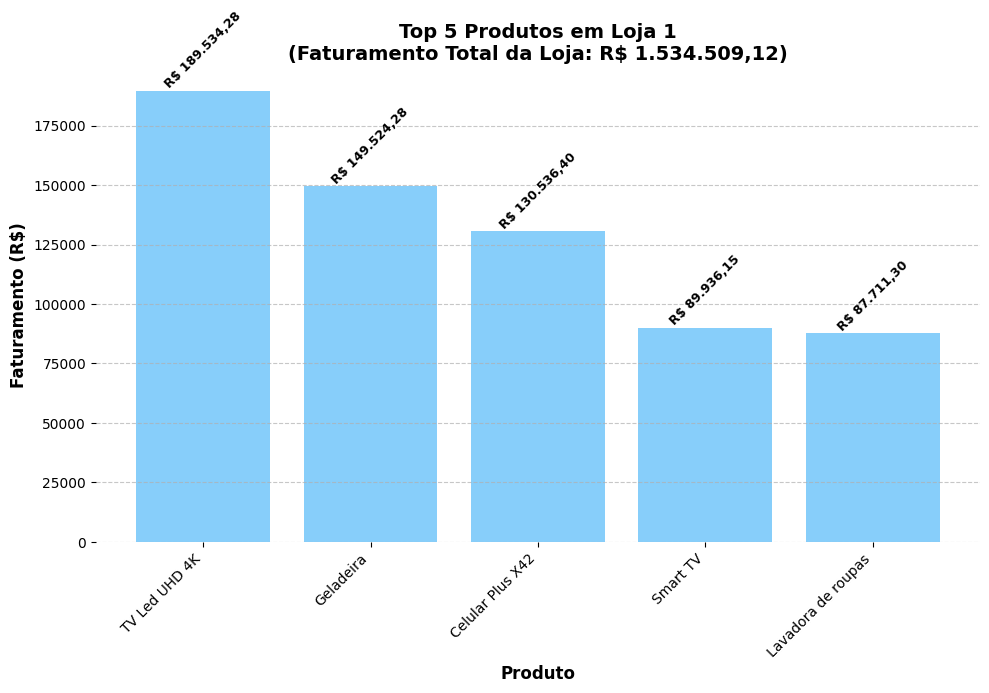


Processando Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Faturamento Total da Loja 2: R$ 1.488.459,06
Gráfico 'faturamento_top_5_produtos_Loja_2_grafico.png' gerado com sucesso.


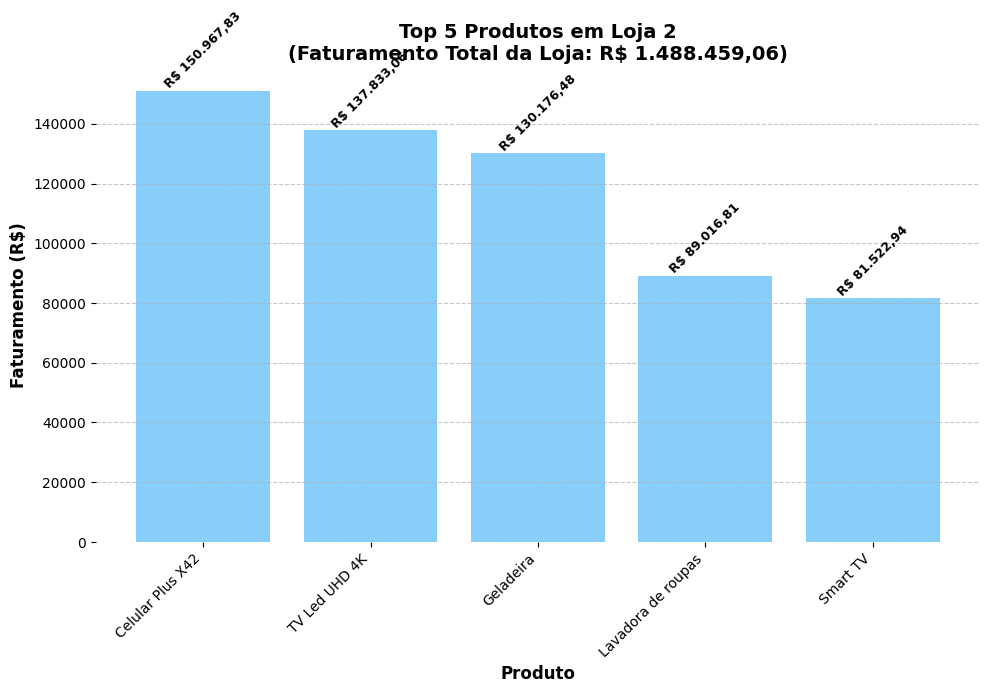


Processando Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Faturamento Total da Loja 3: R$ 1.464.025,03
Gráfico 'faturamento_top_5_produtos_Loja_3_grafico.png' gerado com sucesso.


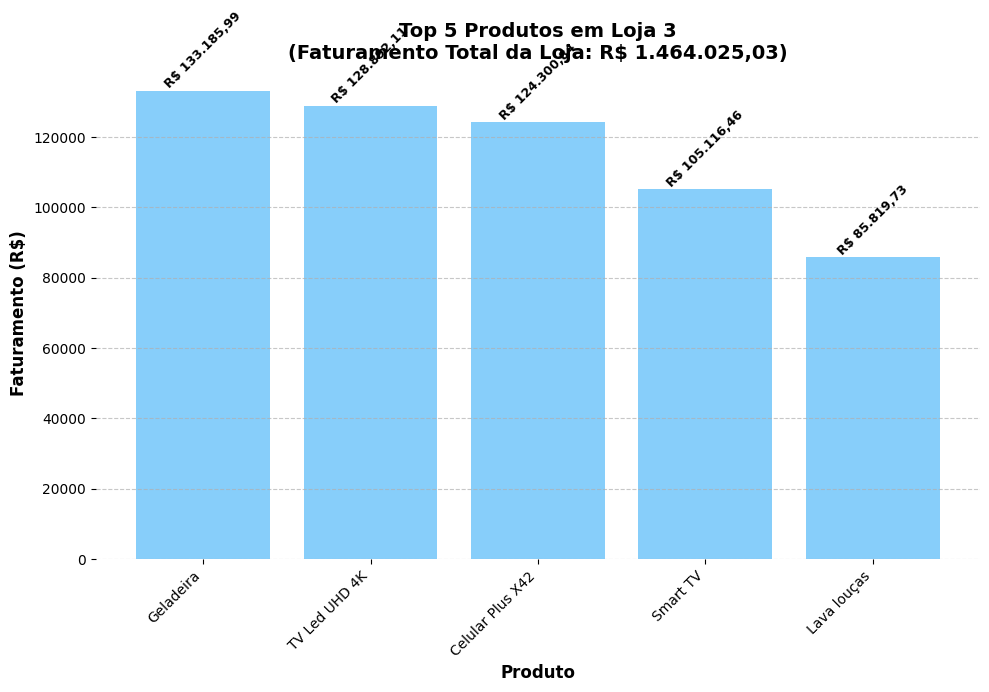


Processando Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
Faturamento Total da Loja 4: R$ 1.384.497,58
Gráfico 'faturamento_top_5_produtos_Loja_4_grafico.png' gerado com sucesso.


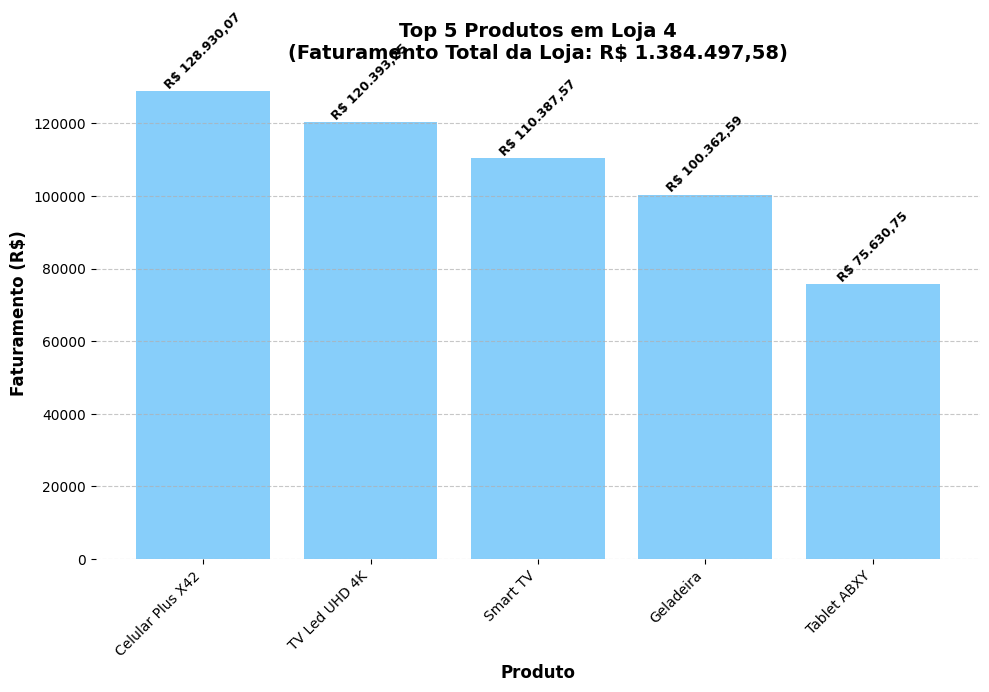


Análise de faturamento por produto, por loja, concluída.


In [42]:
# Análise de Faturamento por Produto, por Loja (e seus gráficos)
''' Para cada loja, vamos:
    1. calcular o faturamento total da loja.
    2. calcular o faturamento de cada produto dentro daquela loja.
    3. identificar os produtos mais vendidos dessa loja(os Top N).
    4. criar um gráfico de barras que mostra esses Top N produtos, e que
    de alguma forma contextualize o faturamento total da loja.
'''

import locale
import csv
import requests
import matplotlib.pyplot as plt

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")
# --------------------------------------------------------------------------------------

# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Análise de Faturamento por Produto, por Loja ---
print("Iniciando o cálculo de faturamento por produto, por loja...")

# Iterar sobre cada loja para gerar um gráfico individual
for i, url in enumerate(urls):
    nome_loja_completo = f"Loja {i + 1}"
    print(f"\nProcessando {nome_loja_completo} (URL: {url})...")
    dados_loja = ler_csv(url)

    faturamento_total_loja = 0
    faturamento_produtos_na_loja = {} # Dicionário para produtos desta loja

    if not dados_loja:
        print(f"Nenhum dado encontrado para a {nome_loja_completo}. Pulando esta loja.")
        # Se não há dados, o gráfico será vazio ou não será gerado
        continue

    for venda in dados_loja:
        try:
            produto = venda['Produto']
            preco = float(venda['Preço'])

            faturamento_total_loja += preco # Acumula o faturamento total da loja

            if produto in faturamento_produtos_na_loja:
                faturamento_produtos_na_loja[produto] += preco
            else:
                faturamento_produtos_na_loja[produto] = preco
        except KeyError as e:
            print(f"AVISO ({nome_loja_completo}): Coluna 'Produto' ou 'Preço' não encontrada ({e}). Venda: {venda}. Ignorando esta venda.")
        except ValueError as e:
            print(f"AVISO ({nome_loja_completo}): Erro de valor em 'Preço' ({e}). Venda: {venda}. Ignorando esta venda.")

    print(f"Faturamento Total da {nome_loja_completo}: {formatar_moeda_br(faturamento_total_loja)}")

# --- Preparar dados para o gráfico dos Top N Produtos da LOJA ATUAL ---
    if faturamento_produtos_na_loja:
        # Ordenar os produtos desta loja por faturamento
        produtos_ordenados_loja = sorted(faturamento_produtos_na_loja.items(), key=lambda item: item[1], reverse=True)

        N_top_produtos_loja = 5 # Top 5 produtos por loja (você pode ajustar este N)
        top_n_produtos_loja = produtos_ordenados_loja[:N_top_produtos_loja]

        nomes_produtos_grafico = [item[0] for item in top_n_produtos_loja]
        faturamentos_produtos_grafico = [item[1] for item in top_n_produtos_loja]

        # --- Criação do Gráfico de Barras para a Loja Atual ---
        plt.figure(figsize=(10, 7)) # Tamanho da figura
        # Gráfico de colunas (bar) para produtos (categorias no X, faturamento no Y)
        plt.bar(nomes_produtos_grafico, faturamentos_produtos_grafico, color='lightskyblue')

        # Remover bordas
        ax = plt.gca()
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['left'].set_visible(False)
        ax.spines['bottom'].set_visible(False)

        # Títulos e rótulos
        plt.title(f'Top {N_top_produtos_loja} Produtos em {nome_loja_completo}\n'
                  f'(Faturamento Total da Loja: {formatar_moeda_br(faturamento_total_loja)})',
                  fontsize=14, fontweight='bold', ha='center') # Título em duas linhas, centralizado
        plt.xlabel('Produto', fontsize=12, fontweight='bold')
        plt.ylabel('Faturamento (R$)', fontsize=12, fontweight='bold')

        # Rótulos de valor nas barras
        for j, (produto_nome, faturamento_valor) in enumerate(zip(nomes_produtos_grafico, faturamentos_produtos_grafico)):
            plt.text(j, faturamento_valor, formatar_moeda_br(faturamento_valor),
                     ha='center', va='bottom', fontsize=9, rotation=45, color='black', fontweight='bold')

        plt.grid(axis='y', linestyle='--', alpha=0.7) # Grade no eixo Y (faturamento)
        plt.xticks(rotation=45, ha='right') # Rotação dos nomes dos produtos no eixo X
        plt.tight_layout() # Ajusta o layout para evitar sobreposição de rótulos

        # Salvar o gráfico
        plt.savefig(f'faturamento_top_{N_top_produtos_loja}_produtos_{nome_loja_completo.replace(" ", "_")}_grafico.png')
        print(f"Gráfico 'faturamento_top_{N_top_produtos_loja}_produtos_{nome_loja_completo.replace(' ', '_')}_grafico.png' gerado com sucesso.")
        plt.show()

    else:
        print(f"Não há dados de produtos para {nome_loja_completo} para gerar o gráfico.")
    print("="*50) # Separador visual entre as lojas

print("\nAnálise de faturamento por produto, por loja, concluída.")



# 2. Desempenho de vendas

##2.1. Média de Avaliação das Lojas


--- Análise de Média de Avaliação por Loja e por Produto (usando Pandas) ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Carregando dados da Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Carregando dados da Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

--- Colunas do DataFrame de Vendas ---
Index(['Produto', 'Categoria do Produto', 'Preço', 'Frete', 'Data da Compra',
       'Vendedor', 'Local da compra', 'Avaliação da compra',
       'Tipo de pagamento', 'Quantidade de parcelas', 'lat', 'lon', 'Loja'],
      

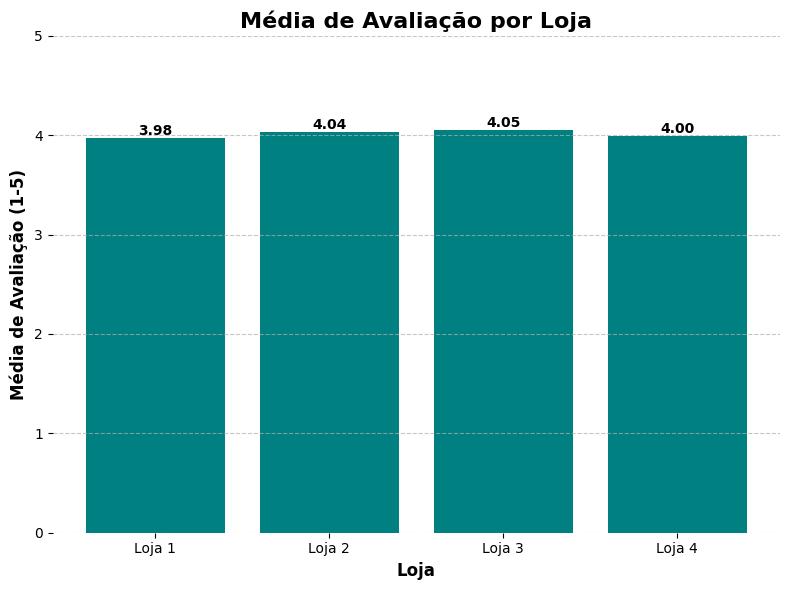


--- Faturamento e Média de Avaliação por Produto (Pandas) ---
Produto: 'TV Led UHD 4K' - Faturamento: R$ 576.652,70 - Média Avaliação: 3.99 (187 avaliações)
Produto: 'Celular Plus X42' - Faturamento: R$ 534.735,14 - Média Avaliação: 3.96 (198 avaliações)
Produto: 'Geladeira' - Faturamento: R$ 513.249,34 - Média Avaliação: 4.16 (191 avaliações)
Produto: 'Smart TV' - Faturamento: R$ 386.963,12 - Média Avaliação: 3.96 (192 avaliações)
Produto: 'Lavadora de roupas' - Faturamento: R$ 323.292,37 - Média Avaliação: 3.94 (176 avaliações)
Produto: 'Lava louças' - Faturamento: R$ 320.715,58 - Média Avaliação: 3.96 (189 avaliações)
Produto: 'Tablet ABXY' - Faturamento: R$ 292.016,76 - Média Avaliação: 3.96 (179 avaliações)
Produto: 'Secadora de roupas' - Faturamento: R$ 280.317,31 - Média Avaliação: 4.01 (200 avaliações)
Produto: 'Celular ABXY' - Faturamento: R$ 210.547,77 - Média Avaliação: 4.05 (157 avaliações)
Produto: 'Bateria' - Faturamento: R$ 197.074,45 - Média Avaliação: 4.13 (203 avalia

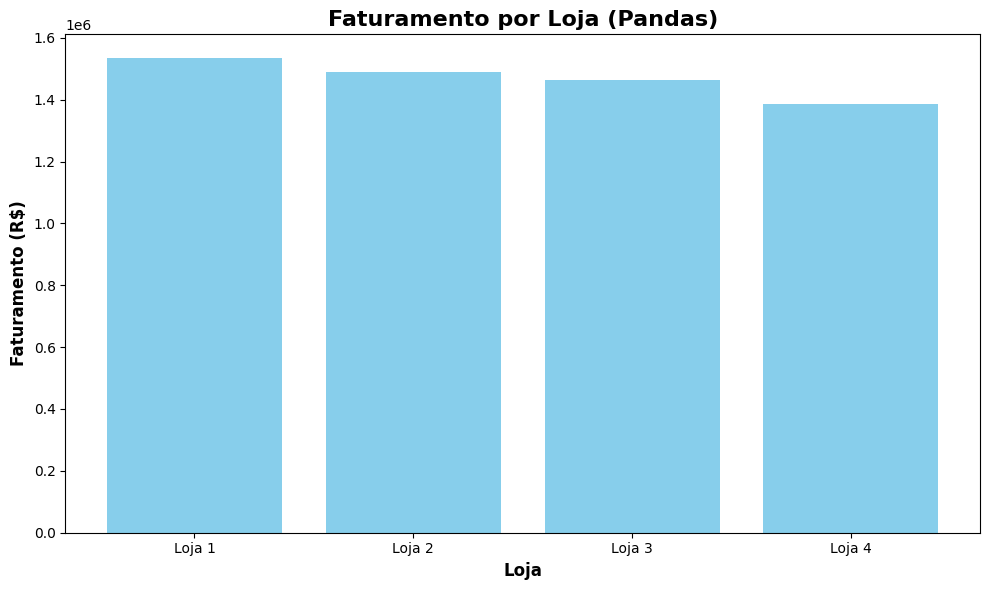

In [43]:
import locale
import csv
import requests
import pandas as pd
import matplotlib.pyplot as plt

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")
# --------------------------------------------------------------------------------------

# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados


# --- Análise de Média de Avaliação das Lojas e Produtos (com PANDAS) ---
print("\n--- Análise de Média de Avaliação por Loja e por Produto (usando Pandas) ---")

todos_dados_vendas = []
# Primeiro, consolide todos os dados de vendas em uma única lista de dicionários
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url)
    if dados_loja:
        # Adiciona uma coluna 'Loja' a cada registro ANTES de consolidar
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

      # --- ADIÇÃO CRÍTICA PARA DEPURAR ---
    print("\n--- Colunas do DataFrame de Vendas ---")
    print(df_vendas.columns)
    print("\n--- Primeiras linhas do DataFrame de Vendas ---")
    print(df_vendas.head())
    # ------------------------------------

    # Converte 'Preço' e 'Avaliação da compra' para numérico, tratando erros
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')

    # Remove linhas onde 'Preço' ou 'Avaliação da compra' não são números válidos para evitar problemas nos cálculos
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra'], inplace=True)

    if not df_vendas.empty:
        # Faturamento por Loja
        faturamento_por_loja_df = df_vendas.groupby('Loja')['Preço'].sum().reset_index()
        print("\n--- Faturamento por Loja (Pandas) ---")
        for index, row in faturamento_por_loja_df.iterrows():
            print(f"{row['Loja']}: {formatar_moeda_br(row['Preço'])}")

        # Média de Avaliação por Loja
        media_avaliacao_por_loja_df = df_vendas.groupby('Loja')['Avaliação da compra'].mean().reset_index()
        print("\n--- Média de Avaliação por Loja (Pandas) ---")
        for index, row in media_avaliacao_por_loja_df.iterrows():
            print(f"{row['Loja']}: {row['Avaliação da compra']:.2f}")

        # Criação do gráfico de barras de Avaliações por loja (com Pandas)
        if not media_avaliacao_por_loja_df.empty:
            plt.figure(figsize=(8, 6))
            plt.bar(media_avaliacao_por_loja_df['Loja'], media_avaliacao_por_loja_df['Avaliação da compra'], color='teal')

            # Removendo bordas
            ax = plt.gca()
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['bottom'].set_visible(False)

            # Títulos e rótulos
            plt.title('Média de Avaliação por Loja', fontsize=16, fontweight='bold')
            plt.xlabel('Loja', fontsize=12, fontweight='bold')
            plt.ylabel('Média de Avaliação (1-5)', fontsize=12, fontweight='bold')
            plt.ylim(0, 5) # Avaliações geralmente de 1 a 5

            # Rótulos de valor nas barras
            for x_pos, y_val in enumerate(media_avaliacao_por_loja_df['Avaliação da compra']):
                plt.text(x_pos, y_val, f'{y_val:.2f}', ha='center', va='bottom', fontsize=10, fontweight='bold')

            plt.grid(axis='y', linestyle='--', alpha=0.7)
            plt.xticks(rotation=0)
            plt.tight_layout()

            plt.savefig('media_avaliacao_por_loja_grafico_pandas.png')
            print(f"\nGráfico 'media_avaliacao_por_loja_grafico_pandas.png' gerado com sucesso.")
            plt.show()
        else:
            print("\nNão foi possível gerar o gráfico de média de avaliação por loja (DataFrame de médias vazio).")

        # Faturamento e Média de Avaliação por Produto
        faturamento_e_avaliacao_por_produto_df = df_vendas.groupby('Produto').agg(
            Faturamento=('Preço', 'sum'),
            Media_Avaliacao=('Avaliação da compra', 'mean'),
            Contagem_Avaliacoes=('Avaliação da compra', 'count') # Para saber quantas avaliações cada produto teve
        ).reset_index()

        # Ordena por faturamento
        faturamento_e_avaliacao_por_produto_df.sort_values(by='Faturamento', ascending=False, inplace=True)

        print("\n--- Faturamento e Média de Avaliação por Produto (Pandas) ---")
        # Exibe os top 10 produtos por faturamento e suas médias de avaliação
        for index, row in faturamento_e_avaliacao_por_produto_df.head(10).iterrows():
            print(f"Produto: '{row['Produto']}' - Faturamento: {formatar_moeda_br(row['Faturamento'])} - Média Avaliação: {row['Media_Avaliacao']:.2f} ({row['Contagem_Avaliacoes']} avaliações)")

        # Geração de Gráficos com Pandas (exemplo para Faturamento por Loja)
        # Você pode adaptar para outros gráficos usando os DataFrames criados
        nomes_lojas_grafico = faturamento_por_loja_df['Loja'].tolist()
        faturamentos_lojas_grafico = faturamento_por_loja_df['Preço'].tolist()

        plt.figure(figsize=(10, 6))
        plt.bar(nomes_lojas_grafico, faturamentos_lojas_grafico, color='skyblue')
        plt.title('Faturamento por Loja (Pandas)', fontsize=16, fontweight='bold')
        plt.xlabel('Loja', fontsize=12, fontweight='bold')
        plt.ylabel('Faturamento (R$)', fontsize=12, fontweight='bold')
        plt.tight_layout()
        plt.savefig('faturamento_por_loja_pandas_grafico.png')
        plt.show()

    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")

##2.2. Volume de vendas por loja: **quantidade de itens vendidos por cada unidade**


--- Análise de Volume de Vendas por Loja ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Carregando dados da Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Carregando dados da Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

--- Volume de Vendas por Loja (Contagem de Ocorrências) ---
Loja 1: 2359 vendas
Loja 2: 2359 vendas
Loja 3: 2359 vendas
Loja 4: 2358 vendas

Gráfico 'volume_vendas_por_loja_grafico.png' gerado com sucesso.


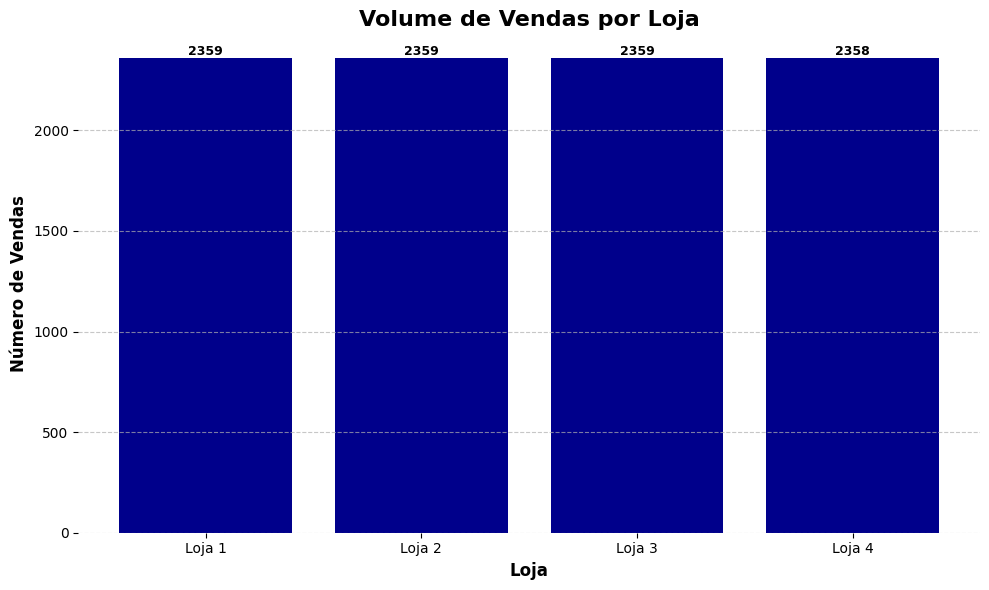

In [44]:
import pandas as pd
import csv
import requests
import matplotlib.pyplot as plt

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")
# --------------------------------------------------------------------------------------

# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Análise de Volume de Vendas por Loja (Quantidade de Itens Vendidos) ---
print("\n--- Análise de Volume de Vendas por Loja ---")

todos_dados_vendas = []
# Primeiro, consolide todos os dados de vendas em uma única lista de dicionários
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url)
    if dados_loja:
        # Adiciona uma coluna 'Loja' a cada registro ANTES de consolidar
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

    # Convertendo 'Preço' e 'Avaliação da compra' para numérico, tratando erros
    # --- MODIFICAÇÃO SOLICITADA AQUI ---
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')
    # --- FIM DA MODIFICAÇÃO ---

    # Removendo linhas com valores inválidos que impediriam cálculos
    # --- MODIFICAÇÃO SOLICITADA AQUI ---
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra'], inplace=True)
    # --- FIM DA MODIFICAÇÃO ---

    if not df_vendas.empty:
        # --- Cálculo do Volume de Vendas por Loja (Contagem de Vendas/Linhas) ---
        # Assumindo que cada linha na base de dados é um item/venda
        volume_vendas_por_loja_df = df_vendas.groupby('Loja').size().reset_index(name='Volume de Vendas')

        # Ordenar para o gráfico (opcional, mas bom para visualização)
        volume_vendas_por_loja_df.sort_values(by='Volume de Vendas', ascending=False, inplace=True)

        print("\n--- Volume de Vendas por Loja (Contagem de Ocorrências) ---")
        for index, row in volume_vendas_por_loja_df.iterrows():
            print(f"{row['Loja']}: {row['Volume de Vendas']} vendas")

        # --- Geração do Gráfico de Colunas: Volume de Vendas por Loja ---
        plt.figure(figsize=(10, 6))
        plt.bar(volume_vendas_por_loja_df['Loja'], volume_vendas_por_loja_df['Volume de Vendas'], color='darkblue')

        # Remover bordas
        ax = plt.gca()
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['left'].set_visible(False)
        ax.spines['bottom'].set_visible(False)

        # Títulos e rótulos
        plt.title('Volume de Vendas por Loja', fontsize=16, fontweight='bold')
        plt.xlabel('Loja', fontsize=12, fontweight='bold')
        plt.ylabel('Número de Vendas', fontsize=12, fontweight='bold')

        # Adicionar valores sobre as barras
        for x_pos, y_val in enumerate(volume_vendas_por_loja_df['Volume de Vendas']):
            plt.text(x_pos, y_val, f'{y_val}', ha='center', va='bottom', fontsize=9, fontweight='bold', color='black')

        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.xticks(rotation=0)
        plt.tight_layout()

        plt.savefig('volume_vendas_por_loja_grafico.png')
        print(f"\nGráfico 'volume_vendas_por_loja_grafico.png' gerado com sucesso.")
        plt.show()

    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")

##2.3. Volume de vendas por categorias: **Quantidade de itens vendidos por cada tipo de produto**


--- Carregando e Consolidando Dados de Vendas ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Carregando dados da Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Carregando dados da Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

--- Faturamento por Loja ---
Loja 1: R$ 1.534.509,12
Loja 2: R$ 1.488.459,06
Loja 3: R$ 1.464.025,03
Loja 4: R$ 1.384.497,58

--- Média de Avaliação por Loja ---
Loja 1: 3.98
Loja 2: 4.04
Loja 3: 4.05
Loja 4: 4.00

Gráfico 'media_avaliacao_por_loja_grafico_pandas.png' gerado com sucesso.

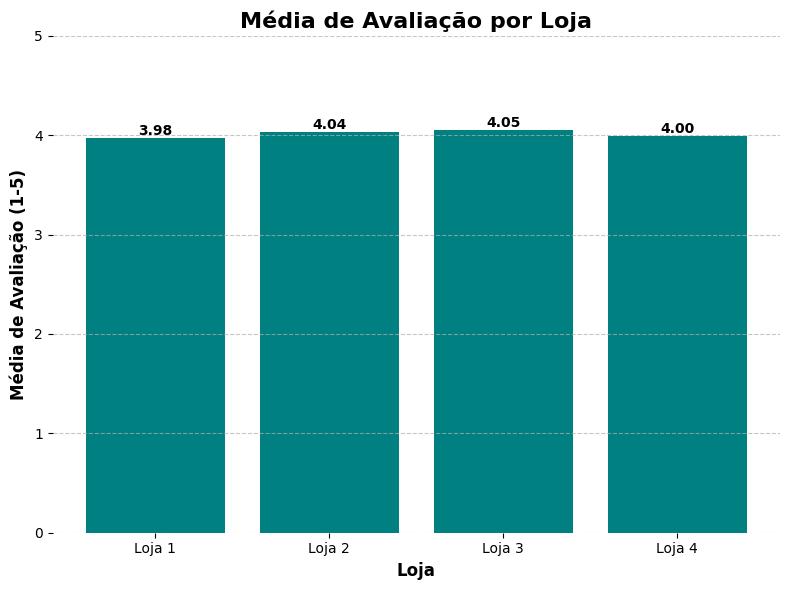


--- Volume de Vendas por Loja (Contagem de Ocorrências) ---
Loja 1: 2359 vendas
Loja 2: 2359 vendas
Loja 3: 2359 vendas
Loja 4: 2358 vendas

Gráfico 'volume_vendas_por_loja_grafico.png' gerado com sucesso.


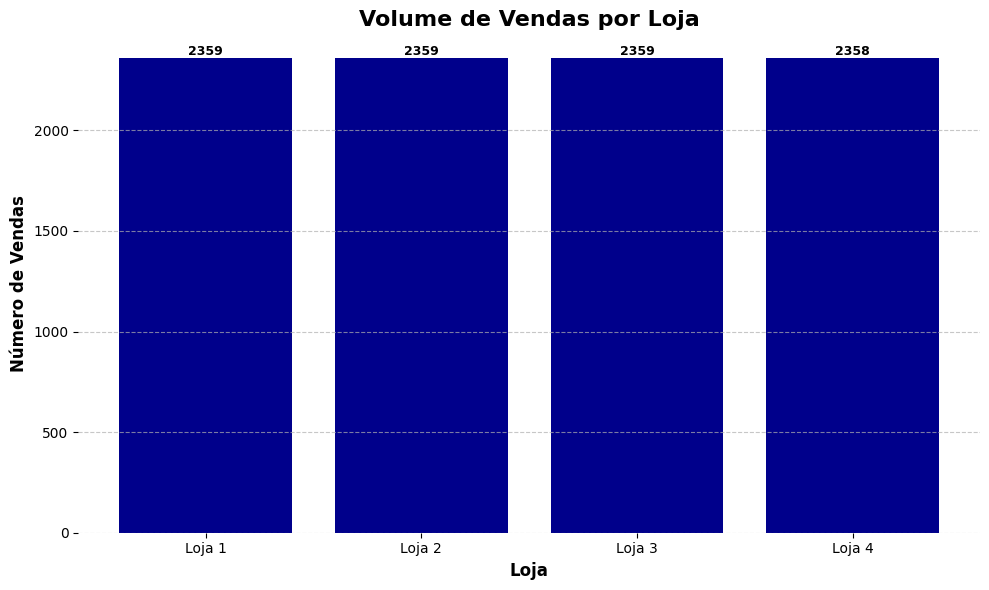


--- Volume de Vendas por Categoria (Produto) ---
Produto: 'Cômoda' - 210 vendas
Produto: 'Carrinho controle remoto' - 206 vendas
Produto: 'Micro-ondas' - 206 vendas
Produto: 'Bateria' - 203 vendas
Produto: 'Cama king' - 201 vendas
Produto: 'Jogo de panelas' - 200 vendas
Produto: 'Modelagem preditiva' - 200 vendas
Produto: 'Secadora de roupas' - 200 vendas
Produto: 'Blocos de montar' - 199 vendas
Produto: 'Cama box' - 199 vendas
Produto: 'Celular Plus X42' - 198 vendas
Produto: 'Bola de basquete' - 197 vendas
Produto: 'Pandeiro' - 197 vendas
Produto: 'Guarda roupas' - 197 vendas
Produto: 'Bicicleta' - 196 vendas
... e mais 36 outros produtos.

Gráfico 'top_15_produtos_volume_vendas_grafico.png' gerado com sucesso.


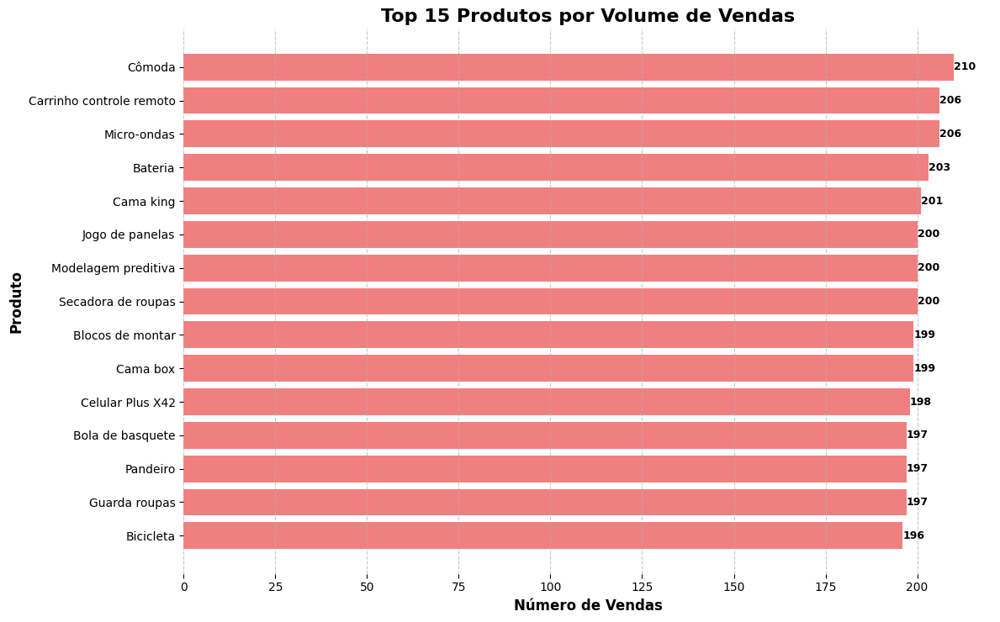

In [45]:
import pandas as pd
import csv
import requests
import matplotlib.pyplot as plt

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")
# --------------------------------------------------------------------------------------

# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Análise de Dados Consolidados (com PANDAS) ---
print("\n--- Carregando e Consolidando Dados de Vendas ---")

todos_dados_vendas = []
# Primeiro, consolide todos os dados de vendas em uma única lista de dicionários
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url)
    if dados_loja:
        # Adiciona uma coluna 'Loja' a cada registro ANTES de consolidar
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

    # Convertendo 'Preço' e 'Avaliação da compra' para numérico, tratando erros
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')

    # Removendo linhas com valores inválidos que impediriam cálculos
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra'], inplace=True)

    if not df_vendas.empty:
        # --- Análise de Faturamento por Loja ---
        faturamento_por_loja_df = df_vendas.groupby('Loja')['Preço'].sum().reset_index()
        print("\n--- Faturamento por Loja ---")
        for index, row in faturamento_por_loja_df.iterrows():
            print(f"{row['Loja']}: {formatar_moeda_br(row['Preço'])}")

        # --- Análise de Média de Avaliação por Loja ---
        media_avaliacao_por_loja_df = df_vendas.groupby('Loja')['Avaliação da compra'].mean().reset_index()
        print("\n--- Média de Avaliação por Loja ---")
        for index, row in media_avaliacao_por_loja_df.iterrows():
            print(f"{row['Loja']}: {row['Avaliação da compra']:.2f}")

        # --- Geração do Gráfico de Barras de Avaliações por Loja ---
        if not media_avaliacao_por_loja_df.empty:
            plt.figure(figsize=(8, 6))
            plt.bar(media_avaliacao_por_loja_df['Loja'], media_avaliacao_por_loja_df['Avaliação da compra'], color='teal')
            ax = plt.gca()
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            plt.title('Média de Avaliação por Loja', fontsize=16, fontweight='bold')
            plt.xlabel('Loja', fontsize=12, fontweight='bold')
            plt.ylabel('Média de Avaliação (1-5)', fontsize=12, fontweight='bold')
            plt.ylim(0, 5)
            for x_pos, y_val in enumerate(media_avaliacao_por_loja_df['Avaliação da compra']):
                plt.text(x_pos, y_val, f'{y_val:.2f}', ha='center', va='bottom', fontsize=10, fontweight='bold')
            plt.grid(axis='y', linestyle='--', alpha=0.7)
            plt.xticks(rotation=0)
            plt.tight_layout()
            plt.savefig('media_avaliacao_por_loja_grafico_pandas.png')
            print(f"\nGráfico 'media_avaliacao_por_loja_grafico_pandas.png' gerado com sucesso.")
            plt.show()
        else:
            print("\nNão foi possível gerar o gráfico de média de avaliação por loja (DataFrame de médias vazio).")

        # --- Análise de Volume de Vendas por Loja (Contagem de Ocorrências) ---
        volume_vendas_por_loja_df = df_vendas.groupby('Loja').size().reset_index(name='Volume de Vendas')
        volume_vendas_por_loja_df.sort_values(by='Volume de Vendas', ascending=False, inplace=True)
        print("\n--- Volume de Vendas por Loja (Contagem de Ocorrências) ---")
        for index, row in volume_vendas_por_loja_df.iterrows():
            print(f"{row['Loja']}: {row['Volume de Vendas']} vendas")

        # --- Geração do Gráfico de Colunas: Volume de Vendas por Loja ---
        if not volume_vendas_por_loja_df.empty:
            plt.figure(figsize=(10, 6))
            plt.bar(volume_vendas_por_loja_df['Loja'], volume_vendas_por_loja_df['Volume de Vendas'], color='darkblue')
            ax = plt.gca()
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            plt.title('Volume de Vendas por Loja', fontsize=16, fontweight='bold')
            plt.xlabel('Loja', fontsize=12, fontweight='bold')
            plt.ylabel('Número de Vendas', fontsize=12, fontweight='bold')
            for x_pos, y_val in enumerate(volume_vendas_por_loja_df['Volume de Vendas']):
                plt.text(x_pos, y_val, f'{y_val}', ha='center', va='bottom', fontsize=9, fontweight='bold', color='black')
            plt.grid(axis='y', linestyle='--', alpha=0.7)
            plt.xticks(rotation=0)
            plt.tight_layout()
            plt.savefig('volume_vendas_por_loja_grafico.png')
            print(f"\nGráfico 'volume_vendas_por_loja_grafico.png' gerado com sucesso.")
            plt.show()
        else:
            print("\nNão foi possível gerar o gráfico de volume de vendas por loja (DataFrame de volume vazio).")

        # --- NOVO: Análise de Volume de Vendas por Categoria (Produto) ---
        # Assumindo que cada linha é um item vendido
        volume_vendas_por_produto_df = df_vendas.groupby('Produto').size().reset_index(name='Volume de Vendas')

        # Ordenar os produtos pelo volume de vendas (do maior para o menor)
        volume_vendas_por_produto_df.sort_values(by='Volume de Vendas', ascending=False, inplace=True)

        print("\n--- Volume de Vendas por Categoria (Produto) ---")
        # Exibir os top 15 produtos por volume de vendas
        N_PRODUTOS_VOLUME = 15 # Define quantos produtos exibir na lista e no gráfico
        for index, row in volume_vendas_por_produto_df.head(N_PRODUTOS_VOLUME).iterrows():
            print(f"Produto: '{row['Produto']}' - {row['Volume de Vendas']} vendas")

        if len(volume_vendas_por_produto_df) > N_PRODUTOS_VOLUME:
            print(f"... e mais {len(volume_vendas_por_produto_df) - N_PRODUTOS_VOLUME} outros produtos.")


        # --- NOVO: Geração do Gráfico de Barras Horizontais: Volume de Vendas por Categoria (Top N) ---
        if not volume_vendas_por_produto_df.empty:
            # Pegar os N_PRODUTOS_VOLUME produtos com maior volume
            top_n_volume_produtos = volume_vendas_por_produto_df.head(N_PRODUTOS_VOLUME)

            plt.figure(figsize=(12, max(6, len(top_n_volume_produtos) * 0.5))) # Ajusta tamanho da figura dinamicamente
            plt.barh(top_n_volume_produtos['Produto'], top_n_volume_produtos['Volume de Vendas'], color='lightcoral')

            # Remover bordas
            ax = plt.gca()
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['bottom'].set_visible(False)

            # Títulos e rótulos
            plt.title(f'Top {N_PRODUTOS_VOLUME} Produtos por Volume de Vendas', fontsize=16, fontweight='bold')
            plt.xlabel('Número de Vendas', fontsize=12, fontweight='bold')
            plt.ylabel('Produto', fontsize=12, fontweight='bold')

            # Adicionar valores sobre as barras
            for i, (volume_val, produto_nome) in enumerate(zip(top_n_volume_produtos['Volume de Vendas'], top_n_volume_produtos['Produto'])):
                plt.text(volume_val, i, f'{volume_val}', ha='left', va='center', fontsize=9, rotation=0, color='black', fontweight='bold')

            plt.grid(axis='x', linestyle='--', alpha=0.7)
            plt.tight_layout()
            plt.gca().invert_yaxis() # Inverte o eixo Y para que o maior valor fique no topo
            plt.savefig(f'top_{N_PRODUTOS_VOLUME}_produtos_volume_vendas_grafico.png')
            print(f"\nGráfico 'top_{N_PRODUTOS_VOLUME}_produtos_volume_vendas_grafico.png' gerado com sucesso.")
            plt.show()
        else:
            print("\nNão foi possível gerar o gráfico de volume de vendas por produto (DataFrame de volume vazio).")

    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")

##2.4. Ticket médio e produtos de alto e baixo desempenho: **Valor médio de cada transação ou compra e quais os produtos se destacam (positiva ou negativamente) em volume de faturamento e quantidade vendida**


--- Carregando e Consolidando Dados de Vendas ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Carregando dados da Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Carregando dados da Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

--- Faturamento por Loja ---
Loja 1: R$ 1.534.509,12
Loja 2: R$ 1.488.459,06
Loja 3: R$ 1.464.025,03
Loja 4: R$ 1.384.497,58

--- Média de Avaliação por Loja ---
Loja 1: 3.98
Loja 2: 4.04
Loja 3: 4.05
Loja 4: 4.00

Gráfico 'media_avaliacao_por_loja_grafico_pandas.png' gerado com sucesso.

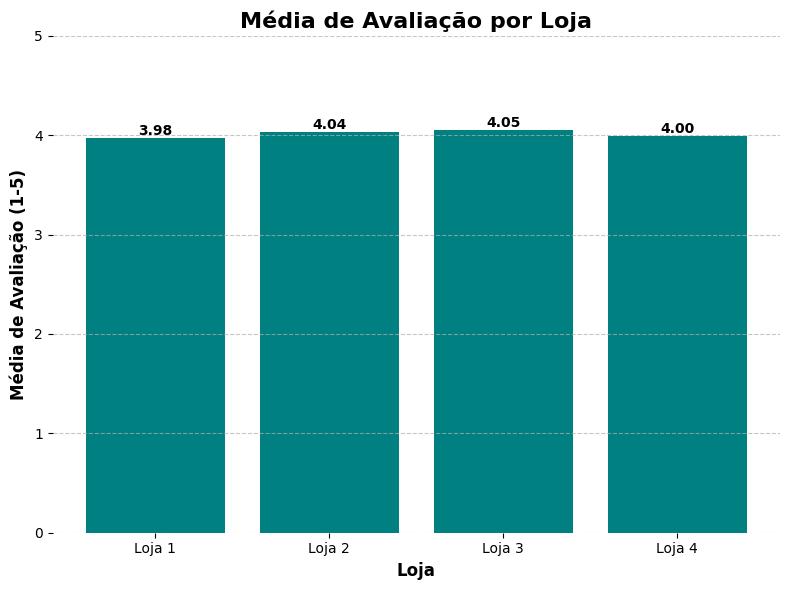


--- Volume de Vendas por Loja (Contagem de Ocorrências) ---
Loja 1: 2359 vendas
Loja 2: 2359 vendas
Loja 3: 2359 vendas
Loja 4: 2358 vendas

Gráfico 'volume_vendas_por_loja_grafico.png' gerado com sucesso.


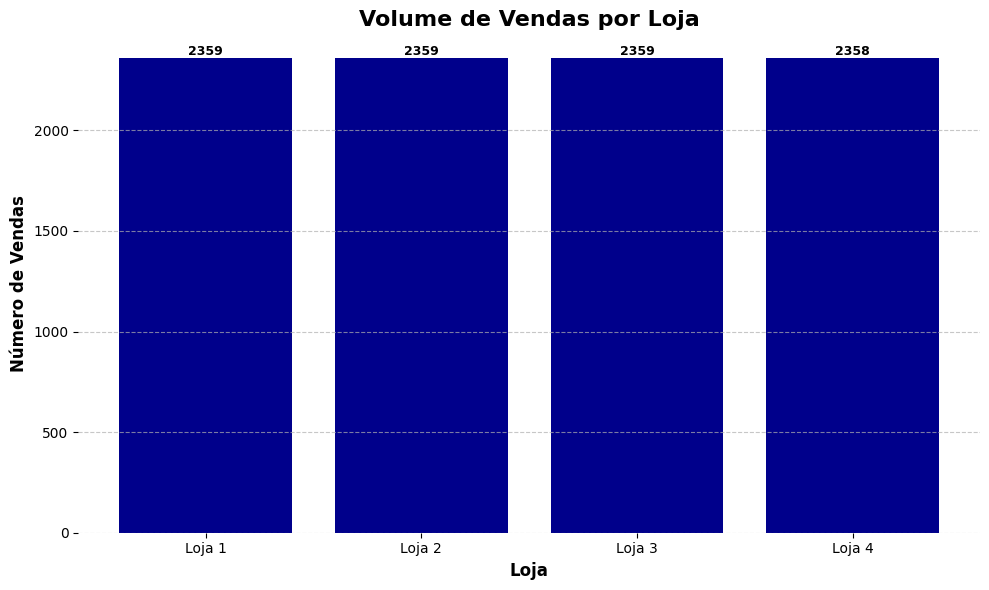


--- Volume de Vendas por Categoria (Produto) ---
Produto: 'Cômoda' - 210 vendas
Produto: 'Carrinho controle remoto' - 206 vendas
Produto: 'Micro-ondas' - 206 vendas
Produto: 'Bateria' - 203 vendas
Produto: 'Cama king' - 201 vendas
Produto: 'Jogo de panelas' - 200 vendas
Produto: 'Modelagem preditiva' - 200 vendas
Produto: 'Secadora de roupas' - 200 vendas
Produto: 'Blocos de montar' - 199 vendas
Produto: 'Cama box' - 199 vendas
Produto: 'Celular Plus X42' - 198 vendas
Produto: 'Bola de basquete' - 197 vendas
Produto: 'Pandeiro' - 197 vendas
Produto: 'Guarda roupas' - 197 vendas
Produto: 'Bicicleta' - 196 vendas
... e mais 36 outros produtos.

Gráfico 'top_15_produtos_volume_vendas_grafico.png' gerado com sucesso.


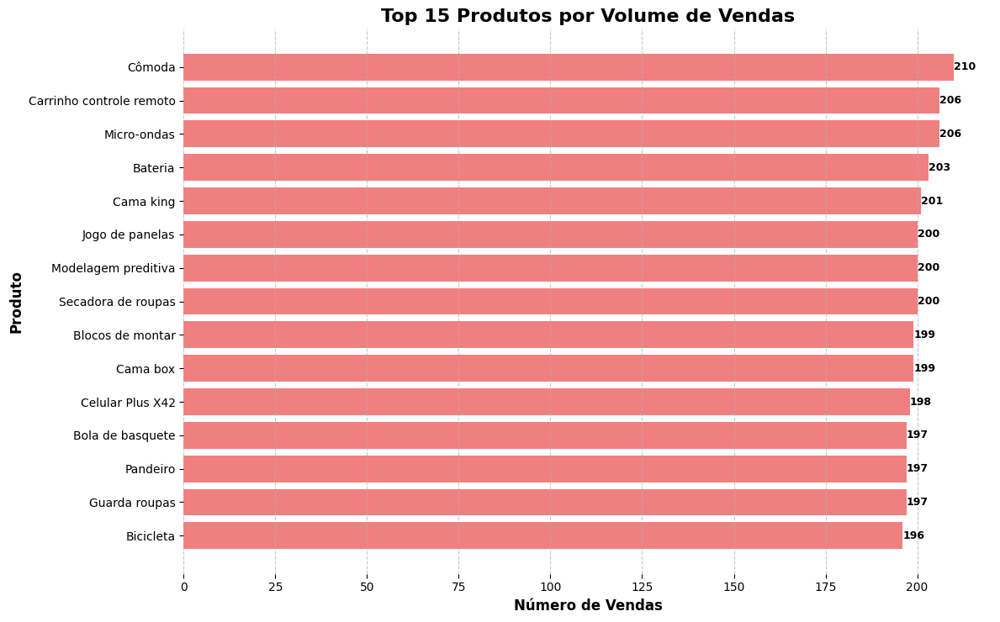


--- 2.4 Análise de Ticket Médio ---
O ticket médio por transação é: R$ 622,31

--- 2.5 Análise de Produtos de Alto e Baixo Desempenho ---

Top 5 Produtos por Faturamento:
- 'TV Led UHD 4K': Faturamento R$ 576.652,70 (Volume: 187 vendas)
- 'Celular Plus X42': Faturamento R$ 534.735,14 (Volume: 198 vendas)
- 'Geladeira': Faturamento R$ 513.249,34 (Volume: 191 vendas)
- 'Smart TV': Faturamento R$ 386.963,12 (Volume: 192 vendas)
- 'Lavadora de roupas': Faturamento R$ 323.292,37 (Volume: 176 vendas)

Top 5 Produtos de Menor Faturamento:
- 'Cubo mágico 8x8': Faturamento R$ 3.638,68 (Volume: 180 vendas)
- 'Corda de pular': Faturamento R$ 4.090,93 (Volume: 186 vendas)
- 'Dinossauro Rex': Faturamento R$ 4.150,53 (Volume: 175 vendas)
- 'Xadrez de madeira': Faturamento R$ 6.865,90 (Volume: 180 vendas)
- 'Jogo de copos': Faturamento R$ 7.445,28 (Volume: 169 vendas)

Top 5 Produtos por Volume de Vendas:
- 'Cômoda': 210 vendas (Faturamento: R$ 77.892,33)
- 'Carrinho controle remoto': 206 vendas (Fa

In [46]:
import pandas as pd
import csv
import requests
import matplotlib.pyplot as plt

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")
# --------------------------------------------------------------------------------------


# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Análise de Dados Consolidados (com PANDAS) ---
print("\n--- Carregando e Consolidando Dados de Vendas ---")

todos_dados_vendas = []
# Primeiro, consolide todos os dados de vendas em uma única lista de dicionários
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url)
    if dados_loja:
        # Adiciona uma coluna 'Loja' a cada registro ANTES de consolidar
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

    # Convertendo 'Preço' e 'Avaliação da compra' para numérico, tratando erros
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')

    # Removendo linhas com valores inválidos que impediriam cálculos
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra'], inplace=True)

    if not df_vendas.empty:
        # --- Análise de Faturamento por Loja ---
        faturamento_por_loja_df = df_vendas.groupby('Loja')['Preço'].sum().reset_index()
        print("\n--- Faturamento por Loja ---")
        for index, row in faturamento_por_loja_df.iterrows():
            print(f"{row['Loja']}: {formatar_moeda_br(row['Preço'])}")

        # --- Análise de Média de Avaliação por Loja ---
        media_avaliacao_por_loja_df = df_vendas.groupby('Loja')['Avaliação da compra'].mean().reset_index()
        print("\n--- Média de Avaliação por Loja ---")
        for index, row in media_avaliacao_por_loja_df.iterrows():
            print(f"{row['Loja']}: {row['Avaliação da compra']:.2f}")

        # --- Geração do Gráfico de Barras de Avaliações por Loja ---
        if not media_avaliacao_por_loja_df.empty:
            plt.figure(figsize=(8, 6))
            plt.bar(media_avaliacao_por_loja_df['Loja'], media_avaliacao_por_loja_df['Avaliação da compra'], color='teal')
            ax = plt.gca()
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            plt.title('Média de Avaliação por Loja', fontsize=16, fontweight='bold')
            plt.xlabel('Loja', fontsize=12, fontweight='bold')
            plt.ylabel('Média de Avaliação (1-5)', fontsize=12, fontweight='bold')
            plt.ylim(0, 5)
            for x_pos, y_val in enumerate(media_avaliacao_por_loja_df['Avaliação da compra']):
                plt.text(x_pos, y_val, f'{y_val:.2f}', ha='center', va='bottom', fontsize=10, fontweight='bold')
            plt.grid(axis='y', linestyle='--', alpha=0.7)
            plt.xticks(rotation=0)
            plt.tight_layout()
            plt.savefig('media_avaliacao_por_loja_grafico_pandas.png')
            print(f"\nGráfico 'media_avaliacao_por_loja_grafico_pandas.png' gerado com sucesso.")
            plt.show()
        else:
            print("\nNão foi possível gerar o gráfico de média de avaliação por loja (DataFrame de médias vazio).")

        # --- Análise de Volume de Vendas por Loja (Contagem de Ocorrências) ---
        volume_vendas_por_loja_df = df_vendas.groupby('Loja').size().reset_index(name='Volume de Vendas')
        volume_vendas_por_loja_df.sort_values(by='Volume de Vendas', ascending=False, inplace=True)
        print("\n--- Volume de Vendas por Loja (Contagem de Ocorrências) ---")
        for index, row in volume_vendas_por_loja_df.iterrows():
            print(f"{row['Loja']}: {row['Volume de Vendas']} vendas")

        # --- Geração do Gráfico de Colunas: Volume de Vendas por Loja ---
        if not volume_vendas_por_loja_df.empty:
            plt.figure(figsize=(10, 6))
            plt.bar(volume_vendas_por_loja_df['Loja'], volume_vendas_por_loja_df['Volume de Vendas'], color='darkblue')
            ax = plt.gca()
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            plt.title('Volume de Vendas por Loja', fontsize=16, fontweight='bold')
            plt.xlabel('Loja', fontsize=12, fontweight='bold')
            plt.ylabel('Número de Vendas', fontsize=12, fontweight='bold')
            for x_pos, y_val in enumerate(volume_vendas_por_loja_df['Volume de Vendas']):
                plt.text(x_pos, y_val, f'{y_val}', ha='center', va='bottom', fontsize=9, fontweight='bold', color='black')
            plt.grid(axis='y', linestyle='--', alpha=0.7)
            plt.xticks(rotation=0)
            plt.tight_layout()
            plt.savefig('volume_vendas_por_loja_grafico.png')
            print(f"\nGráfico 'volume_vendas_por_loja_grafico.png' gerado com sucesso.")
            plt.show()
        else:
            print("\nNão foi possível gerar o gráfico de volume de vendas por loja (DataFrame de volume vazio).")

        # --- Análise de Volume de Vendas por Categoria (Produto) ---
        volume_vendas_por_produto_df = df_vendas.groupby('Produto').size().reset_index(name='Volume de Vendas')
        volume_vendas_por_produto_df.sort_values(by='Volume de Vendas', ascending=False, inplace=True)
        print("\n--- Volume de Vendas por Categoria (Produto) ---")
        N_PRODUTOS_VOLUME = 15
        for index, row in volume_vendas_por_produto_df.head(N_PRODUTOS_VOLUME).iterrows():
            print(f"Produto: '{row['Produto']}' - {row['Volume de Vendas']} vendas")
        if len(volume_vendas_por_produto_df) > N_PRODUTOS_VOLUME:
            print(f"... e mais {len(volume_vendas_por_produto_df) - N_PRODUTOS_VOLUME} outros produtos.")

        # --- Geração do Gráfico de Barras Horizontais: Volume de Vendas por Categoria (Top N) ---
        if not volume_vendas_por_produto_df.empty:
            top_n_volume_produtos = volume_vendas_por_produto_df.head(N_PRODUTOS_VOLUME)
            plt.figure(figsize=(12, max(6, len(top_n_volume_produtos) * 0.5)))
            plt.barh(top_n_volume_produtos['Produto'], top_n_volume_produtos['Volume de Vendas'], color='lightcoral')
            ax = plt.gca()
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            plt.title(f'Top {N_PRODUTOS_VOLUME} Produtos por Volume de Vendas', fontsize=16, fontweight='bold')
            plt.xlabel('Número de Vendas', fontsize=12, fontweight='bold')
            plt.ylabel('Produto', fontsize=12, fontweight='bold')
            for i, (volume_val, produto_nome) in enumerate(zip(top_n_volume_produtos['Volume de Vendas'], top_n_volume_produtos['Produto'])):
                plt.text(volume_val, i, f'{volume_val}', ha='left', va='center', fontsize=9, rotation=0, color='black', fontweight='bold')
            plt.grid(axis='x', linestyle='--', alpha=0.7)
            plt.tight_layout()
            plt.gca().invert_yaxis()
            plt.savefig(f'top_{N_PRODUTOS_VOLUME}_produtos_volume_vendas_grafico.png')
            print(f"\nGráfico 'top_{N_PRODUTOS_VOLUME}_produtos_volume_vendas_grafico.png' gerado com sucesso.")
            plt.show()
        else:
            print("\nNão foi possível gerar o gráfico de volume de vendas por produto (DataFrame de volume vazio).")

        # --- 2.4 Análise de Ticket Médio ---
        print("\n" + "="*50)
        print("--- 2.4 Análise de Ticket Médio ---")
        print("="*50)

        ticket_medio = df_vendas['Preço'].mean()
        print(f"O ticket médio por transação é: {formatar_moeda_br(ticket_medio)}")
        print("="*50)


        # --- 2.5 Análise de Produtos de Alto e Baixo Desempenho ---
        print("\n" + "="*50)
        print("--- 2.5 Análise de Produtos de Alto e Baixo Desempenho ---")
        print("="*50)

        # Re-agrupar para garantir que temos Faturamento e Volume (Contagem) juntos
        desempenho_produtos_df = df_vendas.groupby('Produto').agg(
            Faturamento=('Preço', 'sum'),
            Volume_Vendas=('Produto', 'size') # Contagem de ocorrências para o volume
        ).reset_index()

        N_DESTAQUE = 5 # Quantos produtos destacar (Top/Bottom)

        # Produtos de Alto Desempenho (Faturamento)
        produtos_alto_faturamento = desempenho_produtos_df.sort_values(by='Faturamento', ascending=False).head(N_DESTAQUE)
        print(f"\nTop {N_DESTAQUE} Produtos por Faturamento:")
        for index, row in produtos_alto_faturamento.iterrows():
            print(f"- '{row['Produto']}': Faturamento {formatar_moeda_br(row['Faturamento'])} (Volume: {row['Volume_Vendas']} vendas)")

        # Produtos de Baixo Desempenho (Faturamento)
        produtos_baixo_faturamento = desempenho_produtos_df.sort_values(by='Faturamento', ascending=True).head(N_DESTAQUE)
        print(f"\nTop {N_DESTAQUE} Produtos de Menor Faturamento:")
        for index, row in produtos_baixo_faturamento.iterrows():
            print(f"- '{row['Produto']}': Faturamento {formatar_moeda_br(row['Faturamento'])} (Volume: {row['Volume_Vendas']} vendas)")

        # Produtos de Alto Desempenho (Volume de Vendas)
        produtos_alto_volume = desempenho_produtos_df.sort_values(by='Volume_Vendas', ascending=False).head(N_DESTAQUE)
        print(f"\nTop {N_DESTAQUE} Produtos por Volume de Vendas:")
        for index, row in produtos_alto_volume.iterrows():
            print(f"- '{row['Produto']}': {row['Volume_Vendas']} vendas (Faturamento: {formatar_moeda_br(row['Faturamento'])})")

        # Produtos de Baixo Desempenho (Volume de Vendas)
        produtos_baixo_volume = desempenho_produtos_df.sort_values(by='Volume_Vendas', ascending=True).head(N_DESTAQUE)
        print(f"\nTop {N_DESTAQUE} Produtos de Menor Volume de Vendas:")
        for index, row in produtos_baixo_volume.iterrows():
            print(f"- '{row['Produto']}': {row['Volume_Vendas']} vendas (Faturamento: {formatar_moeda_br(row['Faturamento'])})")

        print("="*50) # Finaliza o bloco de desempenho de produtos

    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")


--- Carregando e Consolidando Dados de Vendas ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Carregando dados da Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Carregando dados da Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

--- Faturamento por Loja ---
Loja 1: R$ 1.534.509,12
Loja 2: R$ 1.488.459,06
Loja 3: R$ 1.464.025,03
Loja 4: R$ 1.384.497,58

--- Média de Avaliação por Loja ---
Loja 1: 3.98
Loja 2: 4.04
Loja 3: 4.05
Loja 4: 4.00

Gráfico 'media_avaliacao_por_loja_grafico_pandas.png' gerado com sucesso.

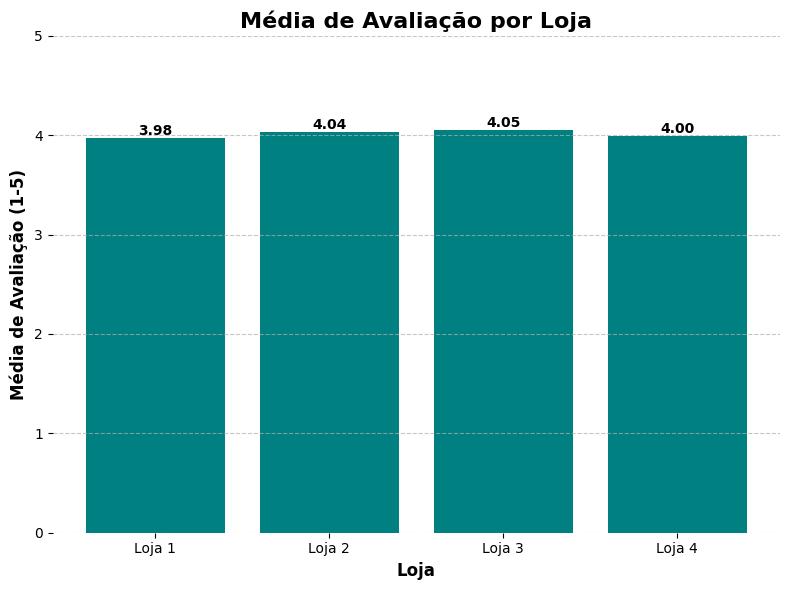


--- Volume de Vendas por Loja (Contagem de Ocorrências) ---
Loja 1: 2359 vendas
Loja 2: 2359 vendas
Loja 3: 2359 vendas
Loja 4: 2358 vendas

Gráfico 'volume_vendas_por_loja_grafico.png' gerado com sucesso.


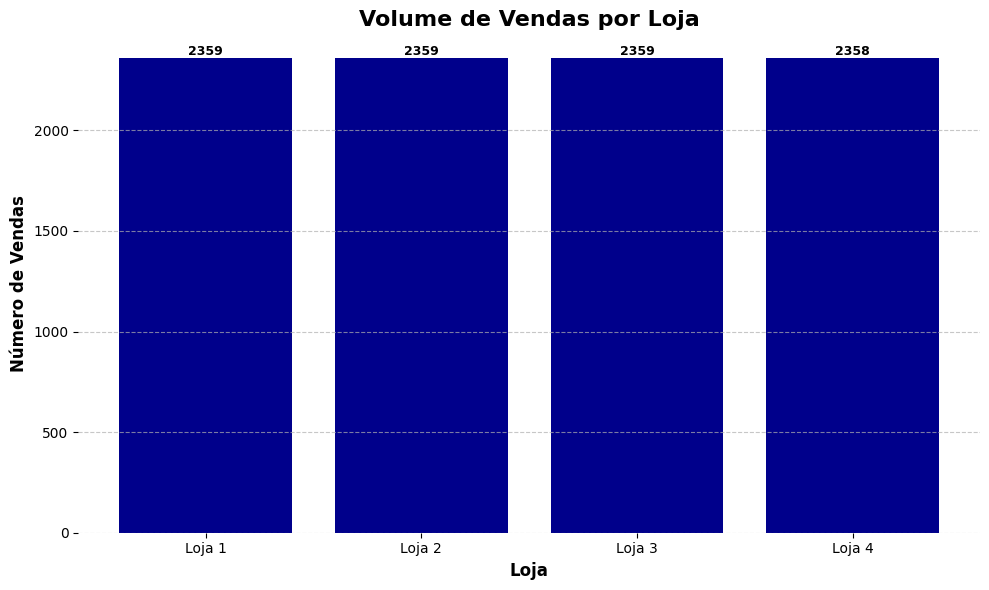


--- Volume de Vendas por Categoria (Produto) ---
Produto: 'Cômoda' - 210 vendas
Produto: 'Carrinho controle remoto' - 206 vendas
Produto: 'Micro-ondas' - 206 vendas
Produto: 'Bateria' - 203 vendas
Produto: 'Cama king' - 201 vendas
Produto: 'Jogo de panelas' - 200 vendas
Produto: 'Modelagem preditiva' - 200 vendas
Produto: 'Secadora de roupas' - 200 vendas
Produto: 'Blocos de montar' - 199 vendas
Produto: 'Cama box' - 199 vendas
Produto: 'Celular Plus X42' - 198 vendas
Produto: 'Bola de basquete' - 197 vendas
Produto: 'Pandeiro' - 197 vendas
Produto: 'Guarda roupas' - 197 vendas
Produto: 'Bicicleta' - 196 vendas
... e mais 36 outros produtos.

Gráfico 'top_15_produtos_volume_vendas_grafico.png' gerado com sucesso.


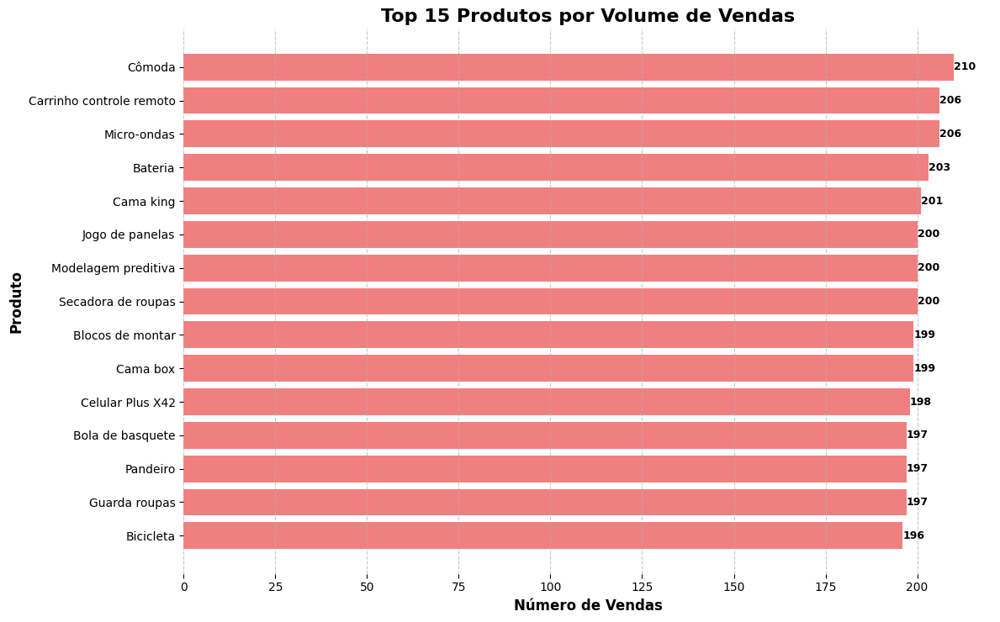


--- 2.4 Análise de Ticket Médio ---
O ticket médio por transação é: R$ 622,31

--- 2.5 Análise de Produtos de Alto e Baixo Desempenho ---

Top 5 Produtos por Faturamento:
- 'TV Led UHD 4K': Faturamento R$ 576.652,70 (Volume: 187 vendas)
- 'Celular Plus X42': Faturamento R$ 534.735,14 (Volume: 198 vendas)
- 'Geladeira': Faturamento R$ 513.249,34 (Volume: 191 vendas)
- 'Smart TV': Faturamento R$ 386.963,12 (Volume: 192 vendas)
- 'Lavadora de roupas': Faturamento R$ 323.292,37 (Volume: 176 vendas)

Top 5 Produtos de Menor Faturamento:
- 'Cubo mágico 8x8': Faturamento R$ 3.638,68 (Volume: 180 vendas)
- 'Corda de pular': Faturamento R$ 4.090,93 (Volume: 186 vendas)
- 'Dinossauro Rex': Faturamento R$ 4.150,53 (Volume: 175 vendas)
- 'Xadrez de madeira': Faturamento R$ 6.865,90 (Volume: 180 vendas)
- 'Jogo de copos': Faturamento R$ 7.445,28 (Volume: 169 vendas)

Top 5 Produtos por Volume de Vendas:
- 'Cômoda': 210 vendas (Faturamento: R$ 77.892,33)
- 'Carrinho controle remoto': 206 vendas (Fa

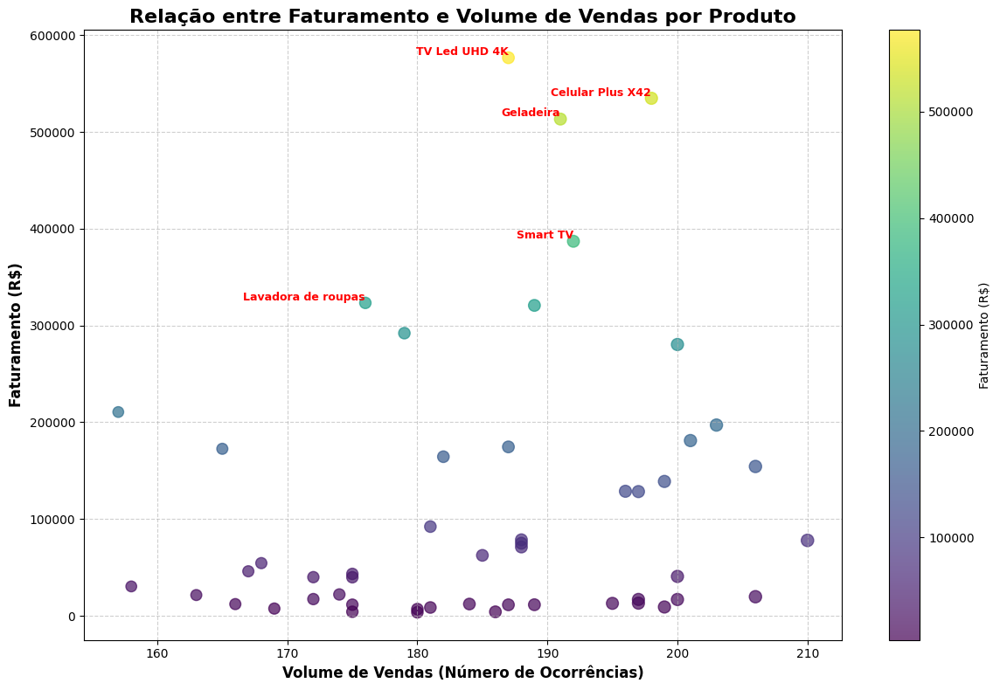

In [47]:
import pandas as pd
import csv
import requests
import matplotlib.pyplot as plt

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")
# --------------------------------------------------------------------------------------


# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Análise de Dados Consolidados (com PANDAS) ---
print("\n--- Carregando e Consolidando Dados de Vendas ---")

todos_dados_vendas = []
# Primeiro, consolide todos os dados de vendas em uma única lista de dicionários
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url)
    if dados_loja:
        # Adiciona uma coluna 'Loja' a cada registro ANTES de consolidar
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

    # Convertendo 'Preço' e 'Avaliação da compra' para numérico, tratando erros
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')

    # Removendo linhas com valores inválidos que impediriam cálculos
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra'], inplace=True)

    if not df_vendas.empty:
        # --- Análise de Faturamento por Loja ---
        faturamento_por_loja_df = df_vendas.groupby('Loja')['Preço'].sum().reset_index()
        print("\n--- Faturamento por Loja ---")
        for index, row in faturamento_por_loja_df.iterrows():
            print(f"{row['Loja']}: {formatar_moeda_br(row['Preço'])}")

        # --- Análise de Média de Avaliação por Loja ---
        media_avaliacao_por_loja_df = df_vendas.groupby('Loja')['Avaliação da compra'].mean().reset_index()
        print("\n--- Média de Avaliação por Loja ---")
        for index, row in media_avaliacao_por_loja_df.iterrows():
            print(f"{row['Loja']}: {row['Avaliação da compra']:.2f}")

        # --- Geração do Gráfico de Barras de Avaliações por Loja ---
        if not media_avaliacao_por_loja_df.empty:
            plt.figure(figsize=(8, 6))
            plt.bar(media_avaliacao_por_loja_df['Loja'], media_avaliacao_por_loja_df['Avaliação da compra'], color='teal')
            ax = plt.gca()
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            plt.title('Média de Avaliação por Loja', fontsize=16, fontweight='bold')
            plt.xlabel('Loja', fontsize=12, fontweight='bold')
            plt.ylabel('Média de Avaliação (1-5)', fontsize=12, fontweight='bold')
            plt.ylim(0, 5)
            for x_pos, y_val in enumerate(media_avaliacao_por_loja_df['Avaliação da compra']):
                plt.text(x_pos, y_val, f'{y_val:.2f}', ha='center', va='bottom', fontsize=10, fontweight='bold')
            plt.grid(axis='y', linestyle='--', alpha=0.7)
            plt.xticks(rotation=0)
            plt.tight_layout()
            plt.savefig('media_avaliacao_por_loja_grafico_pandas.png')
            print(f"\nGráfico 'media_avaliacao_por_loja_grafico_pandas.png' gerado com sucesso.")
            plt.show()
        else:
            print("\nNão foi possível gerar o gráfico de média de avaliação por loja (DataFrame de médias vazio).")

        # --- Análise de Volume de Vendas por Loja (Contagem de Ocorrências) ---
        volume_vendas_por_loja_df = df_vendas.groupby('Loja').size().reset_index(name='Volume de Vendas')
        volume_vendas_por_loja_df.sort_values(by='Volume de Vendas', ascending=False, inplace=True)
        print("\n--- Volume de Vendas por Loja (Contagem de Ocorrências) ---")
        for index, row in volume_vendas_por_loja_df.iterrows():
            print(f"{row['Loja']}: {row['Volume de Vendas']} vendas")

        # --- Geração do Gráfico de Colunas: Volume de Vendas por Loja ---
        if not volume_vendas_por_loja_df.empty:
            plt.figure(figsize=(10, 6))
            plt.bar(volume_vendas_por_loja_df['Loja'], volume_vendas_por_loja_df['Volume de Vendas'], color='darkblue')
            ax = plt.gca()
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            plt.title('Volume de Vendas por Loja', fontsize=16, fontweight='bold')
            plt.xlabel('Loja', fontsize=12, fontweight='bold')
            plt.ylabel('Número de Vendas', fontsize=12, fontweight='bold')
            for x_pos, y_val in enumerate(volume_vendas_por_loja_df['Volume de Vendas']):
                plt.text(x_pos, y_val, f'{y_val}', ha='center', va='bottom', fontsize=9, fontweight='bold', color='black')
            plt.grid(axis='y', linestyle='--', alpha=0.7)
            plt.xticks(rotation=0)
            plt.tight_layout()
            plt.savefig('volume_vendas_por_loja_grafico.png')
            print(f"\nGráfico 'volume_vendas_por_loja_grafico.png' gerado com sucesso.")
            plt.show()
        else:
            print("\nNão foi possível gerar o gráfico de volume de vendas por loja (DataFrame de volume vazio).")

        # --- Análise de Volume de Vendas por Categoria (Produto) ---
        volume_vendas_por_produto_df = df_vendas.groupby('Produto').size().reset_index(name='Volume de Vendas')
        volume_vendas_por_produto_df.sort_values(by='Volume de Vendas', ascending=False, inplace=True)
        print("\n--- Volume de Vendas por Categoria (Produto) ---")
        N_PRODUTOS_VOLUME = 15
        for index, row in volume_vendas_por_produto_df.head(N_PRODUTOS_VOLUME).iterrows():
            print(f"Produto: '{row['Produto']}' - {row['Volume de Vendas']} vendas")
        if len(volume_vendas_por_produto_df) > N_PRODUTOS_VOLUME:
            print(f"... e mais {len(volume_vendas_por_produto_df) - N_PRODUTOS_VOLUME} outros produtos.")

        # --- Geração do Gráfico de Barras Horizontais: Volume de Vendas por Categoria (Top N) ---
        if not volume_vendas_por_produto_df.empty:
            top_n_volume_produtos = volume_vendas_por_produto_df.head(N_PRODUTOS_VOLUME)
            plt.figure(figsize=(12, max(6, len(top_n_volume_produtos) * 0.5)))
            plt.barh(top_n_volume_produtos['Produto'], top_n_volume_produtos['Volume de Vendas'], color='lightcoral')
            ax = plt.gca()
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            plt.title(f'Top {N_PRODUTOS_VOLUME} Produtos por Volume de Vendas', fontsize=16, fontweight='bold')
            plt.xlabel('Número de Vendas', fontsize=12, fontweight='bold')
            plt.ylabel('Produto', fontsize=12, fontweight='bold')
            for i, (volume_val, produto_nome) in enumerate(zip(top_n_volume_produtos['Volume de Vendas'], top_n_volume_produtos['Produto'])):
                plt.text(volume_val, i, f'{volume_val}', ha='left', va='center', fontsize=9, rotation=0, color='black', fontweight='bold')
            plt.grid(axis='x', linestyle='--', alpha=0.7)
            plt.tight_layout()
            plt.gca().invert_yaxis()
            plt.savefig(f'top_{N_PRODUTOS_VOLUME}_produtos_volume_vendas_grafico.png')
            print(f"\nGráfico 'top_{N_PRODUTOS_VOLUME}_produtos_volume_vendas_grafico.png' gerado com sucesso.")
            plt.show()
        else:
            print("\nNão foi possível gerar o gráfico de volume de vendas por produto (DataFrame de volume vazio).")

        # --- 2.4 Análise de Ticket Médio ---
        print("\n" + "="*50)
        print("--- 2.4 Análise de Ticket Médio ---")
        print("="*50)

        ticket_medio = df_vendas['Preço'].mean()
        print(f"O ticket médio por transação é: {formatar_moeda_br(ticket_medio)}")
        print("="*50)


        # --- 2.5 Análise de Produtos de Alto e Baixo Desempenho ---
        print("\n" + "="*50)
        print("--- 2.5 Análise de Produtos de Alto e Baixo Desempenho ---")
        print("="*50)

        # Re-agrupar para garantir que temos Faturamento e Volume (Contagem) juntos
        desempenho_produtos_df = df_vendas.groupby('Produto').agg(
            Faturamento=('Preço', 'sum'),
            Volume_Vendas=('Produto', 'size') # Contagem de ocorrências para o volume
        ).reset_index()

        N_DESTAQUE = 5 # Quantos produtos destacar (Top/Bottom)

        # Produtos de Alto Desempenho (Faturamento)
        produtos_alto_faturamento = desempenho_produtos_df.sort_values(by='Faturamento', ascending=False).head(N_DESTAQUE)
        print(f"\nTop {N_DESTAQUE} Produtos por Faturamento:")
        for index, row in produtos_alto_faturamento.iterrows():
            print(f"- '{row['Produto']}': Faturamento {formatar_moeda_br(row['Faturamento'])} (Volume: {row['Volume_Vendas']} vendas)")

        # Produtos de Baixo Desempenho (Faturamento)
        produtos_baixo_faturamento = desempenho_produtos_df.sort_values(by='Faturamento', ascending=True).head(N_DESTAQUE)
        print(f"\nTop {N_DESTAQUE} Produtos de Menor Faturamento:")
        for index, row in produtos_baixo_faturamento.iterrows():
            print(f"- '{row['Produto']}': Faturamento {formatar_moeda_br(row['Faturamento'])} (Volume: {row['Volume_Vendas']} vendas)")

        # Produtos de Alto Desempenho (Volume de Vendas)
        produtos_alto_volume = desempenho_produtos_df.sort_values(by='Volume_Vendas', ascending=False).head(N_DESTAQUE)
        print(f"\nTop {N_DESTAQUE} Produtos por Volume de Vendas:")
        for index, row in produtos_alto_volume.iterrows():
            print(f"- '{row['Produto']}': {row['Volume_Vendas']} vendas (Faturamento: {formatar_moeda_br(row['Faturamento'])})")

        # Produtos de Baixo Desempenho (Volume de Vendas)
        produtos_baixo_volume = desempenho_produtos_df.sort_values(by='Volume_Vendas', ascending=True).head(N_DESTAQUE)
        print(f"\nTop {N_DESTAQUE} Produtos de Menor Volume de Vendas:")
        for index, row in produtos_baixo_volume.iterrows():
            print(f"- '{row['Produto']}': {row['Volume_Vendas']} vendas (Faturamento: {formatar_moeda_br(row['Faturamento'])})")

        print("="*50) # Finaliza o bloco de desempenho de produtos

        # --- ADIÇÃO: Gráfico de Dispersão (Scatter Plot) para Desempenho de Produtos ---
        print("\n--- Visualização: Faturamento vs. Volume de Vendas por Produto ---")

        plt.figure(figsize=(12, 8))
        # Criando o scatter plot
        # Eixo X: Volume de Vendas
        # Eixo Y: Faturamento
        # c=desempenho_produtos_df['Media_Avaliacao'] (se você tivesse a média de avaliação no df)
        # s=desempenho_produtos_df['Volume_Vendas']*5 (ajuste o tamanho do ponto pelo volume, opcional)
        scatter = plt.scatter(desempenho_produtos_df['Volume_Vendas'],
                              desempenho_produtos_df['Faturamento'],
                              s=desempenho_produtos_df['Volume_Vendas'] * 0.5, # Tamanho do ponto proporcional ao volume
                              alpha=0.7, # Transparência dos pontos
                              c=desempenho_produtos_df['Faturamento'], # Cor baseada no faturamento
                              cmap='viridis') # Mapa de cores (verde para roxo)

        # Adicionando rótulos para alguns produtos de destaque (opcional, para evitar poluir)
        # Por exemplo, rotular os 5 maiores em faturamento
        # Itera sobre os produtos já ordenados por faturamento (produtos_alto_faturamento)
        for index, row in produtos_alto_faturamento.iterrows():
            plt.text(row['Volume_Vendas'], row['Faturamento'], row['Produto'],
                     fontsize=9, ha='right', va='bottom', fontweight='bold', color='red')

        # Títulos e rótulos
        plt.title('Relação entre Faturamento e Volume de Vendas por Produto', fontsize=16, fontweight='bold')
        plt.xlabel('Volume de Vendas (Número de Ocorrências)', fontsize=12, fontweight='bold')
        plt.ylabel('Faturamento (R$)', fontsize=12, fontweight='bold')

        plt.grid(True, linestyle='--', alpha=0.6) # Adiciona grade
        plt.tight_layout() # Ajusta o layout

        # Adicionar barra de cores (colorbar) se estiver usando cores para mapear dados
        plt.colorbar(scatter, label='Faturamento (R$)')

        # Salvar o gráfico
        plt.savefig('faturamento_vs_volume_produtos_scatterplot.png')
        print(f"\nGráfico 'faturamento_vs_volume_produtos_scatterplot.png' gerado com sucesso.")
        plt.show()

        # --- FIM DA ADIÇÃO ---

    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")

# 4. Análise temporal:

Iremos analisar as vendas com o objetivo de encontrar padrões e tendências ao longo do tempo. Para isso, olharemos para os dados a partir da data e hora, consolidando em faturamento mensal, trimestral e anual. Iremos também procurar identificar picos de vendas e realizar comparações entre períodos.

A pasta '../imagens' já existe. Prosseguindo com a geração do gráfico.

Configurações de salvamento de imagens prontas.

--- Carregando e Consolidando Dados de Vendas ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Tentando ler dados da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv
Sucesso: Dados lidos da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Tentando ler dados da URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv
Sucesso: Dados lidos da URL: https://

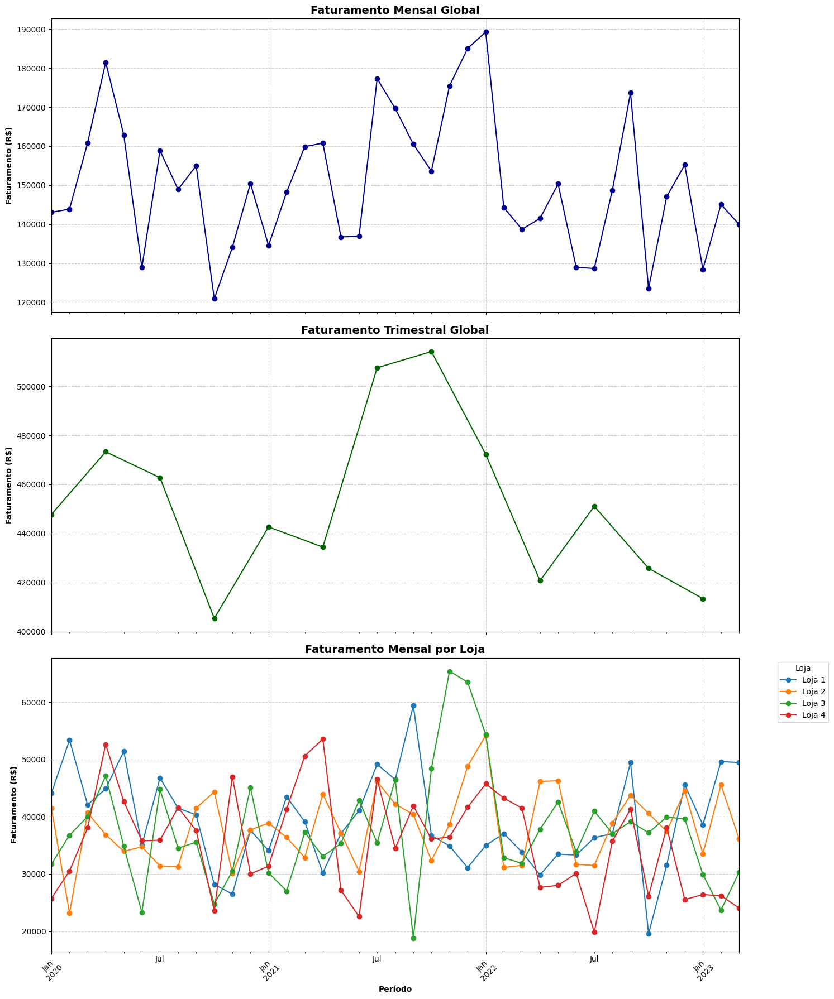


--- 3.2 Análise de Vendas por Dia da Semana ---

Volume de Vendas por Dia da Semana:
- Segunda-feira: 1295 vendas
- Terça-feira: 1319 vendas
- Quarta-feira: 1388 vendas
- Quinta-feira: 1335 vendas
- Sexta-feira: 1396 vendas
- Sábado: 1318 vendas
- Domingo: 1384 vendas

Gráfico 'vendas_por_dia_semana_grafico.png' gerado com sucesso e salvo em '../imagens/vendas_por_dia_semana_grafico.png'.


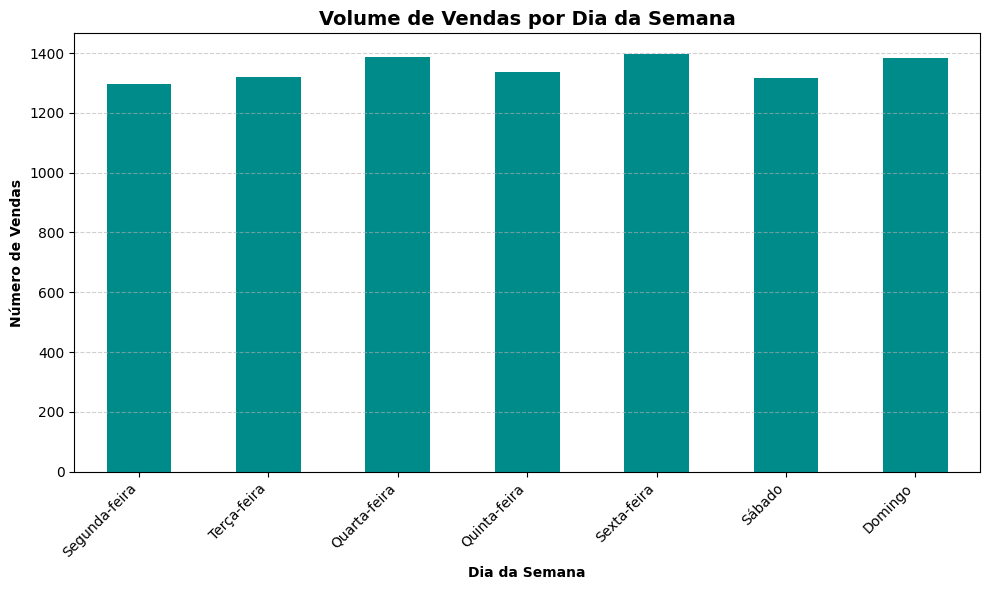


--- 3.3 Comparativo de Períodos ---

--- DEBUG: Verificando faturamento_anual_global ---
Conteúdo de faturamento_anual_global:
Data da Compra
2020    1789272.37
2021    1898820.98
2022    1769933.73
2023     413463.71
Freq: Y-DEC, Name: Preço, dtype: float64
Shape de faturamento_anual_global: (4,)
Índices (anos) presentes: [2020, 2021, 2022, 2023]
--- FIM DOS PRINTS DE DEBUG ---

--- Comparativo Anual de Faturamento Global ---
Faturamento 2021 (R$ 1.898.820,98) vs. 2020 (R$ 1.789.272,37): Variação de 6.12%
Faturamento 2022 (R$ 1.769.933,73) vs. 2021 (R$ 1.898.820,98): Variação de -6.79%
Faturamento 2023 (R$ 413.463,71) vs. 2022 (R$ 1.769.933,73): Variação de -76.64%

--- Comparativo de Faturamento Mensal Médio por Ano ---
Ano           2020       2021       2022       2023
Mes_Num                                            
1        143060.68  134539.67  189308.00  128435.36
2        143867.81  148227.40  144292.72  145069.07
3        160848.48  159902.67  138687.27  139959.28
4      

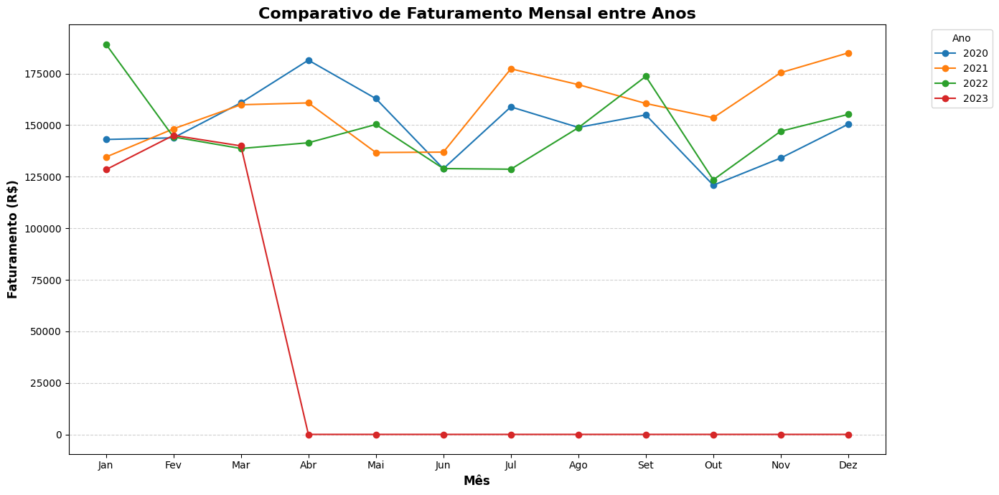

In [60]:
import pandas as pd
import csv
import requests
import matplotlib.pyplot as plt
import os
import io # Importação necessária para ler strings como arquivos CSV


# Configurando o diretório de imagens
# Caminho para a pasta 'imagens' que está na raiz do projeto (se o notebook está em 'notebooks/')
IMAGE_DIR = '../imagens'

if not os.path.exists(IMAGE_DIR):
    os.makedirs(IMAGE_DIR, exist_ok=True)
    print(f"Pasta '{IMAGE_DIR}' criada com sucesso.")
else:
    print(f"A pasta '{IMAGE_DIR}' já existe. Prosseguindo com a geração do gráfico.")

print("\nConfigurações de salvamento de imagens prontas.")

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")
# --------------------------------------------------------------------------------------


# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# **************************************************************************************
# ÚNICA E CORRETA FUNÇÃO LER_CSV (Com lógica de fallback)
# **************************************************************************************
def ler_csv(url, local_path_prefix='../data/raw/'): # Caminho para a pasta 'data/raw/' a partir da raiz do projeto
    dados = []
    file_name = url.split('/')[-1]
    local_file_path = os.path.join(local_path_prefix, file_name)

    # --- TENTATIVA 1: LER DA URL ---
    try:
        print(f"Tentando ler dados da URL: {url}")
        response = requests.get(url, timeout=10)
        response.raise_for_status()

        leitor = csv.DictReader(io.StringIO(response.text))
        for linha in leitor:
            dados.append(linha)
        print(f"Sucesso: Dados lidos da URL: {url}")
        return dados

    except requests.exceptions.RequestException as e: # requests.exceptions.RequestException é a classe base para todos os erros de requests
        print(f"ATENÇÃO: Erro ao ler da URL '{url}': {e}. Tentando arquivo local...")
    except Exception as e:
        print(f"ATENÇÃO: Erro inesperado ao ler da URL '{url}': {e}. Tentando arquivo local...")

    # --- TENTATIVA 2: LER DO ARQUIVO LOCAL (FALLBACK) ---
    if os.path.exists(local_file_path):
        try:
            print(f"Tentando ler dados do arquivo local: {local_file_path}")
            with open(local_file_path, 'r', encoding='utf-8') as f:
                leitor = csv.DictReader(f)
                for linha in leitor:
                    dados.append(linha)
            print(f"Sucesso: Dados lidos do arquivo local: {local_file_path}")
            return dados
        except Exception as e:
            print(f"ERRO: Não foi possível ler do arquivo local '{local_file_path}': {e}")
    else:
        print(f"ERRO: Arquivo local '{local_file_path}' não encontrado para fallback.")

    print(f"Falha total: Não foi possível obter dados para '{file_name}' de nenhuma fonte.")
    return []

# **************************************************************************************
# FIM DA FUNÇÃO LER_CSV
# **************************************************************************************

# --- Carregamento e Pré-processamento Consolidado (com PANDAS) ---
print("\n--- Carregando e Consolidando Dados de Vendas ---")

todos_dados_vendas = []
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url) # Esta chamada usa a função ler_csv com fallback
    if dados_loja:
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

    # Convertendo 'Preço' e 'Avaliação da compra' para numérico, tratando erros
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')

    # Removendo linhas com valores inválidos que impediriam cálculos
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra', 'Data da Compra'], inplace=True)

    # --- Conversão da coluna 'Data da Compra' para datetime ---
    df_vendas['Data da Compra'] = pd.to_datetime(df_vendas['Data da Compra'], format='%d/%m/%Y', errors='coerce')
    df_vendas.dropna(subset=['Data da Compra'], inplace=True) # Remover vendas com datas inválidas
    # ------------------------------------------------------------------

    if not df_vendas.empty:
        print("Dados consolidados e prontos para análise temporal.")

        # --- 3.1 Faturamento Mensal/Trimestral/Anual - Global e por Loja ---
        print("\n" + "="*60)
        print("--- 3.1 Faturamento Mensal/Trimestral/Anual (Global e por Loja) ---")
        print("="*60)

        # Faturamento Mensal Global
        faturamento_mensal_global = df_vendas.groupby(df_vendas['Data da Compra'].dt.to_period('M'))['Preço'].sum()
        print("\nFaturamento Mensal Global:")
        for periodo, faturamento in faturamento_mensal_global.items():
            print(f"- {periodo}: {formatar_moeda_br(faturamento)}")

        # Faturamento Trimestral Global
        faturamento_trimestral_global = df_vendas.groupby(df_vendas['Data da Compra'].dt.to_period('Q'))['Preço'].sum()
        print("\nFaturamento Trimestral Global:")
        for periodo, faturamento in faturamento_trimestral_global.items():
            print(f"- {periodo}: {formatar_moeda_br(faturamento)}")

        # Faturamento Anual Global
        faturamento_anual_global = df_vendas.groupby(df_vendas['Data da Compra'].dt.to_period('Y'))['Preço'].sum()
        print("\nFaturamento Anual Global:")
        for periodo, faturamento in faturamento_anual_global.items():
            print(f"- {periodo}: {formatar_moeda_br(faturamento)}")

        print("\n--- Faturamento Mensal por Loja ---")
        faturamento_mensal_por_loja = df_vendas.groupby(['Loja', df_vendas['Data da Compra'].dt.to_period('M')])['Preço'].sum().unstack(fill_value=0)
        print(faturamento_mensal_por_loja) # Imprime a tabela pivô

        print("\n--- Faturamento Trimestral por Loja ---")
        faturamento_trimestral_por_loja = df_vendas.groupby(['Loja', df_vendas['Data da Compra'].dt.to_period('Q')])['Preço'].sum().unstack(fill_value=0)
        print(faturamento_trimestral_por_loja)

        print("\n--- Faturamento Anual por Loja ---")
        faturamento_anual_por_loja = df_vendas.groupby(['Loja', df_vendas['Data da Compra'].dt.to_period('Y')])['Preço'].sum().unstack(fill_value=0)
        print(faturamento_anual_por_loja)

        # Gráfico de Faturamento Mensal/Trimestral/Anual - Global e por Loja (em um único gráfico)
        print("\n--- Gráfico de Faturamento Temporal (Global e por Loja) ---")

        fig, axes = plt.subplots(3, 1, figsize=(15, 18), sharex='col') # 3 subplots, compartilhando eixo X

        # Gráfico 1: Faturamento Mensal Global
        faturamento_mensal_global.plot(ax=axes[0], kind='line', marker='o', color='darkblue')
        axes[0].set_title('Faturamento Mensal Global', fontsize=14, fontweight='bold')
        axes[0].set_ylabel('Faturamento (R$)', fontsize=10, fontweight='bold')
        axes[0].tick_params(axis='x', rotation=45)
        axes[0].grid(True, linestyle='--', alpha=0.6)
        axes[0].tick_params(axis='x', labelbottom=True)

        # Gráfico 2: Faturamento Trimestral Global
        faturamento_trimestral_global.plot(ax=axes[1], kind='line', marker='o', color='darkgreen')
        axes[1].set_title('Faturamento Trimestral Global', fontsize=14, fontweight='bold')
        axes[1].set_ylabel('Faturamento (R$)', fontsize=10, fontweight='bold')
        axes[1].tick_params(axis='x', rotation=45)
        axes[1].grid(True, linestyle='--', alpha=0.6)
        axes[1].tick_params(axis='x', labelbottom=True)

        # Gráfico 3: Faturamento Mensal por Loja
        faturamento_mensal_por_loja.T.plot(ax=axes[2], kind='line', marker='o') # .T para transpor e ter lojas como colunas
        axes[2].set_title('Faturamento Mensal por Loja', fontsize=14, fontweight='bold')
        axes[2].set_xlabel('Período', fontsize=10, fontweight='bold') # Definir xlabel para o último gráfico
        axes[2].set_ylabel('Faturamento (R$)', fontsize=10, fontweight='bold')
        axes[2].tick_params(axis='x', rotation=45)
        axes[2].legend(title='Loja', bbox_to_anchor=(1.05, 1), loc='upper left') # Legenda fora do gráfico
        axes[2].grid(True, linestyle='--', alpha=0.6)
        axes[2].tick_params(axis='x', labelbottom=True)

        plt.tight_layout() # Ajusta o layout para evitar sobreposição
        save_path_fat_temporal = os.path.join(IMAGE_DIR, 'faturamento_temporal_global_e_por_loja_grafico.png')
        plt.savefig(save_path_fat_temporal)
        print(f"\nGráfico '{os.path.basename(save_path_fat_temporal)}' gerado com sucesso e salvo em '{save_path_fat_temporal}'.")
        plt.show()
        plt.close(fig) # Fecha a figura específica


        # 3.2 Vendas por dia da semana (REMOVIDA ANÁLISE E GRÁFICO POR HORA DO DIA)
        print("\n" + "="*60)
        print("--- 3.2 Análise de Vendas por Dia da Semana ---") # Título ajustado
        print("="*60)

        # Vendas por Dia da Semana
        df_vendas['Dia da Semana'] = df_vendas['Data da Compra'].dt.day_name() # Retorna em inglês (padrão)
        dias_ordem_ingles = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
        dias_pt = ['Segunda-feira', 'Terça-feira', 'Quarta-feira', 'Quinta-feira', 'Sexta-feira', 'Sábado', 'Domingo']
        mapeamento_dias_pt = dict(zip(dias_ordem_ingles, dias_pt))
        df_vendas['Dia da Semana'] = df_vendas['Dia da Semana'].map(mapeamento_dias_pt)

        vendas_por_dia_semana = df_vendas.groupby('Dia da Semana').size().reindex(dias_pt, fill_value=0) # Ordena os dias
        print("\nVolume de Vendas por Dia da Semana:")
        for dia, contagem in vendas_por_dia_semana.items():
            print(f"- {dia}: {contagem} vendas")

        # ************ CÓDIGO DO GRÁFICO POR HORA DO DIA REMOVIDO AQUI ************
        # df_vendas['Hora do Dia'] = df_vendas['Data da Compra'].dt.hour
        # vendas_por_hora_dia = df_vendas.groupby('Hora do Dia').size().reindex(range(24), fill_value=0).sort_index()
        # print("\nVolume de Vendas por Hora do Dia:")
        # for hora, contagem in vendas_por_hora_dia.items():
        #     print(f"- {hora:02d}h: {contagem} vendas")

        # Gráfico de Vendas por Dia da Semana (APENAS ESTE GRÁFICO AGORA)
        fig_dia_semana, ax_dia_semana = plt.subplots(1, 1, figsize=(10, 6)) # Apenas 1 subplot agora

        vendas_por_dia_semana.plot(ax=ax_dia_semana, kind='bar', color='darkcyan')
        ax_dia_semana.set_title('Volume de Vendas por Dia da Semana', fontsize=14, fontweight='bold')
        ax_dia_semana.set_xlabel('Dia da Semana', fontsize=10, fontweight='bold')
        ax_dia_semana.set_ylabel('Número de Vendas', fontsize=10, fontweight='bold')
        ax_dia_semana.set_xticklabels(vendas_por_dia_semana.index, rotation=45, ha='right')
        ax_dia_semana.grid(axis='y', linestyle='--', alpha=0.6)

        plt.tight_layout()
        save_path_vendas_dia_semana = os.path.join(IMAGE_DIR, 'vendas_por_dia_semana_grafico.png')
        plt.savefig(save_path_vendas_dia_semana)
        print(f"\nGráfico '{os.path.basename(save_path_vendas_dia_semana)}' gerado com sucesso e salvo em '{save_path_vendas_dia_semana}'.")
        plt.show()
        plt.close(fig_dia_semana) # Fecha a figura específica


        # 3.3 Comparativo de períodos: Desempenho em relação a meses/trimestres/anos anteriores
        print("\n" + "="*60)
        print("--- 3.3 Comparativo de Períodos ---")
        print("="*60)

        # Exemplo: Comparativo Anual de Faturamento
        # DEBUG PRINTS ADICIONADOS AQUI
        print("\n--- DEBUG: Verificando faturamento_anual_global ---")
        print(f"Conteúdo de faturamento_anual_global:\n{faturamento_anual_global}")
        print(f"Shape de faturamento_anual_global: {faturamento_anual_global.shape}")
        print(f"Índices (anos) presentes: {faturamento_anual_global.index.year.tolist() if not faturamento_anual_global.empty else 'Nenhum'}")
        print("--- FIM DOS PRINTS DE DEBUG ---")

        if faturamento_anual_global.shape[0] > 1:
            print("\n--- Comparativo Anual de Faturamento Global ---")
            for i in range(1, len(faturamento_anual_global)):
                ano_atual = faturamento_anual_global.index[i].year
                ano_anterior = faturamento_anual_global.index[i-1].year
                faturamento_a = faturamento_anual_global.iloc[i]
                faturamento_pa = faturamento_anual_global.iloc[i-1]

                if faturamento_pa > 0:
                    variacao_percentual = ((faturamento_a - faturamento_pa) / faturamento_pa) * 100
                    print(f"Faturamento {ano_atual} ({formatar_moeda_br(faturamento_a)}) vs. {ano_anterior} ({formatar_moeda_br(faturamento_pa)}): Variação de {variacao_percentual:.2f}%")
                else:
                    print(f"Faturamento {ano_atual} ({formatar_moeda_br(faturamento_a)}) vs. {ano_anterior} ({formatar_moeda_br(faturamento_pa)}): Sem base para calcular variação (ano anterior zero).")
        else: # Este else deve capturar o caso de ter 1 ou 0 anos
            print("\nNão há dados suficientes (menos de 2 anos) para um comparativo anual significativo.")


        # Comparativo de Faturamento Mensal Médio por Ano (para ver tendências mensais ao longo dos anos)
        print("\n--- Comparativo de Faturamento Mensal Médio por Ano ---")
        df_vendas['Ano'] = df_vendas['Data da Compra'].dt.year
        df_vendas['Mes_Num'] = df_vendas['Data da Compra'].dt.month

        faturamento_mensal_medio_por_ano = df_vendas.groupby(['Ano', 'Mes_Num'])['Preço'].sum().unstack(level='Ano', fill_value=0)
        print(faturamento_mensal_medio_por_ano)

        # Gráfico de Comparativo de Faturamento Mensal entre Anos
        if not faturamento_mensal_medio_por_ano.empty:
            plt.figure(figsize=(14, 7))
            faturamento_mensal_medio_por_ano.plot(ax=plt.gca(), kind='line', marker='o')

            plt.title('Comparativo de Faturamento Mensal entre Anos', fontsize=16, fontweight='bold')
            plt.xlabel('Mês', fontsize=12, fontweight='bold')
            plt.ylabel('Faturamento (R$)', fontsize=12, fontweight='bold')
            plt.xticks(range(1, 13), ['Jan', 'Fev', 'Mar', 'Abr', 'Mai', 'Jun', 'Jul', 'Ago', 'Set', 'Out', 'Nov', 'Dez'])
            plt.legend(title='Ano', bbox_to_anchor=(1.05, 1), loc='upper left')
            plt.grid(axis='y', linestyle='--', alpha=0.6)
            plt.tight_layout()
            save_path_fat_mensal_comp = os.path.join(IMAGE_DIR, 'faturamento_mensal_comparativo_anual_grafico.png')
            plt.savefig(save_path_fat_mensal_comp)
            print(f"\nGráfico '{os.path.basename(save_path_fat_mensal_comp)}' gerado com sucesso e salvo em '{save_path_fat_mensal_comp}'.")
            plt.show()
            plt.close() # Fecha a figura atual
        else:
            print("\nNão foi possível gerar o gráfico de comparativo mensal anual.")

        print("="*60) # Finaliza a seção de análises temporais

    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")

# 5. Frete Médio por Loja


##5.1. Custo total de frete: **Qual o valor gasto com fretes em todas as vendas.**

In [49]:
import pandas as pd
import csv
import requests
import matplotlib.pyplot as plt

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")
# --------------------------------------------------------------------------------------


# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Carregamento e Pré-processamento Consolidado (com PANDAS) ---
print("\n--- Carregando e Consolidando Dados de Vendas ---")

todos_dados_vendas = []
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url)
    if dados_loja:
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

    # Convertendo 'Preço', 'Avaliação da compra' e 'Frete' para numérico, tratando erros
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')
    df_vendas['Frete'] = pd.to_numeric(df_vendas['Frete'], errors='coerce') # Converte a coluna Frete

    # Removendo linhas com valores inválidos que impediriam cálculos
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra', 'Data da Compra', 'Frete'], inplace=True)

    # Conversão da coluna 'Data da Compra' para datetime
    df_vendas['Data da Compra'] = pd.to_datetime(df_vendas['Data da Compra'], format='%d/%m/%Y', errors='coerce')
    df_vendas.dropna(subset=['Data da Compra'], inplace=True) # Remover vendas com datas inválidas

    if not df_vendas.empty:
        # --- Análise de Custo Total de Frete Global ---
        print("\n" + "="*50)
        print("--- Análise de Custo Total de Frete ---")
        print("="*50)

        custo_total_frete = df_vendas['Frete'].sum()
        print(f"O custo total gasto com fretes em todas as vendas é: {formatar_moeda_br(custo_total_frete)}")
        faturamento_total_global = df_vendas['Preço'].sum()

        if faturamento_total_global > 0:
            participacao_frete_no_faturamento = (custo_total_frete / faturamento_total_global) * 100
            print(f"O custo toal gasto com frete em todas as vendas representa {participacao_frete_no_faturamento:.2f}%.")
        else:
            print("O faturamento total é zero. Não é possível calcular a participação do frete no faturamento.")

        print("="*50) # LInha de finalização

        # Você pode inserir aqui outras análises que já fizemos, ou começar novas seções abaixo.
        # Por exemplo, a análise de Frete Médio por Loja viria logo em seguida.
    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")


--- Carregando e Consolidando Dados de Vendas ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Carregando dados da Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Carregando dados da Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

--- Análise de Custo Total de Frete ---
O custo total gasto com fretes em todas as vendas é: R$ 312.930,66
O custo toal gasto com frete em todas as vendas representa 5.33%.



--- Carregando e Consolidando Dados de Vendas ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Carregando dados da Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Carregando dados da Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

--- Análise de Custo Total de Frete ---
O custo total gasto com fretes em todas as vendas é: R$ 312.930,66
O custo total gasto com fretes em todas as vendas representa 5.33%.

Gráfico 'participacao_frete_faturamento_grafico.png' gerado com sucesso.


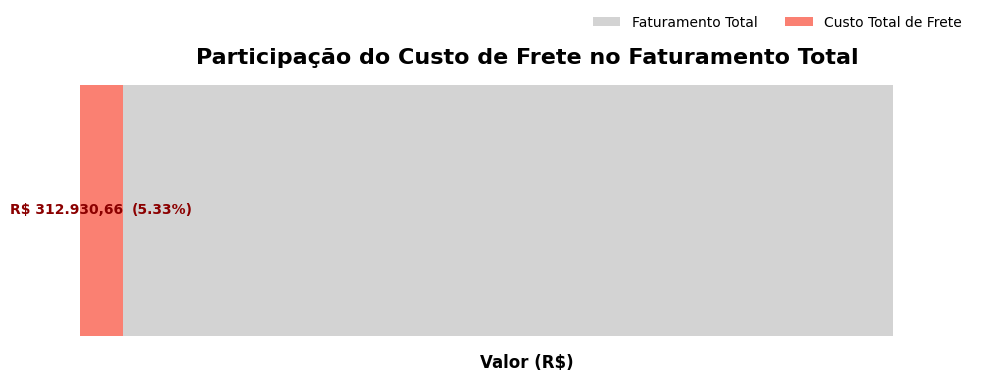

In [50]:
import pandas as pd
import csv
import requests
import matplotlib.pyplot as plt

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")
# --------------------------------------------------------------------------------------


# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Carregamento e Pré-processamento Consolidado (com PANDAS) ---
print("\n--- Carregando e Consolidando Dados de Vendas ---")

todos_dados_vendas = []
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url)
    if dados_loja:
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

    # Convertendo 'Preço', 'Avaliação da compra' e 'Frete' para numérico, tratando erros
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')
    df_vendas['Frete'] = pd.to_numeric(df_vendas['Frete'], errors='coerce') # Converte a coluna Frete

    # Removendo linhas com valores inválidos que impediriam cálculos
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra', 'Data da Compra', 'Frete'], inplace=True)

    # Conversão da coluna 'Data da Compra' para datetime
    df_vendas['Data da Compra'] = pd.to_datetime(df_vendas['Data da Compra'], format='%d/%m/%Y', errors='coerce')
    df_vendas.dropna(subset=['Data da Compra'], inplace=True) # Remover vendas com datas inválidas

    if not df_vendas.empty:
        # --- Análise de Custo Total de Frete Global ---
        print("\n" + "="*50)
        print("--- Análise de Custo Total de Frete ---")
        print("="*50)

        custo_total_frete = df_vendas['Frete'].sum()
        print(f"O custo total gasto com fretes em todas as vendas é: {formatar_moeda_br(custo_total_frete)}")

        faturamento_total_global = df_vendas['Preço'].sum() # Calcula o faturamento total

        participacao_frete_no_faturamento = 0
        if faturamento_total_global > 0:
            participacao_frete_no_faturamento = (custo_total_frete / faturamento_total_global) * 100
            print(f"O custo total gasto com fretes em todas as vendas representa {participacao_frete_no_faturamento:.2f}%.")
        else:
            # --- CORREÇÃO DE SYNTAXERROR AQUI ---
            print("\nNão foi possível gerar o gráfico de participação do frete (Faturamento Total é zero).")
            # --- FIM DA CORREÇÃO ---
        print("="*50)

        # --- Gráfico de Barra com Segmento Percentual para Frete ---
        if faturamento_total_global > 0:
            plt.figure(figsize=(10, 4))

            # A barra principal representa o faturamento total
            plt.barh(['Faturamento Total'], [faturamento_total_global], color='lightgray', height=0.6, label='Faturamento Total')

            # A barra sobreposta representa o custo do frete
            plt.barh(['Faturamento Total'], [custo_total_frete], color='salmon', height=0.6, label='Custo Total de Frete')

            # Adicionar o texto do valor total do frete
            plt.text(custo_total_frete, 0,
                     f"{formatar_moeda_br(custo_total_frete)}",
                     ha='right', va='center', fontsize=10, fontweight='bold', color='darkred')

            # Adicionar o texto da participação percentual
            plt.text(custo_total_frete + (faturamento_total_global * 0.01), 0,
                     f"({participacao_frete_no_faturamento:.2f}%)",
                     ha='left', va='center', fontsize=10, fontweight='bold', color='darkred')

            # Título e Rótulos
            plt.title('Participação do Custo de Frete no Faturamento Total', fontsize=16, fontweight='bold')
            plt.xlabel('Valor (R$)', fontsize=12, fontweight='bold')
            plt.xticks([]) # Oculta os ticks do eixo X, já que a formatação está nos rótulos de texto
            plt.yticks([]) # Oculta os rótulos do eixo Y
            plt.legend(loc='upper right', bbox_to_anchor=(1.0, 1.25), ncol=2, frameon=False) # Legenda no topo

            # Remover as "spines" (bordas) para um visual limpo
            ax = plt.gca()
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['bottom'].set_visible(False)

            plt.xlim(0, faturamento_total_global * 1.1) # Garante espaço para rótulos à direita
            plt.tight_layout()

            # Salvar o gráfico
            plt.savefig('participacao_frete_faturamento_grafico.png')
            print(f"\nGráfico 'participacao_frete_faturamento_grafico.png' gerado com sucesso.")
            plt.show()

        else:
            # --- CORREÇÃO DE SYNTAXERROR AQUI ---
            print("\nNão foi possível gerar o gráfico de participação do frete (Faturamento Total é zero).")
            # --- FIM DA CORREÇÃO ---


    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")

##5.2.Custo médio de frete por venda/produto: **Qual o impacto do frete em cada transação ou item.**


--- Carregando e Consolidando Dados de Vendas ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Carregando dados da Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Carregando dados da Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

--- Análise de Custo Total de Frete ---
O custo total gasto com fretes em todas as vendas é: R$ 312.930,66
O custo total gasto com fretes em todas as vendas representa 5.33%.

Gráfico 'participacao_frete_faturamento_grafico.png' gerado com sucesso.


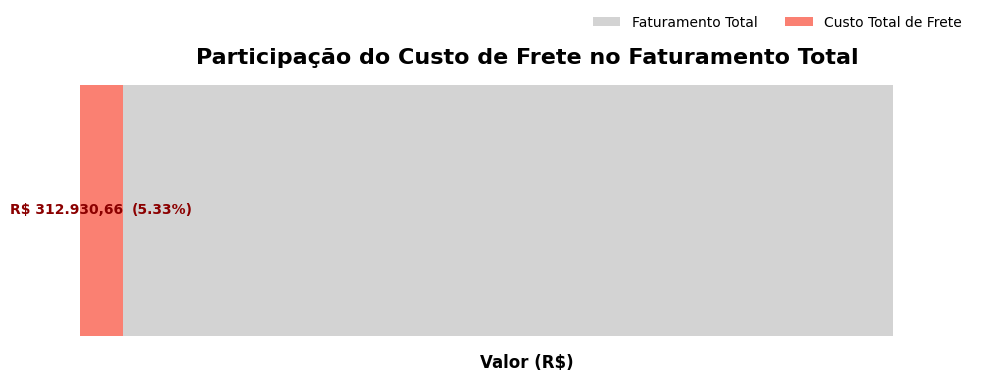


--- Análise de Custo Médio de Frete por Venda e por Produto ---
Custo Médio de Frete por Venda (Transação): R$ 33,17

--- Custo Médio de Frete por Produto ---
Produto: 'TV Led UHD 4K' - Frete Médio: R$ 164,25
Produto: 'Celular Plus X42' - Frete Médio: R$ 144,07
Produto: 'Geladeira' - Frete Médio: R$ 142,79
Produto: 'Smart TV' - Frete Médio: R$ 107,22
Produto: 'Lavadora de roupas' - Frete Médio: R$ 97,64
Produto: 'Lava louças' - Frete Médio: R$ 90,36
Produto: 'Tablet ABXY' - Frete Médio: R$ 87,21
Produto: 'Secadora de roupas' - Frete Médio: R$ 74,63
Produto: 'Celular ABXY' - Frete Médio: R$ 71,44
Produto: 'Guitarra' - Frete Médio: R$ 55,41
... e mais 41 outros produtos.

Gráfico 'top_10_produtos_frete_medio_grafico.png' gerado com sucesso.


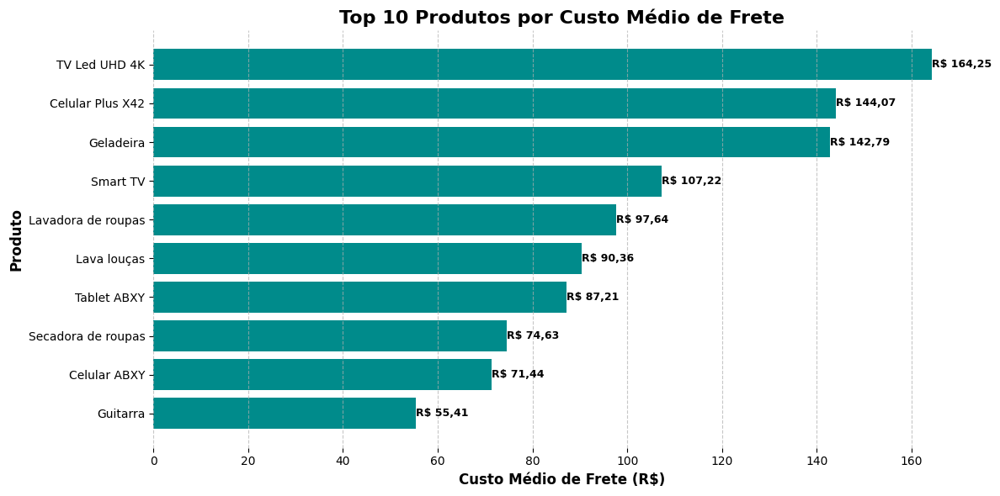

In [51]:
import pandas as pd
import csv
import requests
import matplotlib.pyplot as plt

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")
# --------------------------------------------------------------------------------------


# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Carregamento e Pré-processamento Consolidado (com PANDAS) ---
print("\n--- Carregando e Consolidando Dados de Vendas ---")

todos_dados_vendas = []
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url)
    if dados_loja:
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

    # Convertendo 'Preço', 'Avaliação da compra' e 'Frete' para numérico, tratando erros
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')
    df_vendas['Frete'] = pd.to_numeric(df_vendas['Frete'], errors='coerce') # Converte a coluna Frete

    # Removendo linhas com valores inválidos que impediriam cálculos
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra', 'Data da Compra', 'Frete'], inplace=True)

    # Conversão da coluna 'Data da Compra' para datetime
    df_vendas['Data da Compra'] = pd.to_datetime(df_vendas['Data da Compra'], format='%d/%m/%Y', errors='coerce')
    df_vendas.dropna(subset=['Data da Compra'], inplace=True) # Remover vendas com datas inválidas

    if not df_vendas.empty:
        # --- Análise de Custo Total de Frete Global ---
        print("\n" + "="*50)
        print("--- Análise de Custo Total de Frete ---")
        print("="*50)

        custo_total_frete = df_vendas['Frete'].sum()
        print(f"O custo total gasto com fretes em todas as vendas é: {formatar_moeda_br(custo_total_frete)}")

        faturamento_total_global = df_vendas['Preço'].sum() # Calcula o faturamento total

        participacao_frete_no_faturamento = 0
        if faturamento_total_global > 0:
            participacao_frete_no_faturamento = (custo_total_frete / faturamento_total_global) * 100
            print(f"O custo total gasto com fretes em todas as vendas representa {participacao_frete_no_faturamento:.2f}%.")
        else:
            print("\nNão foi possível calcular a participação percentual do frete (Faturamento Total é zero).")
        print("="*50)

        # --- Gráfico de Barra com Segmento Percentual para Frete ---
        if faturamento_total_global > 0:
            plt.figure(figsize=(10, 4))

            # A barra principal representa o faturamento total
            plt.barh(['Faturamento Total'], [faturamento_total_global], color='lightgray', height=0.6, label='Faturamento Total')

            # A barra sobreposta representa o custo do frete
            plt.barh(['Faturamento Total'], [custo_total_frete], color='salmon', height=0.6, label='Custo Total de Frete')

            # Adicionar o texto do valor total do frete
            plt.text(custo_total_frete, 0,
                     f"{formatar_moeda_br(custo_total_frete)}",
                     ha='right', va='center', fontsize=10, fontweight='bold', color='darkred')

            # Adicionar o texto da participação percentual
            plt.text(custo_total_frete + (faturamento_total_global * 0.01), 0,
                     f"({participacao_frete_no_faturamento:.2f}%)",
                     ha='left', va='center', fontsize=10, fontweight='bold', color='darkred')

            # Título e Rótulos
            plt.title('Participação do Custo de Frete no Faturamento Total', fontsize=16, fontweight='bold')
            plt.xlabel('Valor (R$)', fontsize=12, fontweight='bold')
            plt.xticks([]) # Oculta os ticks do eixo X, já que a formatação está nos rótulos de texto
            plt.yticks([]) # Oculta os rótulos do eixo Y
            plt.legend(loc='upper right', bbox_to_anchor=(1.0, 1.25), ncol=2, frameon=False) # Legenda no topo

            # Remover as "spines" (bordas) para um visual limpo
            ax = plt.gca()
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['bottom'].set_visible(False)

            plt.xlim(0, faturamento_total_global * 1.1) # Garante espaço para rótulos à direita
            plt.tight_layout()

            # Salvar o gráfico
            plt.savefig('participacao_frete_faturamento_grafico.png')
            print(f"\nGráfico 'participacao_frete_faturamento_grafico.png' gerado com sucesso.")
            plt.show()

        else:
            print("\nNão foi possível gerar o gráfico de participação do frete (Faturamento Total é zero).")


    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")

# --- NOVO: Análise de Custo Médio de Frete por Venda e por Produto ---
print("\n" + "="*50)
print("--- Análise de Custo Médio de Frete por Venda e por Produto ---")
print("="*50)

if not df_vendas.empty:
    # --- Custo Médio de Frete por Venda (Transação) ---
    custo_medio_frete_por_venda = df_vendas['Frete'].mean()
    print(f"Custo Médio de Frete por Venda (Transação): {formatar_moeda_br(custo_medio_frete_por_venda)}")

    # --- Custo Médio de Frete por Produto ---
    # Agrupar por produto e calcular a média do frete
    custo_medio_frete_por_produto_df = df_vendas.groupby('Produto')['Frete'].mean().reset_index()

    # Ordenar do produto com maior frete médio para o menor
    custo_medio_frete_por_produto_df.sort_values(by='Frete', ascending=False, inplace=True)

    print("\n--- Custo Médio de Frete por Produto ---")
    N_PRODUTOS_FRETE_MEDIO = 10 # Número de produtos para exibir
    for index, row in custo_medio_frete_por_produto_df.head(N_PRODUTOS_FRETE_MEDIO).iterrows():
        print(f"Produto: '{row['Produto']}' - Frete Médio: {formatar_moeda_br(row['Frete'])}")
    if len(custo_medio_frete_por_produto_df) > N_PRODUTOS_FRETE_MEDIO:
        print(f"... e mais {len(custo_medio_frete_por_produto_df) - N_PRODUTOS_FRETE_MEDIO} outros produtos.")

    # --- Gráfico de Barras Horizontais: Top N Produtos por Custo Médio de Frete ---
    if not custo_medio_frete_por_produto_df.empty:
        top_n_frete_produtos = custo_medio_frete_por_produto_df.head(N_PRODUTOS_FRETE_MEDIO)

        plt.figure(figsize=(12, max(6, len(top_n_frete_produtos) * 0.5)))
        plt.barh(top_n_frete_produtos['Produto'], top_n_frete_produtos['Frete'], color='darkcyan')

        # Remover bordas
        ax = plt.gca()
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['left'].set_visible(False)
        ax.spines['bottom'].set_visible(False)

        # Títulos e rótulos
        plt.title(f'Top {N_PRODUTOS_FRETE_MEDIO} Produtos por Custo Médio de Frete', fontsize=16, fontweight='bold')
        plt.xlabel('Custo Médio de Frete (R$)', fontsize=12, fontweight='bold')
        plt.ylabel('Produto', fontsize=12, fontweight='bold')

        # Adicionar valores sobre as barras
        for i, (frete_val, produto_nome) in enumerate(zip(top_n_frete_produtos['Frete'], top_n_frete_produtos['Produto'])):
            plt.text(frete_val, i, formatar_moeda_br(frete_val), ha='left', va='center', fontsize=9, rotation=0, color='black', fontweight='bold')

        plt.grid(axis='x', linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.gca().invert_yaxis() # Inverte o eixo Y para que o maior valor fique no topo
        plt.savefig(f'top_{N_PRODUTOS_FRETE_MEDIO}_produtos_frete_medio_grafico.png')
        print(f"\nGráfico 'top_{N_PRODUTOS_FRETE_MEDIO}_produtos_frete_medio_grafico.png' gerado com sucesso.")
        plt.show()
    else:
        print("\nNão foi possível gerar o gráfico de custo médio de frete por produto (DataFrame de produtos vazio).")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")

##5.3. Frete por categoria/loja/região: **Existem categorias de produtos, lojas ou regiões específicas que geram custos de frete desproporcionamente altos?**

## Análise detalhada de frete (texto)

In [52]:
import pandas as pd
import csv
import requests
import matplotlib.pyplot as plt
import matplotlib.colors # Importa o módulo colors do matplotlib
import folium
from folium.plugins import HeatMap
import numpy as np
from IPython.display import display # Importa display para renderizar o mapa no Colab

# --- Instalação da biblioteca Folium (execute apenas UMA VEZ) ---
# Se o Colab reclamar que Folium não está instalado, descomente a linha abaixo e execute esta célula.
# !pip install folium

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")

print("Bibliotecas importadas e função utilitária definida.")

# %%
# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Carregamento e Pré-processamento Consolidado (com PANDAS) ---
print("\n--- Carregando e Consolidando Dados de Vendas ---")

todos_dados_vendas = []
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url)
    if dados_loja:
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

df_vendas = pd.DataFrame() # Inicializa df_vendas fora do if para evitar NameError

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

    # Convertendo colunas importantes para numérico, tratando erros
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')
    df_vendas['Frete'] = pd.to_numeric(df_vendas['Frete'], errors='coerce')
    # Conversão de Latitude e Longitude para numérico
    df_vendas['lat'] = pd.to_numeric(df_vendas['lat'], errors='coerce')
    df_vendas['lon'] = pd.to_numeric(df_vendas['lon'], errors='coerce')

    # Removendo linhas com valores inválidos que impediriam cálculos
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra', 'Data da Compra', 'Frete', 'lat', 'lon', 'Categoria do Produto', 'Local da compra'], inplace=True)

    # Conversão da coluna 'Data da Compra' para datetime
    df_vendas['Data da Compra'] = pd.to_datetime(df_vendas['Data da Compra'], format='%d/%m/%Y', errors='coerce')
    df_vendas.dropna(subset=['Data da Compra'], inplace=True) # Remover vendas com datas inválidas

    if not df_vendas.empty:
        print("\nPré-processamento de dados concluído com sucesso.")
    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")



# ### Análise de Frete Detalhada (Texto)

# %%
if not df_vendas.empty:
    print("\n" + "="*50)
    print("--- Análise de Frete Detalhada ---")
    print("="*50)

    # 1. Custo Total de Frete Global
    custo_total_frete = df_vendas['Frete'].sum()
    faturamento_total_global = df_vendas['Preço'].sum()
    participacao_frete_no_faturamento = (custo_total_frete / faturamento_total_global) * 100 if faturamento_total_global > 0 else 0

    print(f"O custo total gasto com fretes em todas as vendas é: {formatar_moeda_br(custo_total_frete)}")
    print(f"Representa {participacao_frete_no_faturamento:.2f}% do faturamento total.")

    # 2. Frete Médio por Loja
    frete_medio_por_loja_df = df_vendas.groupby('Loja')['Frete'].mean().reset_index(name='Frete Médio')
    frete_medio_por_loja_df.sort_values(by='Frete Médio', ascending=False, inplace=True)
    print("\n--- Frete Médio por Loja ---")
    for index, row in frete_medio_por_loja_df.iterrows():
        print(f"- {row['Loja']}: {formatar_moeda_br(row['Frete Médio'])}")

    # 3. Frete Médio por Categoria de Produto
    frete_medio_por_categoria_df = df_vendas.groupby('Categoria do Produto')['Frete'].mean().reset_index(name='Frete Médio')
    frete_medio_por_categoria_df.sort_values(by='Frete Médio', ascending=False, inplace=True)
    print("\n--- Frete Médio por Categoria de Produto ---")
    for index, row in frete_medio_por_categoria_df.iterrows():
        print(f"- '{row['Categoria do Produto']}': {formatar_moeda_br(row['Frete Médio'])}")

    # 4. Frete Médio por Local da Compra (Região/Estado)
    frete_medio_por_local_df = df_vendas.groupby('Local da compra')['Frete'].mean().reset_index(name='Frete Médio')
    frete_medio_por_local_df.sort_values(by='Frete Médio', ascending=False, inplace=True)
    print("\n--- Frete Médio por Local da Compra (Região/Estado) ---")
    # Mostrar top 10 locais com maior frete médio
    N_TOP_LOCALIDADES = 10
    for index, row in frete_medio_por_local_df.head(N_TOP_LOCALIDADES).iterrows():
        print(f"- '{row['Local da compra']}': {formatar_moeda_br(row['Frete Médio'])}")
    if len(frete_medio_por_local_df) > N_TOP_LOCALIDADES:
        print(f"... e mais {len(frete_medio_por_local_df) - N_TOP_LOCALIDADES} outras localidades.")

    print("="*50) # Finaliza a seção de análise de frete
else:
    print("Não há dados para realizar a análise de frete detalhada.")

Bibliotecas importadas e função utilitária definida.

--- Carregando e Consolidando Dados de Vendas ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Carregando dados da Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Carregando dados da Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

Pré-processamento de dados concluído com sucesso.

--- Análise de Frete Detalhada ---
O custo total gasto com fretes em todas as vendas é: R$ 312.930,66
Representa 5.33% do faturamento total.

--- Frete Médio por Loja ---
- Loja 1: R$ 

## Frete Médio por Loja (Matplotlib)

Bibliotecas importadas e função utilitária definida.

--- Carregando e Consolidando Dados de Vendas ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Carregando dados da Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Carregando dados da Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

Pré-processamento de dados concluído com sucesso.

Gráfico 'frete_medio_por_loja_grafico.png' gerado com sucesso.


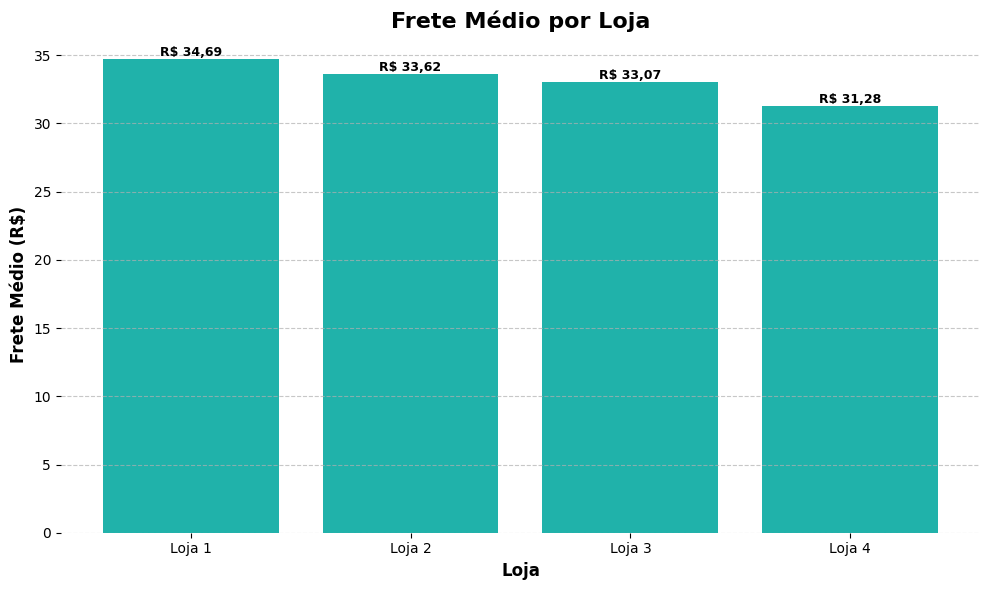

In [53]:
import pandas as pd
import csv
import requests
import matplotlib.pyplot as plt
import matplotlib.colors # Importa o módulo colors do matplotlib
import folium
from folium.plugins import HeatMap
import numpy as np
from IPython.display import display # Importa display para renderizar o mapa no Colab

# --- Instalação da biblioteca Folium (execute apenas UMA VEZ) ---
# Se o Colab reclamar que Folium não está instalado, descomente a linha abaixo e execute esta célula.
# !pip install folium

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")

print("Bibliotecas importadas e função utilitária definida.")

# %%
# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Carregamento e Pré-processamento Consolidado (com PANDAS) ---
print("\n--- Carregando e Consolidando Dados de Vendas ---")

todos_dados_vendas = []
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url)
    if dados_loja:
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

df_vendas = pd.DataFrame() # Inicializa df_vendas fora do if para evitar NameError

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

    # Convertendo colunas importantes para numérico, tratando erros
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')
    df_vendas['Frete'] = pd.to_numeric(df_vendas['Frete'], errors='coerce')
    # Conversão de Latitude e Longitude para numérico
    df_vendas['lat'] = pd.to_numeric(df_vendas['lat'], errors='coerce')
    df_vendas['lon'] = pd.to_numeric(df_vendas['lon'], errors='coerce')

    # Removendo linhas com valores inválidos que impediriam cálculos
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra', 'Data da Compra', 'Frete', 'lat', 'lon', 'Categoria do Produto', 'Local da compra'], inplace=True)

    # Conversão da coluna 'Data da Compra' para datetime
    df_vendas['Data da Compra'] = pd.to_datetime(df_vendas['Data da Compra'], format='%d/%m/%Y', errors='coerce')
    df_vendas.dropna(subset=['Data da Compra'], inplace=True) # Remover vendas com datas inválidas

    if not df_vendas.empty:
        print("\nPré-processamento de dados concluído com sucesso.")
    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")


# ### Gráfico 1 - Frete Médio por Loja (Matplotlib)

# %%
if not df_vendas.empty and 'frete_medio_por_loja_df' in locals() and not frete_medio_por_loja_df.empty:
    plt.figure(figsize=(10, 6))
    plt.bar(frete_medio_por_loja_df['Loja'], frete_medio_por_loja_df['Frete Médio'], color='lightseagreen')
    ax = plt.gca()
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    plt.title('Frete Médio por Loja', fontsize=16, fontweight='bold')
    plt.xlabel('Loja', fontsize=12, fontweight='bold')
    plt.ylabel('Frete Médio (R$)', fontsize=12, fontweight='bold')
    for x_pos, y_val in enumerate(frete_medio_por_loja_df['Frete Médio']):
        plt.text(x_pos, y_val, formatar_moeda_br(y_val), ha='center', va='bottom', fontsize=9, fontweight='bold', color='black')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.xticks(rotation=0)
    plt.tight_layout()
    plt.savefig('frete_medio_por_loja_grafico.png')
    print(f"\nGráfico 'frete_medio_por_loja_grafico.png' gerado com sucesso.")
    plt.show() # Exibe o gráfico

## Frete Médio por Categoria de Produto

Bibliotecas importadas e função utilitária definida.

--- Carregando e Consolidando Dados de Vendas ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Carregando dados da Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Carregando dados da Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

Pré-processamento de dados concluído com sucesso.

Gráfico 'top_10_categorias_frete_medio_grafico.png' gerado com sucesso.


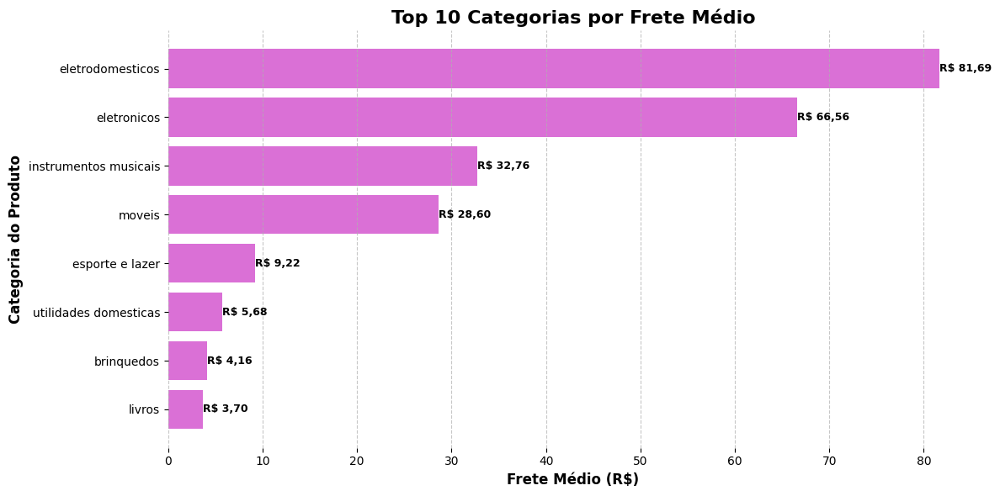

In [54]:
import pandas as pd
import csv
import requests
import matplotlib.pyplot as plt
import matplotlib.colors # Importa o módulo colors do matplotlib
import folium
from folium.plugins import HeatMap
import numpy as np
from IPython.display import display # Importa display para renderizar o mapa no Colab

# --- Instalação da biblioteca Folium (execute apenas UMA VEZ) ---
# Se o Colab reclamar que Folium não está instalado, descomente a linha abaixo e execute esta célula.
# !pip install folium

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")

print("Bibliotecas importadas e função utilitária definida.")

# %%
# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Carregamento e Pré-processamento Consolidado (com PANDAS) ---
print("\n--- Carregando e Consolidando Dados de Vendas ---")

todos_dados_vendas = []
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url)
    if dados_loja:
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

df_vendas = pd.DataFrame() # Inicializa df_vendas fora do if para evitar NameError

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

    # Convertendo colunas importantes para numérico, tratando erros
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')
    df_vendas['Frete'] = pd.to_numeric(df_vendas['Frete'], errors='coerce')
    # Conversão de Latitude e Longitude para numérico
    df_vendas['lat'] = pd.to_numeric(df_vendas['lat'], errors='coerce')
    df_vendas['lon'] = pd.to_numeric(df_vendas['lon'], errors='coerce')

    # Removendo linhas com valores inválidos que impediriam cálculos
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra', 'Data da Compra', 'Frete', 'lat', 'lon', 'Categoria do Produto', 'Local da compra'], inplace=True)

    # Conversão da coluna 'Data da Compra' para datetime
    df_vendas['Data da Compra'] = pd.to_datetime(df_vendas['Data da Compra'], format='%d/%m/%Y', errors='coerce')
    df_vendas.dropna(subset=['Data da Compra'], inplace=True) # Remover vendas com datas inválidas

    if not df_vendas.empty:
        print("\nPré-processamento de dados concluído com sucesso.")
    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")


# ### Gráfico 2 - Frete Médio por Categoria de Produto (Matplotlib)

# %%
if not df_vendas.empty and 'frete_medio_por_categoria_df' in locals() and not frete_medio_por_categoria_df.empty:
    N_TOP_CATEGORIAS_FRETE = 10 # Número de categorias para exibir no gráfico
    top_n_categorias_frete = frete_medio_por_categoria_df.head(N_TOP_CATEGORIAS_FRETE)

    plt.figure(figsize=(12, max(6, len(top_n_categorias_frete) * 0.5)))
    plt.barh(top_n_categorias_frete['Categoria do Produto'], top_n_categorias_frete['Frete Médio'], color='orchid')
    ax = plt.gca()
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    plt.title(f'Top {N_TOP_CATEGORIAS_FRETE} Categorias por Frete Médio', fontsize=16, fontweight='bold')
    plt.xlabel('Frete Médio (R$)', fontsize=12, fontweight='bold')
    plt.ylabel('Categoria do Produto', fontsize=12, fontweight='bold')
    for i, (frete_val, cat_nome) in enumerate(zip(top_n_categorias_frete['Frete Médio'], top_n_categorias_frete['Categoria do Produto'])):
        plt.text(frete_val, i, formatar_moeda_br(frete_val), ha='left', va='center', fontsize=9, rotation=0, color='black', fontweight='bold')
    plt.grid(axis='x', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.gca().invert_yaxis()
    plt.savefig(f'top_{N_TOP_CATEGORIAS_FRETE}_categorias_frete_medio_grafico.png')
    print(f"\nGráfico 'top_{N_TOP_CATEGORIAS_FRETE}_categorias_frete_medio_grafico.png' gerado com sucesso.")
    plt.show() # Exibe o gráfico

## Frete Médio por Local da Compra

Bibliotecas importadas e função utilitária definida.

--- Carregando e Consolidando Dados de Vendas ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Carregando dados da Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Carregando dados da Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

Pré-processamento de dados concluído com sucesso.

Gráfico 'top_10_locais_frete_medio_grafico.png' gerado com sucesso.


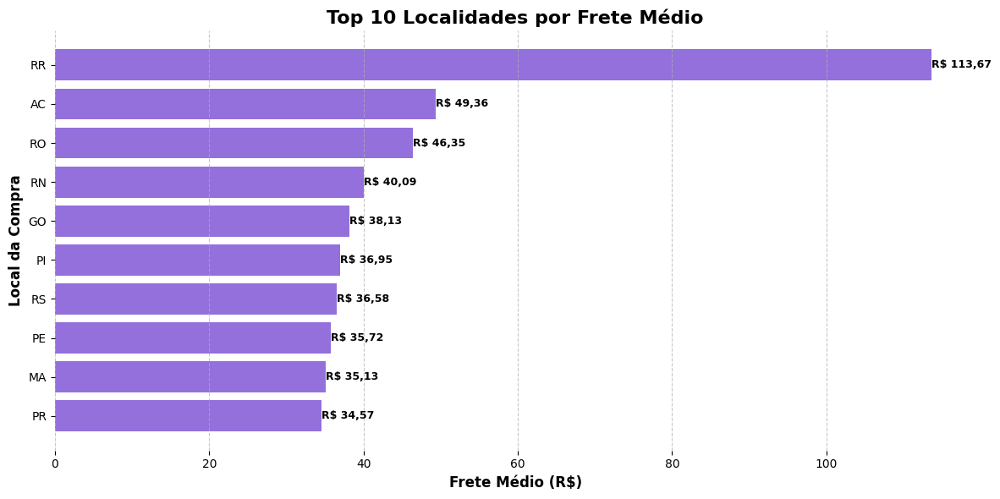

In [55]:
import pandas as pd
import csv
import requests
import matplotlib.pyplot as plt
import matplotlib.colors # Importa o módulo colors do matplotlib
import folium
from folium.plugins import HeatMap
import numpy as np
from IPython.display import display # Importa display para renderizar o mapa no Colab

# --- Instalação da biblioteca Folium (execute apenas UMA VEZ) ---
# Se o Colab reclamar que Folium não está instalado, descomente a linha abaixo e execute esta célula.
# !pip install folium

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")

print("Bibliotecas importadas e função utilitária definida.")

# %%
# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Carregamento e Pré-processamento Consolidado (com PANDAS) ---
print("\n--- Carregando e Consolidando Dados de Vendas ---")

todos_dados_vendas = []
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url)
    if dados_loja:
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

df_vendas = pd.DataFrame() # Inicializa df_vendas fora do if para evitar NameError

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

    # Convertendo colunas importantes para numérico, tratando erros
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')
    df_vendas['Frete'] = pd.to_numeric(df_vendas['Frete'], errors='coerce')
    # Conversão de Latitude e Longitude para numérico
    df_vendas['lat'] = pd.to_numeric(df_vendas['lat'], errors='coerce')
    df_vendas['lon'] = pd.to_numeric(df_vendas['lon'], errors='coerce')

    # Removendo linhas com valores inválidos que impediriam cálculos
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra', 'Data da Compra', 'Frete', 'lat', 'lon', 'Categoria do Produto', 'Local da compra'], inplace=True)

    # Conversão da coluna 'Data da Compra' para datetime
    df_vendas['Data da Compra'] = pd.to_datetime(df_vendas['Data da Compra'], format='%d/%m/%Y', errors='coerce')
    df_vendas.dropna(subset=['Data da Compra'], inplace=True) # Remover vendas com datas inválidas

    if not df_vendas.empty:
        print("\nPré-processamento de dados concluído com sucesso.")
    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")


# ### Gráfico 3 - Frete Médio por Local da Compra (Matplotlib)

# %%
if not df_vendas.empty and 'frete_medio_por_local_df' in locals() and not frete_medio_por_local_df.empty:
    N_TOP_LOCAIS_FRETE = 10 # Número de localidades para exibir no gráfico
    top_n_locais_frete = frete_medio_por_local_df.head(N_TOP_LOCAIS_FRETE)

    plt.figure(figsize=(12, max(6, len(top_n_locais_frete) * 0.5)))
    plt.barh(top_n_locais_frete['Local da compra'], top_n_locais_frete['Frete Médio'], color='mediumpurple')
    ax = plt.gca()
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    plt.title(f'Top {N_TOP_LOCAIS_FRETE} Localidades por Frete Médio', fontsize=16, fontweight='bold')
    plt.xlabel('Frete Médio (R$)', fontsize=12, fontweight='bold')
    plt.ylabel('Local da Compra', fontsize=12, fontweight='bold')
    for i, (frete_val, local_nome) in enumerate(zip(top_n_locais_frete['Frete Médio'], top_n_locais_frete['Local da compra'])):
        plt.text(frete_val, i, formatar_moeda_br(frete_val), ha='left', va='center', fontsize=9, rotation=0, color='black', fontweight='bold')
    plt.grid(axis='x', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.gca().invert_yaxis()
    plt.savefig(f'top_{N_TOP_LOCAIS_FRETE}_locais_frete_medio_grafico.png')
    print(f"\nGráfico 'top_{N_TOP_LOCAIS_FRETE}_locais_frete_medio_grafico.png' gerado com sucesso.")
    plt.show() # Exibe o gráfico

## Gráfico Geográfico (sem mapa de fundo) do frete médio por localidade

Bibliotecas importadas e função utilitária definida.

--- Carregando e Consolidando Dados de Vendas ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Carregando dados da Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Carregando dados da Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

Pré-processamento de dados concluído com sucesso.

Gráfico 'custo_frete_por_localizacao_grafico.png' (Matplotlib) gerado com sucesso.


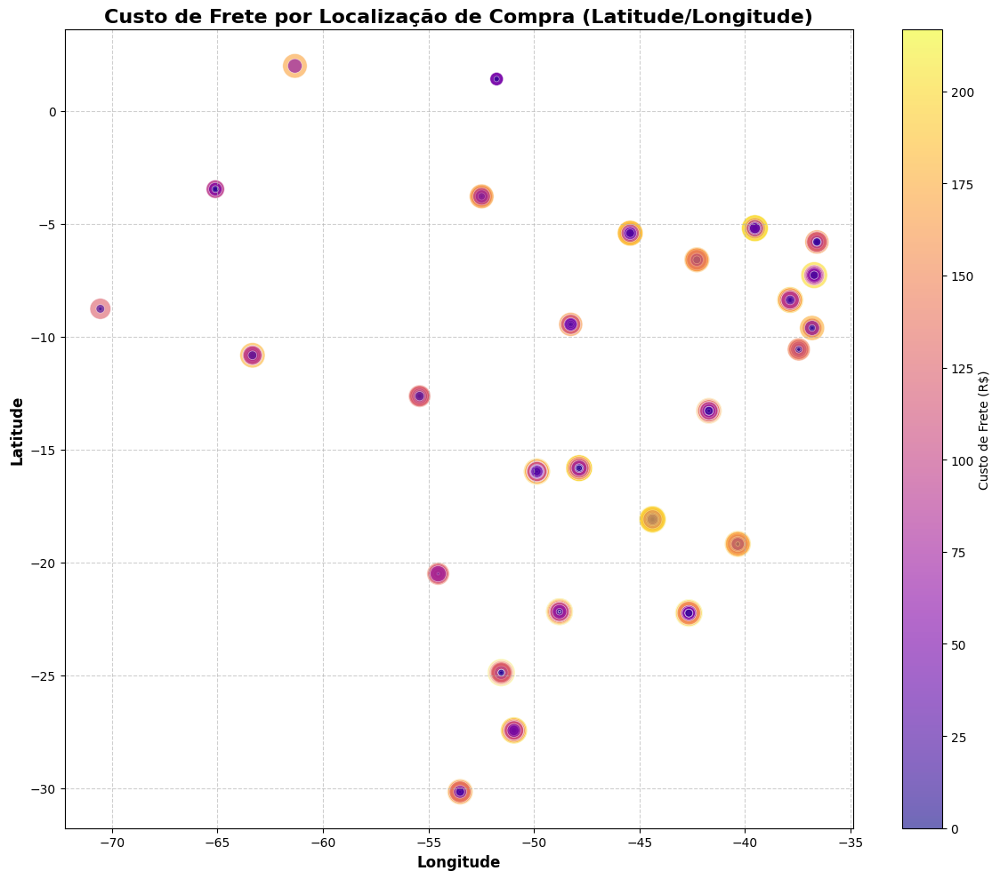

In [56]:
import pandas as pd
import csv
import requests
import matplotlib.pyplot as plt
import matplotlib.colors # Importa o módulo colors do matplotlib
import folium
from folium.plugins import HeatMap
import numpy as np
from IPython.display import display # Importa display para renderizar o mapa no Colab

# --- Instalação da biblioteca Folium (execute apenas UMA VEZ) ---
# Se o Colab reclamar que Folium não está instalado, descomente a linha abaixo e execute esta célula.
# !pip install folium

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")

print("Bibliotecas importadas e função utilitária definida.")

# %%
# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Carregamento e Pré-processamento Consolidado (com PANDAS) ---
print("\n--- Carregando e Consolidando Dados de Vendas ---")

todos_dados_vendas = []
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url)
    if dados_loja:
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

df_vendas = pd.DataFrame() # Inicializa df_vendas fora do if para evitar NameError

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

    # Convertendo colunas importantes para numérico, tratando erros
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')
    df_vendas['Frete'] = pd.to_numeric(df_vendas['Frete'], errors='coerce')
    # Conversão de Latitude e Longitude para numérico
    df_vendas['lat'] = pd.to_numeric(df_vendas['lat'], errors='coerce')
    df_vendas['lon'] = pd.to_numeric(df_vendas['lon'], errors='coerce')

    # Removendo linhas com valores inválidos que impediriam cálculos
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra', 'Data da Compra', 'Frete', 'lat', 'lon', 'Categoria do Produto', 'Local da compra'], inplace=True)

    # Conversão da coluna 'Data da Compra' para datetime
    df_vendas['Data da Compra'] = pd.to_datetime(df_vendas['Data da Compra'], format='%d/%m/%Y', errors='coerce')
    df_vendas.dropna(subset=['Data da Compra'], inplace=True) # Remover vendas com datas inválidas

    if not df_vendas.empty:
        print("\nPré-processamento de dados concluído com sucesso.")
    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")

# ### Gráfico Geográfico (Matplotlib - sem mapa de fundo)

# %%
if not df_vendas.empty and 'lat' in df_vendas.columns and 'lon' in df_vendas.columns:
    s_scale_factor = 50
    if df_vendas['Frete'].max() > 0:
        s_scale_factor = (500 / df_vendas['Frete'].max()) if df_vendas['Frete'].max() > 0 else 50

    plt.figure(figsize=(12, 10))
    scatter_geo = plt.scatter(df_vendas['lon'], df_vendas['lat'],
                            s=df_vendas['Frete'] * s_scale_factor,
                            c=df_vendas['Frete'],
                            cmap='plasma',
                            alpha=0.6,
                            edgecolors='w',
                            linewidth=0.5)

    plt.title('Custo de Frete por Localização de Compra (Latitude/Longitude)', fontsize=16, fontweight='bold')
    plt.xlabel('Longitude', fontsize=12, fontweight='bold')
    plt.ylabel('Latitude', fontsize=12, fontweight='bold')

    plt.grid(True, linestyle='--', alpha=0.6)
    plt.colorbar(scatter_geo, label='Custo de Frete (R$)')
    plt.tight_layout()

    plt.savefig('custo_frete_por_localizacao_grafico.png')
    print(f"\nGráfico 'custo_frete_por_localizacao_grafico.png' (Matplotlib) gerado com sucesso.")
    plt.show() # Exibe o gráfico

else:
    print("\nNão foi possível gerar o gráfico de frete por localização (dados de lat/lon ausentes ou vazios).")

## Custo médio do frete plotado no mapa

In [57]:
import pandas as pd
import csv
import requests
import matplotlib.pyplot as plt
import matplotlib.colors # Importa o módulo colors do matplotlib
import folium
from folium.plugins import HeatMap
import numpy as np
from IPython.display import display # Importa display para renderizar o mapa no Colab

# --- Instalação da biblioteca Folium (execute apenas UMA VEZ) ---
# Se o Colab reclamar que Folium não está instalado, descomente a linha abaixo e execute esta célula.
# !pip install folium

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")

print("Bibliotecas importadas e função utilitária definida.")

# %%
# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Carregamento e Pré-processamento Consolidado (com PANDAS) ---
print("\n--- Carregando e Consolidando Dados de Vendas ---")

todos_dados_vendas = []
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url)
    if dados_loja:
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

df_vendas = pd.DataFrame() # Inicializa df_vendas fora do if para evitar NameError

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

    # Convertendo colunas importantes para numérico, tratando erros
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')
    df_vendas['Frete'] = pd.to_numeric(df_vendas['Frete'], errors='coerce')
    # Conversão de Latitude e Longitude para numérico
    df_vendas['lat'] = pd.to_numeric(df_vendas['lat'], errors='coerce')
    df_vendas['lon'] = pd.to_numeric(df_vendas['lon'], errors='coerce')

    # Removendo linhas com valores inválidos que impediriam cálculos
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra', 'Data da Compra', 'Frete', 'lat', 'lon', 'Categoria do Produto', 'Local da compra'], inplace=True)

    # Conversão da coluna 'Data da Compra' para datetime
    df_vendas['Data da Compra'] = pd.to_datetime(df_vendas['Data da Compra'], format='%d/%m/%Y', errors='coerce')
    df_vendas.dropna(subset=['Data da Compra'], inplace=True) # Remover vendas com datas inválidas

    if not df_vendas.empty:
        print("\nPré-processamento de dados concluído com sucesso.")
    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")


# ### Mapa Interativo com Folium (Mapa Real)

# %%
print("\n" + "="*50)
print("--- Visualização Geográfica com Mapa Real (Folium) ---")
print("="*50)

if not df_vendas.empty and 'lat' in df_vendas.columns and 'lon' in df_vendas.columns:
    # Filtrar NaNs nas coordenadas antes de usar no Folium
    df_mapa = df_vendas.dropna(subset=['lat', 'lon', 'Frete']).copy()

    if not df_mapa.empty:
        # Calcular a média das coordenadas para centrar o mapa
        lat_central = df_mapa['lat'].mean()
        lon_central = df_mapa['lon'].mean()

        # Criar o mapa base
        mapa_frete = folium.Map(location=[lat_central, lon_central], zoom_start=4, tiles='OpenStreetMap')

        # Normalizar o valor do frete para escalar o raio dos círculos e as cores
        max_frete = df_mapa['Frete'].max()
        min_frete = df_mapa['Frete'].min()
        frete_range = max_frete - min_frete if (max_frete - min_frete) > 0 else 1

        # Definir uma escala de cores (ex: plasma do matplotlib adaptada para folium)
        cmap = plt.colormaps.get_cmap('plasma') # Obtém o mapa de cores 'plasma'
        norm = plt.Normalize(vmin=min_frete, vmax=max_frete) # Normaliza os dados para o cmap

        for idx, row in df_mapa.iterrows():
            lat = row['lat']
            lon = row['lon']
            frete = row['Frete']
            local = row['Local da compra']
            categoria = row['Categoria do Produto']
            preco = row['Preço']

            # Raio do círculo baseado no frete (ajustar o multiplicador conforme necessidade)
            radius = (frete - min_frete) / frete_range * 20 + 5 if frete_range > 0 else 10
            if radius == 0: radius = 5

            # Cor do círculo usando o mapa de cores 'plasma'
            rgba_color = cmap(norm(frete)) # Retorna RGBA (0-1)
            hex_color = matplotlib.colors.rgb2hex(rgba_color[:3]) # Converte RGBA para HEX para Folium

            # Conteúdo do popup ao clicar na bolha
            popup_html = f"""
            <b>Local:</b> {local}<br>
            <b>Categoria:</b> {categoria}<br>
            <b>Custo de Frete:</b> {formatar_moeda_br(frete)}<br>
            <b>Preço do Produto:</b> {formatar_moeda_br(preco)}
            """

            folium.CircleMarker(
                location=[lat, lon],
                radius=radius,
                color=hex_color, # Cor da borda
                fill=True,
                fill_color=hex_color, # Cor de preenchimento
                fill_opacity=0.7, # Transparência do preenchimento
                popup=folium.Popup(popup_html, max_width=300) # Adiciona popup com informações
            ).add_to(mapa_frete)

        # Opcional: Adicionar um mapa de calor real (densidade) para o frete
        # dados_heatmap = df_mapa[['lat', 'lon', 'Frete']].values.tolist()
        # HeatMap(dados_heatmap).add_to(mapa_frete)

        # Exibir o mapa no Colab
        print("Mapa interativo de frete por localização gerado com Folium:")
        display(mapa_frete) # Usar display para renderizar o mapa no Colab
        # mapa_frete.save('custo_frete_por_localizacao_mapa_folium.html') # Salvar como HTML
        # print(f"\nMapa 'custo_frete_por_localizacao_mapa_folium.html' gerado com sucesso.")

    else:
        print("\nApós a limpeza, não há dados de lat/lon válidos para gerar o mapa Folium.")
else:
    print("\nNão foi possível gerar o mapa de frete por localização (dados de lat/lon ausentes ou vazios).")

Bibliotecas importadas e função utilitária definida.

--- Carregando e Consolidando Dados de Vendas ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Carregando dados da Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Carregando dados da Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

Pré-processamento de dados concluído com sucesso.

--- Visualização Geográfica com Mapa Real (Folium) ---
Mapa interativo de frete por localização gerado com Folium:


##5.4. Impacto do frete no faturamento líquido: **como o custo do frete afeta a margem de lucro.**

In [58]:
import pandas as pd
import csv
import requests
import matplotlib.pyplot as plt
import matplotlib.colors # Importa o módulo colors do matplotlib
import folium
from folium.plugins import HeatMap
import numpy as np
from IPython.display import display # Importa display para renderizar o mapa no Colab

# --- Instalação da biblioteca Folium (execute apenas UMA VEZ) ---
# Se o Colab reclamar que Folium não está instalado, descomente a linha abaixo e execute esta célula.
# !pip install folium

# --- Função de Formatação de Moeda Personalizada ---
def formatar_moeda_br(valor):
    """Formata um valor numérico para o formato de moeda brasileira (R$ X.XXX.XXX,XX)."""
    valor = float(valor)
    return f"R$ {valor:,.2f}".replace(",", "X").replace(".", ",").replace("X", ".")

print("Bibliotecas importadas e função utilitária definida.")

# %%
# Define URLs for CSV files
urls = [
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv",
    "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv"
]

# Lendo CSV das URLs usando requests
def ler_csv(url):
    dados = []
    try:
        response = requests.get(url)
        response.raise_for_status() # Raise an HTTPError for bad responses (4xx or 5xx)
        linhas = response.text.splitlines()
        leitor = csv.DictReader(linhas)
        for linha in leitor:
            dados.append(linha)
    except requests.exceptions.RequestException as e:
        print(f"Erro ao ler o CSV da URL {url} usando requests: {e}")
    except Exception as e:
        print(f"Erro inesperado ao ler o CSV da URL {url}: {e}")
    return dados

# --- Carregamento e Pré-processamento Consolidado (com PANDAS) ---
print("\n--- Carregando e Consolidando Dados de Vendas ---")

todos_dados_vendas = []
for i, url in enumerate(urls):
    nome_loja = f"Loja {i + 1}"
    print(f"Carregando dados da {nome_loja} (URL: {url})...")
    dados_loja = ler_csv(url)
    if dados_loja:
        for venda in dados_loja:
            venda['Loja'] = nome_loja
        todos_dados_vendas.extend(dados_loja)
    else:
        print(f"Nenhum dado carregado para a {nome_loja}.")
print("---")

df_vendas = pd.DataFrame() # Inicializa df_vendas fora do if para evitar NameError

if todos_dados_vendas:
    df_vendas = pd.DataFrame(todos_dados_vendas)

    # Convertendo colunas importantes para numérico, tratando erros
    df_vendas['Preço'] = pd.to_numeric(df_vendas['Preço'], errors='coerce')
    df_vendas['Avaliação da compra'] = pd.to_numeric(df_vendas['Avaliação da compra'], errors='coerce')
    df_vendas['Frete'] = pd.to_numeric(df_vendas['Frete'], errors='coerce')
    # Conversão de Latitude e Longitude para numérico
    df_vendas['lat'] = pd.to_numeric(df_vendas['lat'], errors='coerce')
    df_vendas['lon'] = pd.to_numeric(df_vendas['lon'], errors='coerce')

    # Removendo linhas com valores inválidos que impediriam cálculos
    df_vendas.dropna(subset=['Preço', 'Avaliação da compra', 'Data da Compra', 'Frete', 'lat', 'lon', 'Categoria do Produto', 'Local da compra'], inplace=True)

    # Conversão da coluna 'Data da Compra' para datetime
    df_vendas['Data da Compra'] = pd.to_datetime(df_vendas['Data da Compra'], format='%d/%m/%Y', errors='coerce')
    df_vendas.dropna(subset=['Data da Compra'], inplace=True) # Remover vendas com datas inválidas

    if not df_vendas.empty:
        print("\nPré-processamento de dados concluído com sucesso.")
    else:
        print("DataFrame de vendas vazio após o pré-processamento. Verifique os dados.")
else:
    print("Nenhum dado de venda carregado para análise. Verifique as URLs ou a conexão.")


# ### Célula: Análise do Impacto do Frete no Faturamento Líquido
# Esta célula calcula e apresenta as principais métricas sobre o impacto do frete.

# %%
if not df_vendas.empty:
    print("\n" + "="*70)
    print("--- ANÁLISE DO IMPACTO DO FRETE NO FATURAMENTO LÍQUIDO ---")
    print("="*70)

    # 1. Custo Total de Frete Global e sua participação no Faturamento
    custo_total_frete = df_vendas['Frete'].sum()
    faturamento_total_global = df_vendas['Preço'].sum()

    # Evitar divisão por zero se o faturamento for 0
    participacao_frete_no_faturamento = (custo_total_frete / faturamento_total_global) * 100 if faturamento_total_global > 0 else 0

    print("\n--- 1. Custo Total de Frete e Participação no Faturamento Global ---")
    print(f"Custo total gasto com fretes em todas as vendas: {formatar_moeda_br(custo_total_frete)}")
    print(f"Representa {participacao_frete_no_faturamento:.2f}% do faturamento total global.")
    print("Isso indica o quanto da receita total é comprometido com custos de frete (se absorvidos pela empresa), impactando diretamente a margem de lucro líquida.")


    # 2. Frete Médio por Loja
    frete_medio_por_loja_df = df_vendas.groupby('Loja')['Frete'].mean().reset_index(name='Frete Médio')
    frete_medio_por_loja_df.sort_values(by='Frete Médio', ascending=False, inplace=True)

    print("\n\n--- 2. Frete Médio por Loja ---")
    print("Identifica quais lojas têm o maior custo médio de frete, o que pode indicar ineficiências ou operações em regiões de frete mais caro.")
    print("\n| Loja      | Frete Médio (R$) |")
    print("|-----------|------------------|")
    for index, row in frete_medio_por_loja_df.iterrows():
        print(f"| {row['Loja']:<9} | {formatar_moeda_br(row['Frete Médio']):<16} |")


    # 3. Frete Médio por Categoria de Produto
    frete_medio_por_categoria_df = df_vendas.groupby('Categoria do Produto')['Frete'].mean().reset_index(name='Frete Médio')
    frete_medio_por_categoria_df.sort_values(by='Frete Médio', ascending=False, inplace=True)

    print("\n\n--- 3. Frete Médio por Categoria de Produto ---")
    print("Ajuda a identificar categorias de produtos que, devido ao peso, volume ou fragilidade, geram custos de frete mais elevados.")
    print("\n| Categoria do Produto | Frete Médio (R$) |")
    print("|----------------------|------------------|")
    for index, row in frete_medio_por_categoria_df.head(10).iterrows(): # Mostra as top 10 para concisão
        print(f"| {row['Categoria do Produto']:<20} | {formatar_moeda_br(row['Frete Médio']):<16} |")
    if len(frete_medio_por_categoria_df) > 10:
        print(f"| ... e mais {len(frete_medio_por_categoria_df) - 10} outras categorias.")


    # 4. Frete Médio por Local da Compra (Região/Estado)
    frete_medio_por_local_df = df_vendas.groupby('Local da compra')['Frete'].mean().reset_index(name='Frete Médio')
    frete_medio_por_local_df.sort_values(by='Frete Médio', ascending=False, inplace=True)

    print("\n\n--- 4. Frete Médio por Local da Compra (Região/Estado) ---")
    print("Indica regiões geográficas onde o custo de frete é mais elevado, o que pode influenciar decisões sobre centros de distribuição ou estratégias de precificação regional.")
    N_TOP_LOCALIDADES = 10
    print(f"\nTop {N_TOP_LOCALIDADES} Localidades por Frete Médio:")
    print("\n| Local da Compra    | Frete Médio (R$) |")
    print("|--------------------|------------------|")
    for index, row in frete_medio_por_local_df.head(N_TOP_LOCALIDADES).iterrows():
        print(f"| {row['Local da compra']:<18} | {formatar_moeda_br(row['Frete Médio']):<16} |")
    if len(frete_medio_por_local_df) > N_TOP_LOCALIDADES:
        print(f"| ... e mais {len(frete_medio_por_local_df) - N_TOP_LOCALIDADES} outras localidades.")

    print("\n" + "="*70)
    print("ANÁLISE DE FRETE CONCLUÍDA. Use esses dados para identificar áreas de otimização de custos e impacto na margem de lucro.")
    print("="*70)

else:
    print("O DataFrame de vendas está vazio. Por favor, verifique a etapa de carregamento e pré-processamento de dados.")


Bibliotecas importadas e função utilitária definida.

--- Carregando e Consolidando Dados de Vendas ---
Carregando dados da Loja 1 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_1.csv)...
Carregando dados da Loja 2 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_2.csv)...
Carregando dados da Loja 3 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_3.csv)...
Carregando dados da Loja 4 (URL: https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science/refs/heads/main/base-de-dados-challenge-1/loja_4.csv)...
---

Pré-processamento de dados concluído com sucesso.

--- ANÁLISE DO IMPACTO DO FRETE NO FATURAMENTO LÍQUIDO ---

--- 1. Custo Total de Frete e Participação no Faturamento Global ---
Custo total gasto com fretes em todas as vendas: R$ 312